Example notebook training a flow on samples from a known distribution, then using MCMC to generate new samples

In [1]:
import os
import sys
import argparse
import logging
import torch
from torch.distributions import MultivariateNormal, Uniform, TransformedDistribution, SigmoidTransform
from getdist import plots, MCSamples
import getdist
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import collections as mc
from scipy.stats import multivariate_normal

In [2]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [3]:
path = os.path.realpath(os.path.join(os.getcwd(), '../..'))
sys.path.insert(0, path)

In [4]:
from nnest import NestedSampler, MCMCSampler
from nnest.trainer import Trainer
from nnest.likelihoods import *
from nnest.priors import *
from nnest.distributions import GeneralisedNormal

In [5]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [6]:
def test(like, prior, model, num_chains=1, init_chain=True, nested_samples=True, mcmc_steps=1000, nested_fraction=0.01):
    np.random.seed(0)
    if nested_samples:
        init_samples, loglstar = like.uniform_sample(prior, 1000, nested_fraction)
    else:
        init_samples = like.sample(prior, 1000)
        loglstar = None
    model.train(init_samples, jitter=0.001, max_iters=2000)
    model.plot_samples(init_samples, plot_synthetic=False)
    sampler = MCMCSampler(like.x_dim, like, prior=prior, trainer=model, log_level=logging.INFO)
    if init_chain:
        results = sampler._mcmc_sample(mcmc_steps, init_samples=init_samples[0:num_chains, :], 
                                       loglstar=loglstar, num_chains=num_chains)
    else:
        results = sampler._mcmc_sample(mcmc_steps, loglstar=loglstar, num_chains=num_chains)
    samples, latent_samples, derived_samples, loglikes, scale, ncall = results
    fig, ax = plt.subplots(1, 2, figsize=(12,6))
    flat_samples = samples.reshape((-1, like.x_dim))
    flat_latent_samples = latent_samples.reshape((-1, like.x_dim))
    ax[0].scatter(flat_samples[:,0], flat_samples[:,1], c='r', s=5, alpha=0.5)
    ax[1].scatter(flat_latent_samples[:,0], flat_latent_samples[:,1], c='r', s=5, alpha=0.5)
    plt.show()
    fig, ax = plt.subplots(like.x_dim, 2, figsize=(10, like.x_dim))
    for i in range(like.x_dim):
        ax[i, 0].plot(samples[0,0:1000,i])
        ax[i, 1].plot(latent_samples[0,0:1000,i])
    plt.show()
    mc = MCSamples(samples=[samples[i, :, :].squeeze() for i in range(samples.shape[0])], 
                   loglikes=[-loglikes[i, :].squeeze() for i in range(loglikes.shape[0])])
    try:
        print(mc.getEffectiveSamples())
    except:
        pass
    try:
        print(mc.getConvergeTests())
    except: 
        pass
    print(ncall, scale)

In [7]:
num_chains = 5

In [8]:
like = Gaussian(2, 0.9)
prior = UniformPrior(2, -5, 5)

[nnest.trainer] [INFO] SingleSpeedCholeksy(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): Choleksy()
    )
  )
)
[nnest.trainer] [INFO] Number of network params: [5]
[nnest.trainer] [INFO] Device [cpu]
[nnest.trainer] [INFO] Number of training samples [1000]
[nnest.trainer] [INFO] Training jitter [0.0010]
[nnest.trainer] [INFO] Epoch [1] train loss [0.0286] validation loss [0.0270]
[nnest.trainer] [INFO] Epoch [100] train loss [0.0233] validation loss [0.0222]
[nnest.trainer] [INFO] Epoch [200] train loss [0.0211] validation loss [0.0202]
[nnest.trainer] [INFO] Epoch [300] train loss [0.0203] validation loss [0.0195]
[nnest.trainer] [INFO] Epoch [400] train loss [0.0201] validation loss [0.0193]
[nnest.trainer] [INFO] Epoch [500] train loss [0.0201] validation loss [0.0193]
[nnest.trainer] [INFO] Epoch [600] train loss [0.0201] validation loss [0.0193]
[nnest.trainer] [INFO] Epoch [616] ran out of patience
[nnest.trainer] [INFO] Best epoch [566] validation loss [0.0193

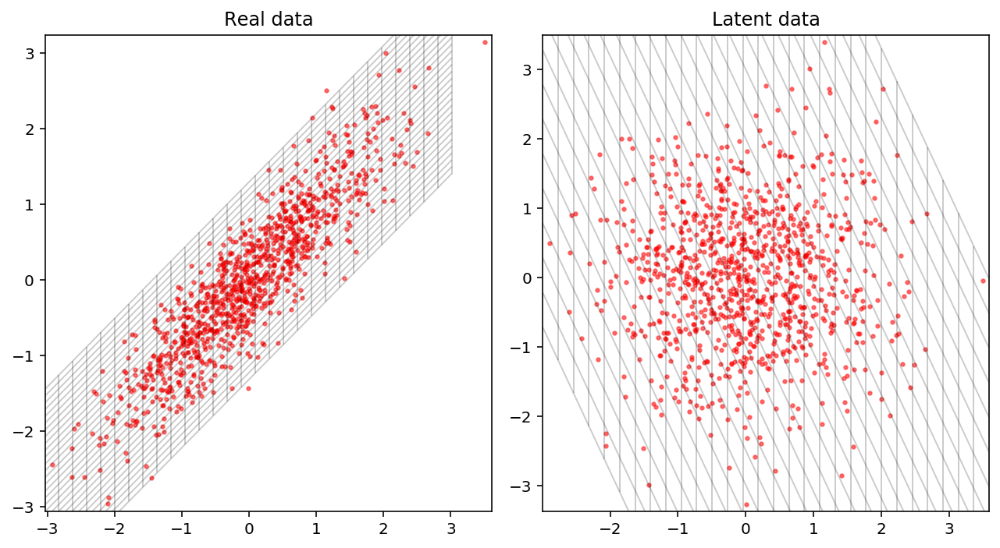

Creating directory for new run logs/test/run263
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


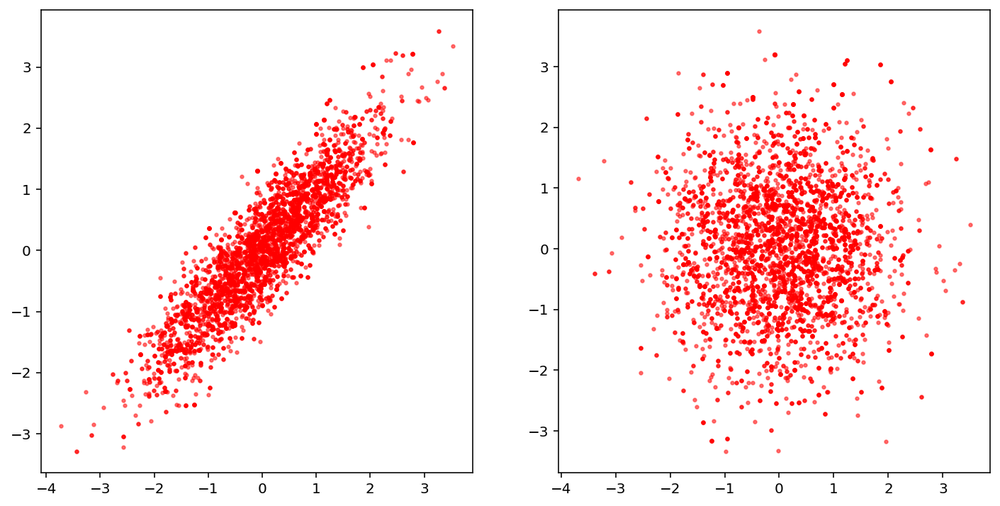

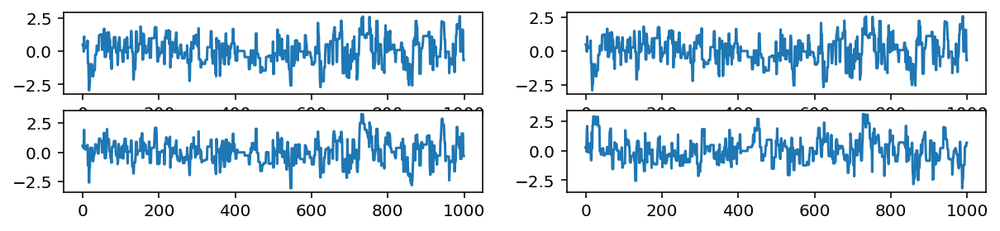

Removed no burn in
686.4182621135815
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.09E+00            7.09             705
param2           7.70E+00            7.70             650


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0790  p_{1}
param2        0.0832  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00413
  2      0.00692

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.1544   0.1461   0.1524 upper
param1       0.0331   0.0555   0.1301 lower
param2       0.0746   0.0467   0.1759 upper
param2       0.1074   0.1231   0.1409 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

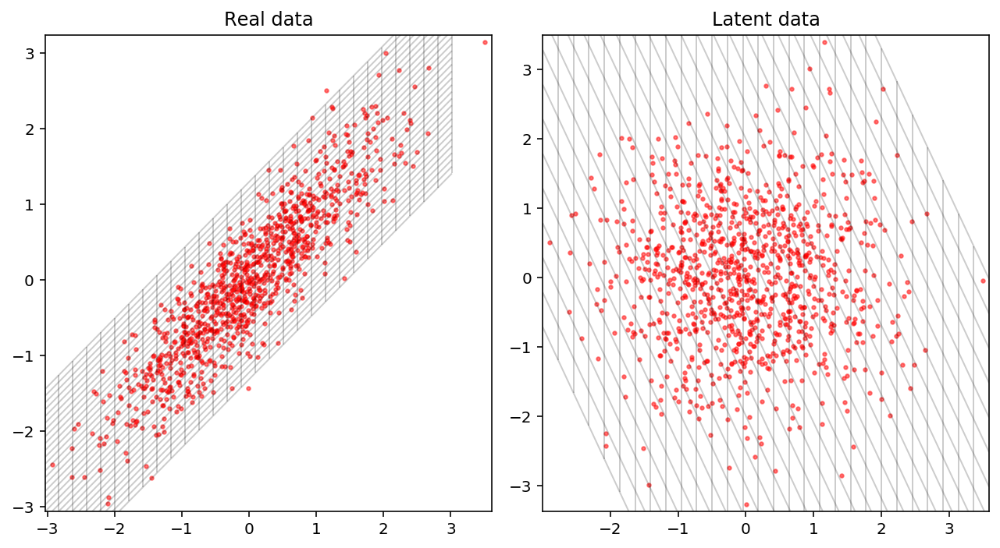

Creating directory for new run logs/test/run264
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


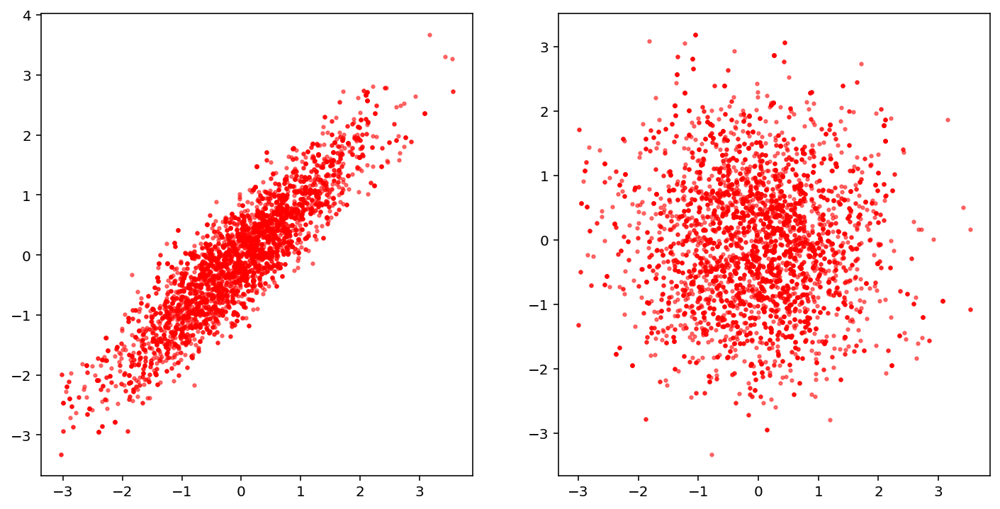

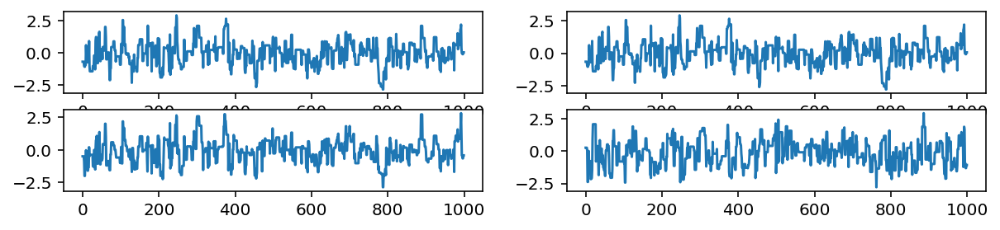

Removed no burn in
729.6290006852073
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.71E+00            6.71             745
param2           6.61E+00            6.61             757


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0627  p_{1}
param2        0.0757  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00334
  2      0.00773

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.1732   0.1627   0.1938 upper
param1       0.1294   0.1648   0.1176 lower
param2       0.2206   0.1993   0.2120 upper
param2       0.1905   0.1831   0.2025 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

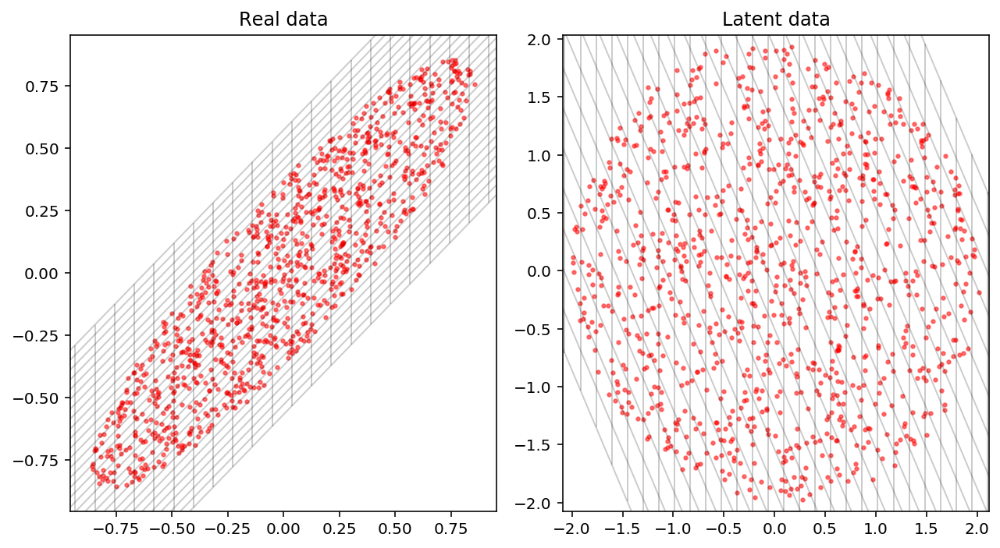

Creating directory for new run logs/test/run266
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


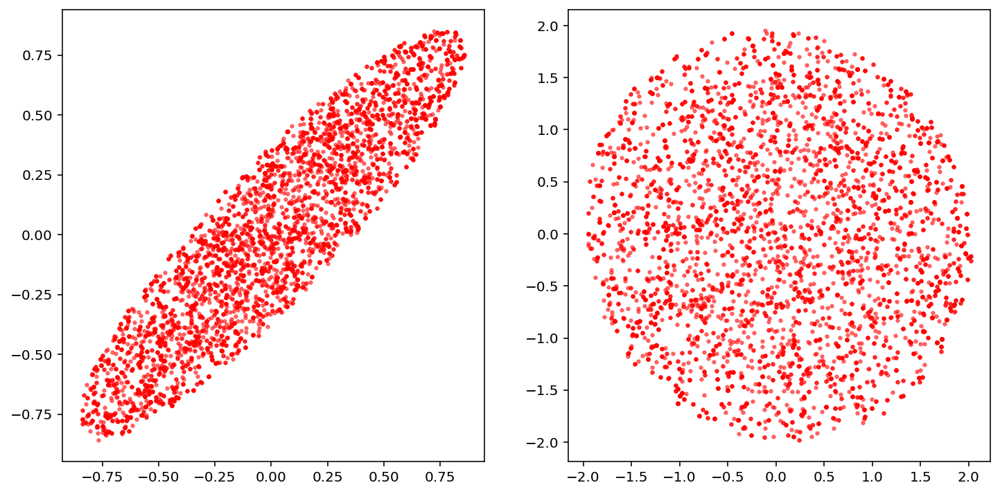

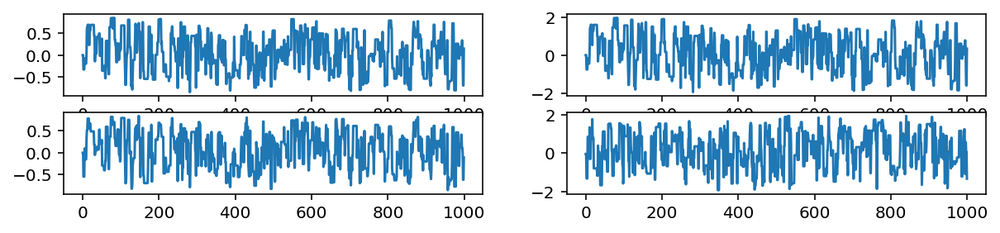

Removed no burn in
775.7772305813824
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.41E+00            6.41             780
param2           6.58E+00            6.58             761


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0649  p_{1}
param2        0.0852  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00158
  2      0.00897

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0508   0.0414   0.0472 upper
param1       0.0136   0.0251   0.0478 lower
param2       0.0220   0.0151   0.0301 upper
param2       0.0228   0.0029   0.0269 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

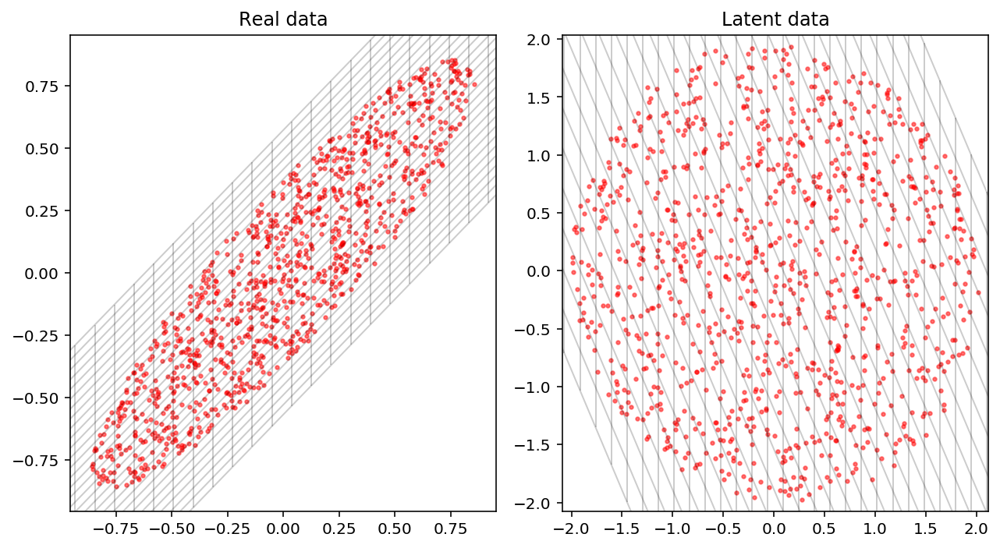

Creating directory for new run logs/test/run268
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


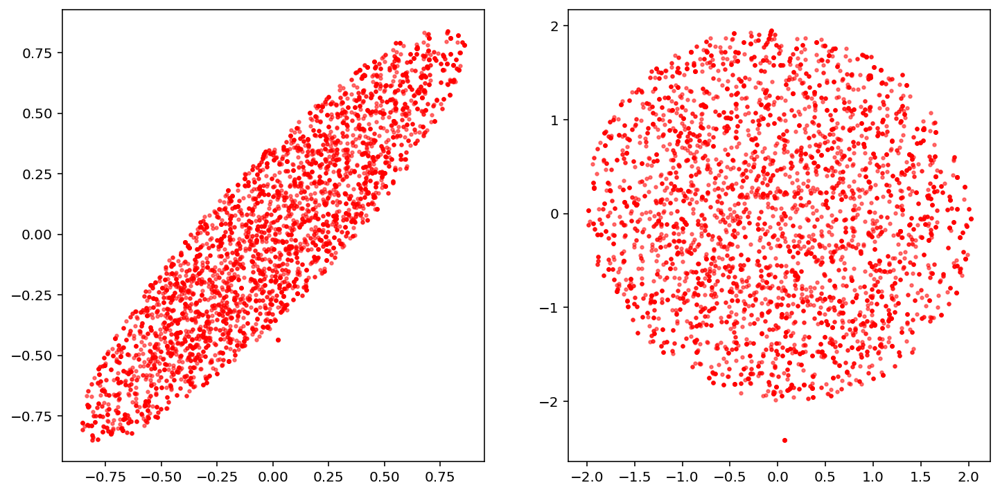

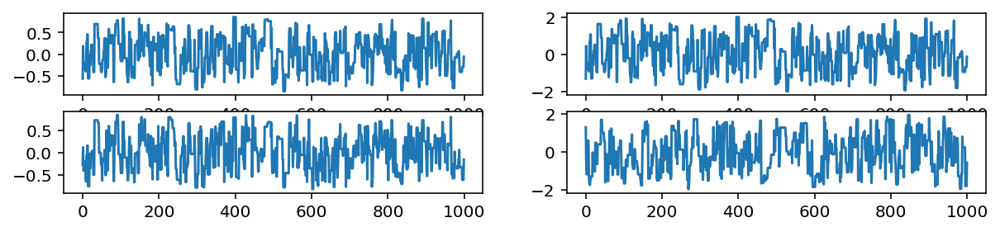

Removed no burn in
909.9831137912195
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           5.38E+00            5.38             930
param2           5.44E+00            5.44             920


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0995  p_{1}
param2        0.0891  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00039
  2      0.00990

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0967   0.0568   0.0907 upper
param1       0.0190   0.0178   0.0478 lower
param2       0.0155   0.0233   0.0382 upper
param2       0.0475   0.0293   0.0565 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [9]:
model = Trainer(like.x_dim, flow='choleksy', learning_rate=0.001)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedNVP(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=2, bias=True)
        )
        (translate_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): ReLU()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): ReLU()
          (4): Linear(in_features=64, out_features=2, bias=True)
        )
      )
      (1): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=2, bias=True)
      

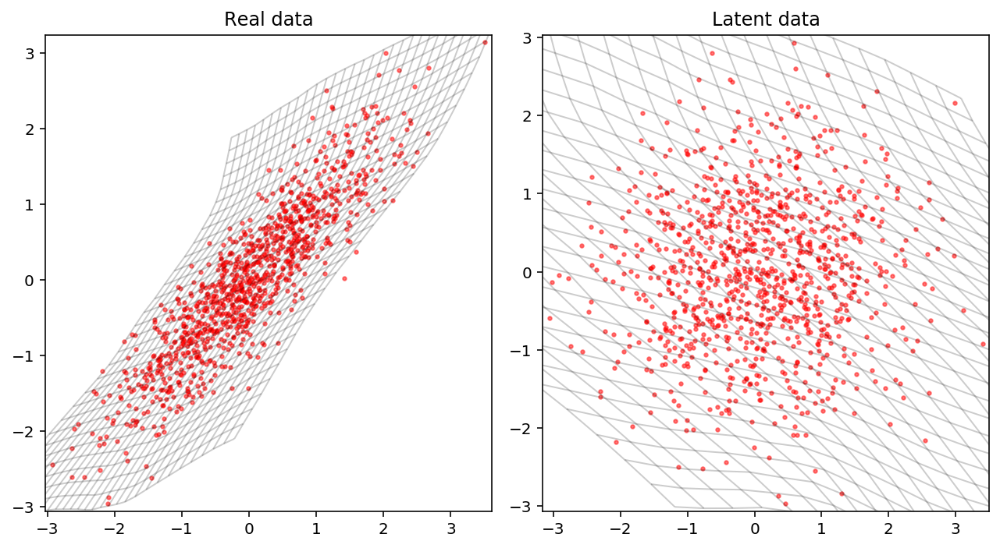

Creating directory for new run logs/test/run269
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


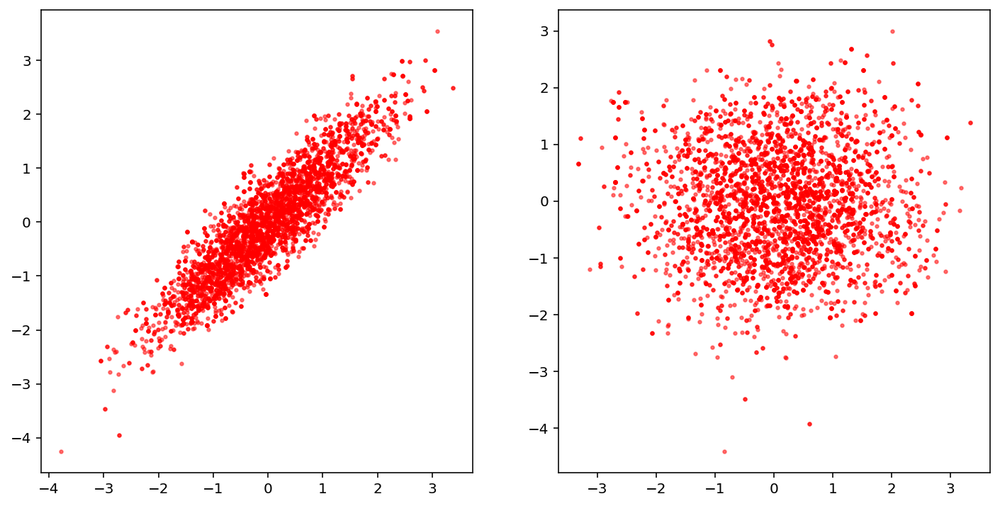

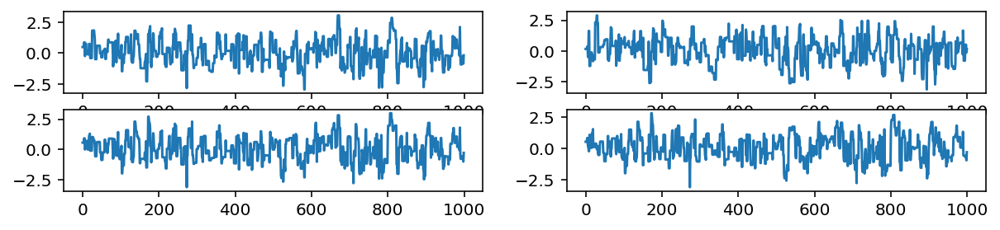

Removed no burn in
770.7094065531332
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.48E+00            6.48             772
param2           5.98E+00            5.98             837


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0592  p_{1}
param2        0.0668  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00349
  2      0.00952

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0159   0.0523   0.0933 upper
param1       0.0234   0.0951   0.0691 lower
param2       0.0315   0.0580   0.0809 upper
param2       0.0343   0.0338   0.0366 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

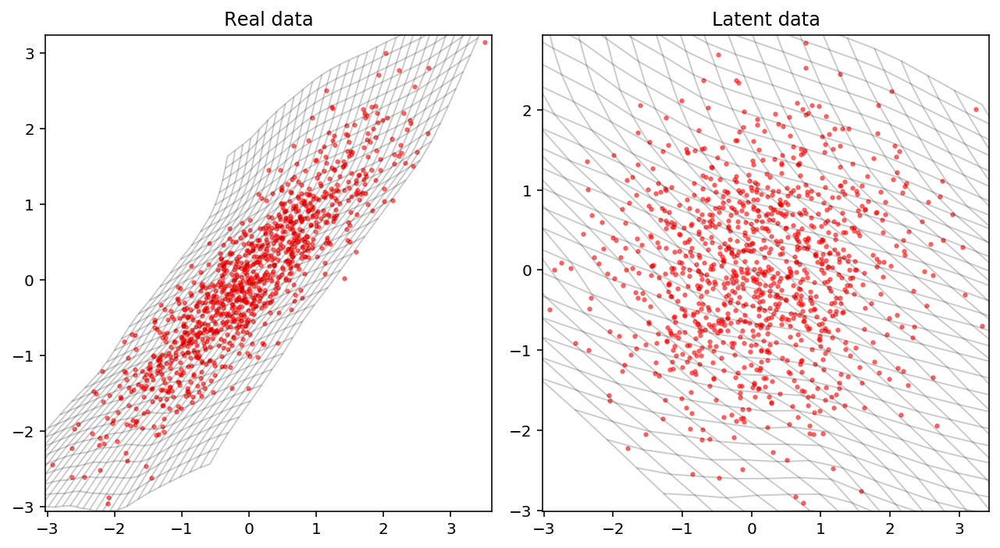

Creating directory for new run logs/test/run270
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


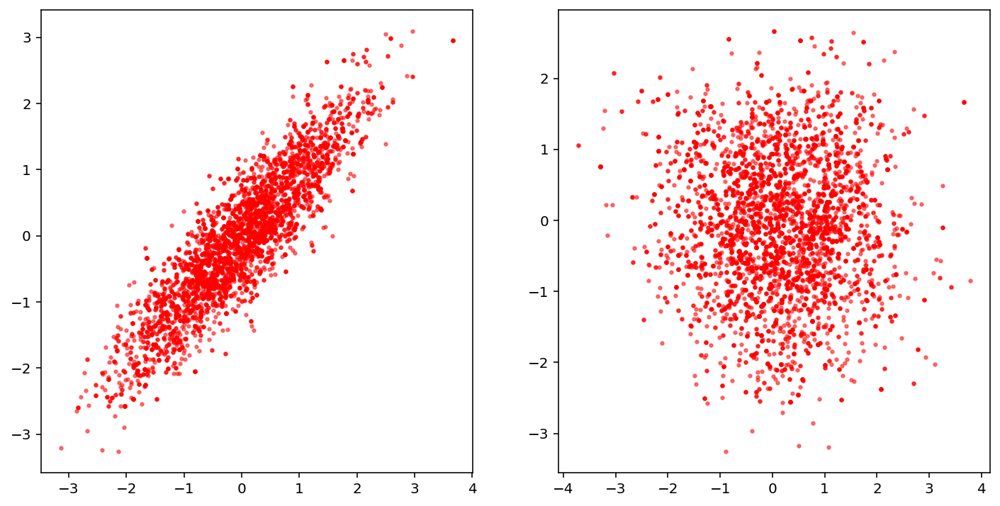

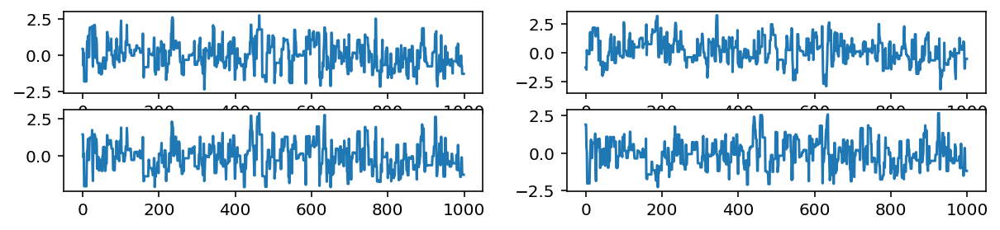

Removed no burn in
770.6392999418971
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.50E+00            6.50             769
param2           6.48E+00            6.48             772


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0513  p_{1}
param2        0.0673  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00207
  2      0.00668

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0908   0.1497   0.0899 upper
param1       0.0110   0.0863   0.0687 lower
param2       0.0838   0.0855   0.0902 upper
param2       0.0248   0.0427   0.0955 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

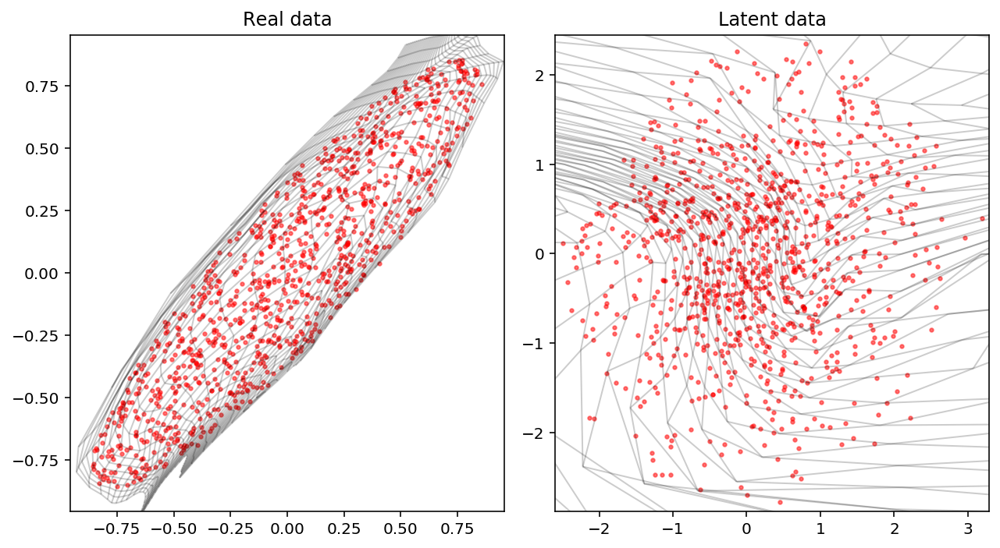

Creating directory for new run logs/test/run272
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


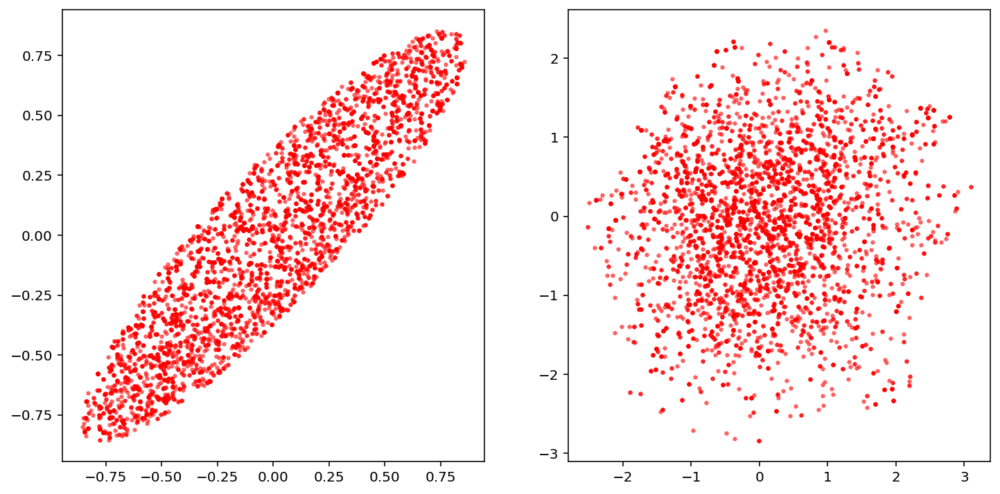

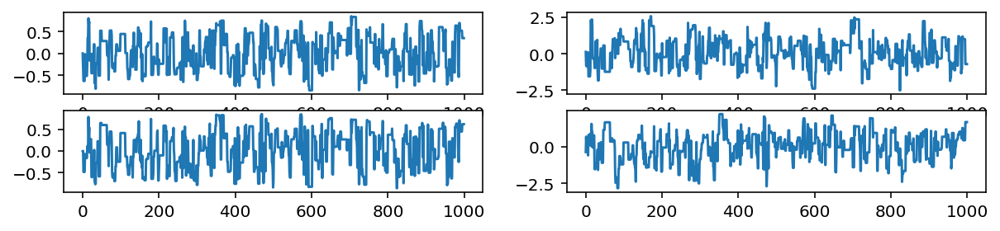

Removed no burn in
710.0901112066564
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.87E+00            6.87             728
param2           6.93E+00            6.93             721


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1104  p_{1}
param2        0.1108  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00543
  2      0.01258

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0180   0.0468   0.0672 upper
param1       0.0405   0.0582   0.0528 lower
param2       0.0129   0.0364   0.0149 upper
param2       0.0006   0.0083   0.0150 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

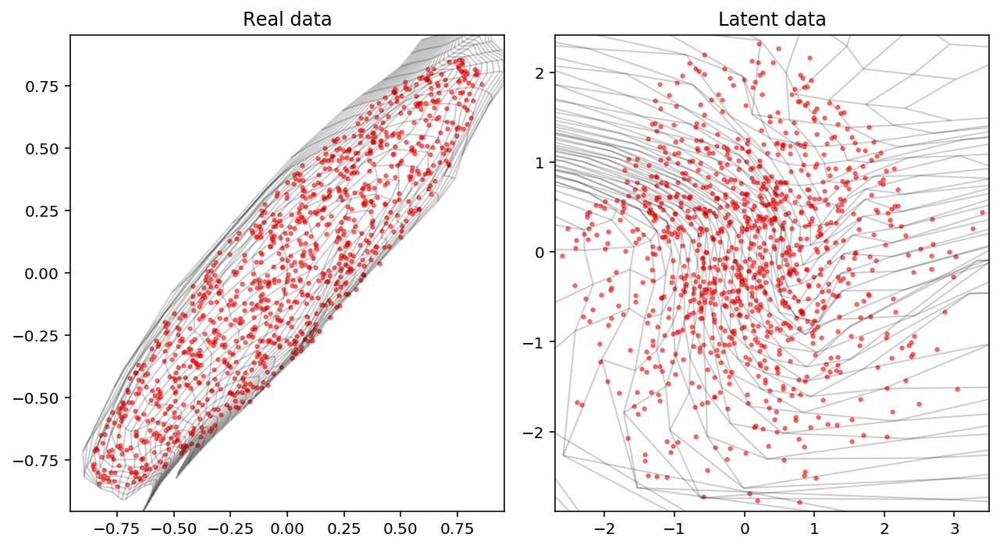

Creating directory for new run logs/test/run273
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


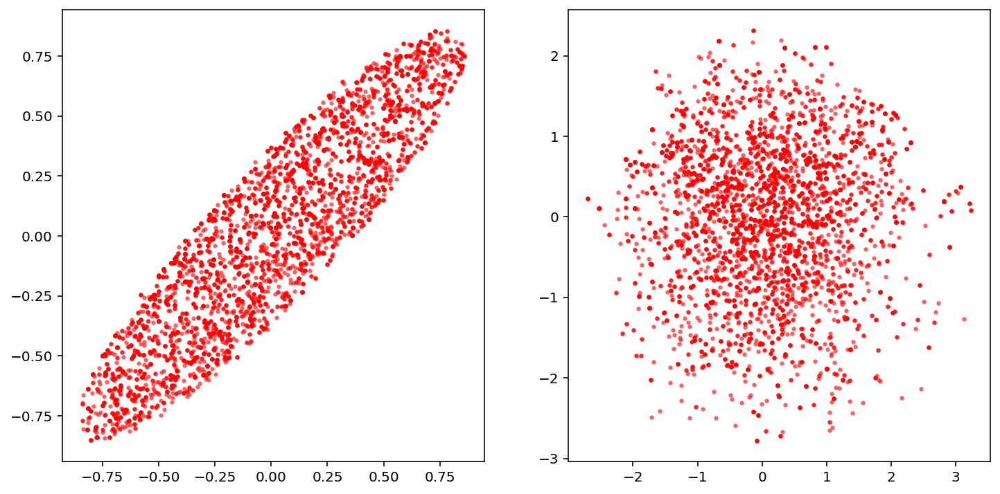

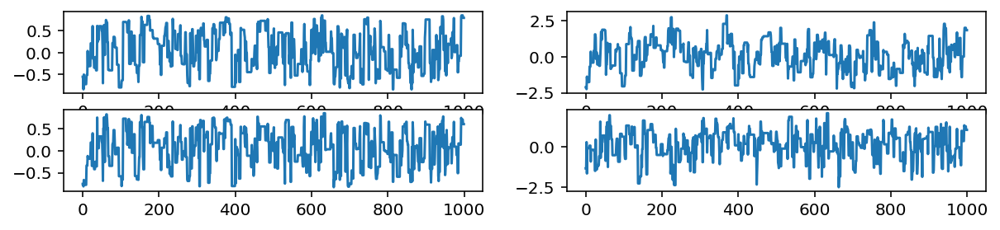

Removed no burn in
752.9985240231098
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.53E+00            6.53             766
param2           6.09E+00            6.09             821


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1003  p_{1}
param2        0.0980  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00266
  2      0.01025

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0232   0.0468   0.0560 upper
param1       0.0553   0.0615   0.0673 lower
param2       0.0023   0.0031   0.0477 upper
param2       0.0659   0.0763   0.0539 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [10]:
model = Trainer(like.x_dim, hidden_dim=64, num_blocks=5, flow='nvp', learning_rate=0.001)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedSpline(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): ActNorm()
      (1): Invertible1x1Conv()
      (2): NSF_CL(
        (f1): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
            (5): LeakyReLU(negative_slope=0.2)
            (6): Linear(in_features=16, out_features=23, bias=True)
          )
        )
        (f2): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
        

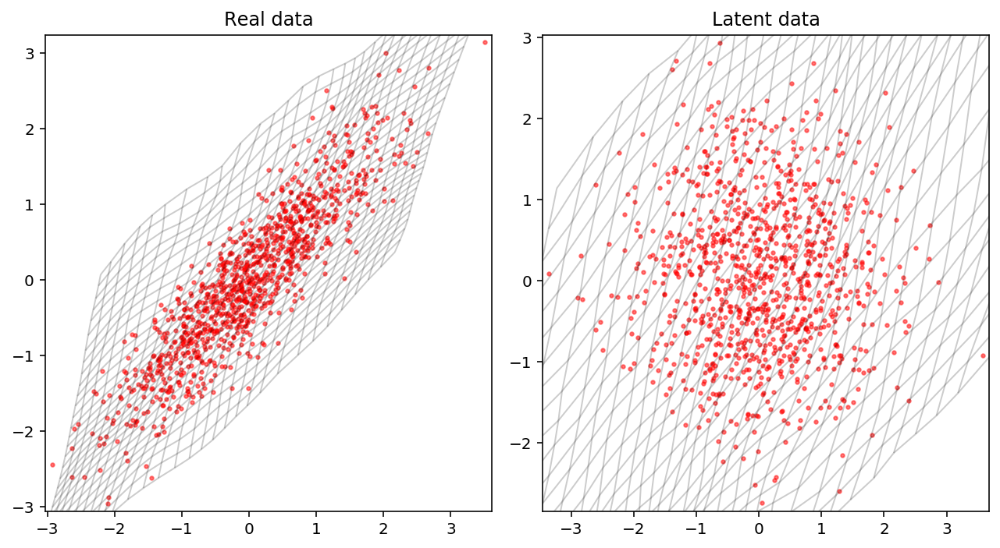

Creating directory for new run logs/test/run274
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


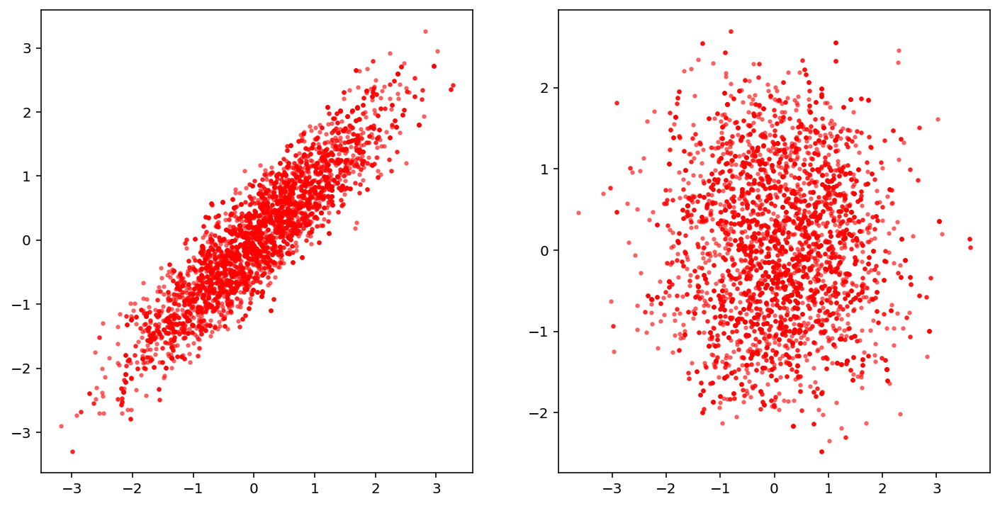

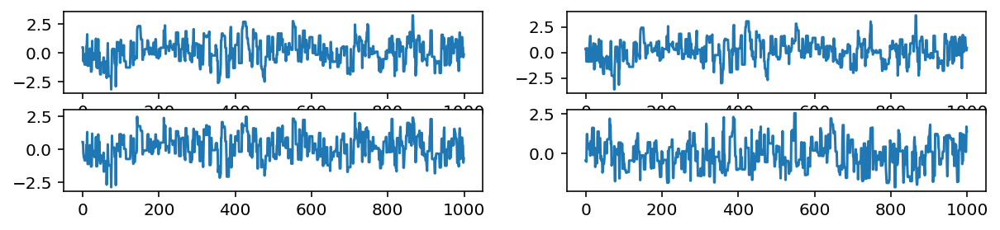

Removed no burn in
695.5517651207178
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.06E+00            7.06             708
param2           6.54E+00            6.54             765


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0547  p_{1}
param2        0.0841  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00004
  2      0.00965

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0578   0.1571   0.1267 upper
param1       0.0104   0.1280   0.1294 lower
param2       0.0227   0.1490   0.0718 upper
param2       0.1775   0.1485   0.1330 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

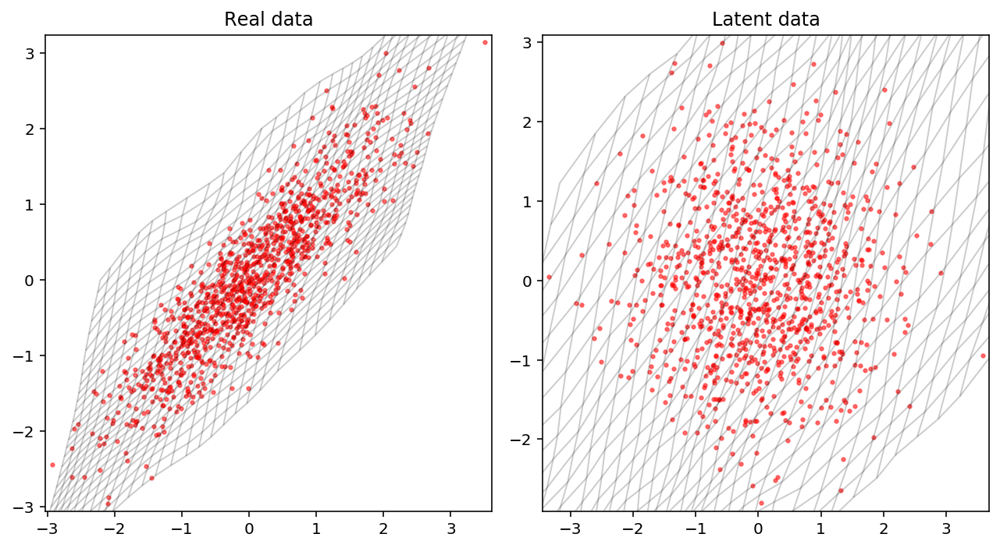

Creating directory for new run logs/test/run276
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


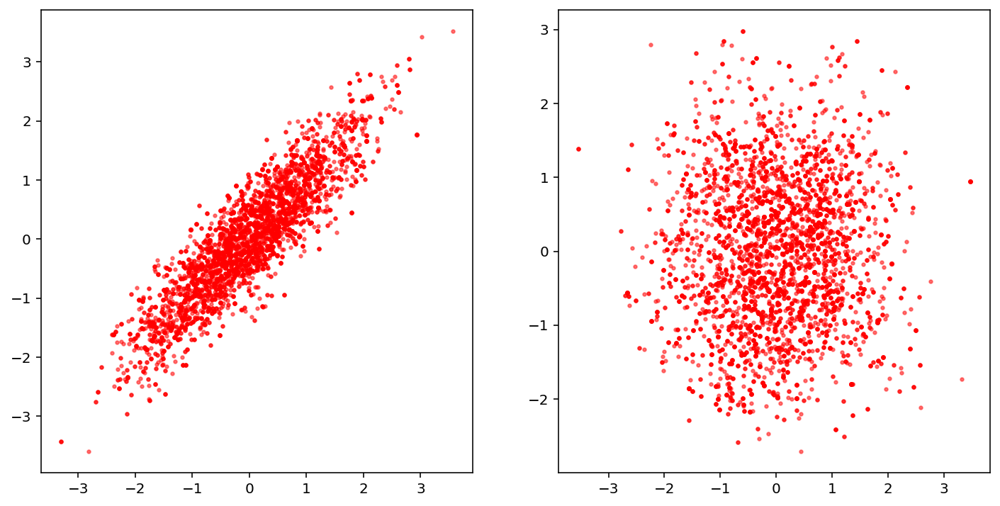

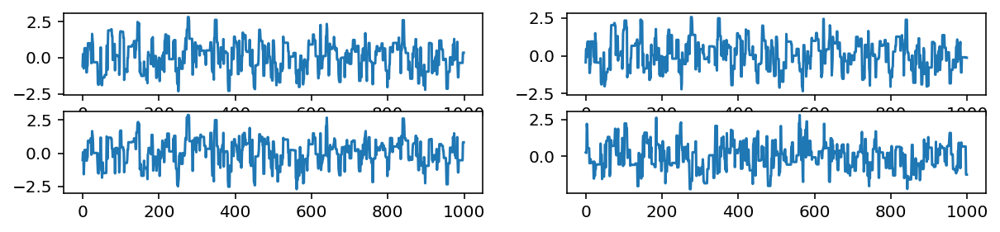

Removed no burn in
688.7653980347719
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.01E+00            7.01             713
param2           7.15E+00            7.15             699


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0985  p_{1}
param2        0.0856  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00461
  2      0.01037

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0329   0.0681   0.0612 upper
param1       0.0277   0.0366   0.0904 lower
param2       0.0349   0.1355   0.0624 upper
param2       0.0170   0.1030   0.1632 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

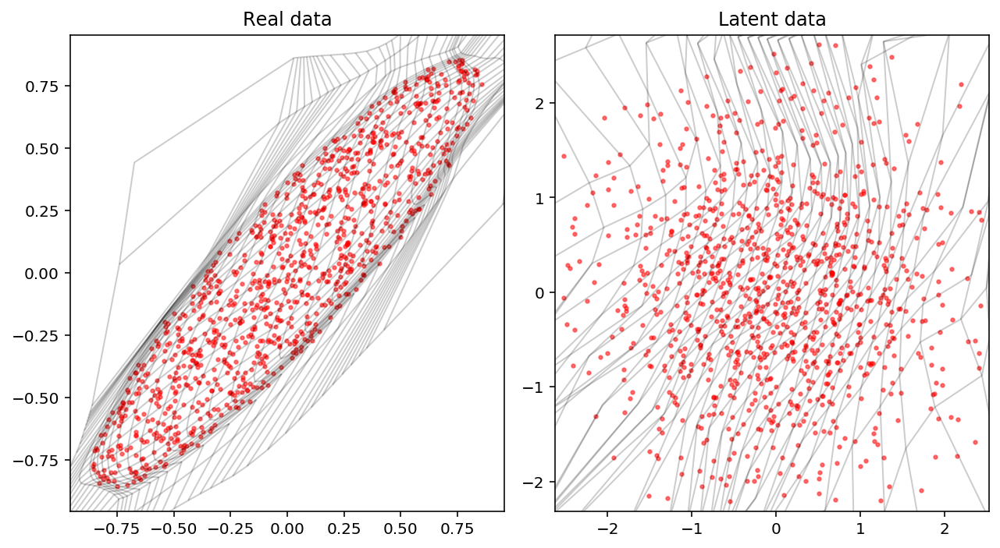

Creating directory for new run logs/test/run278
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


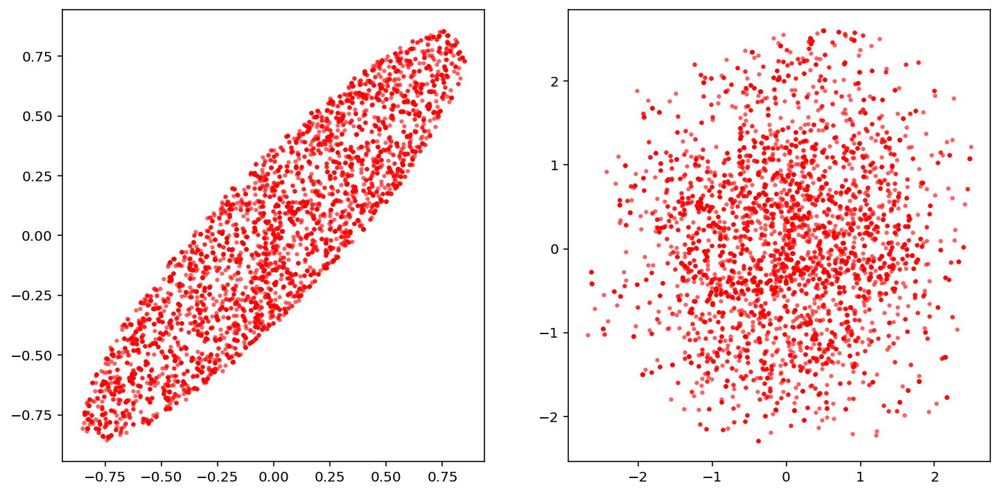

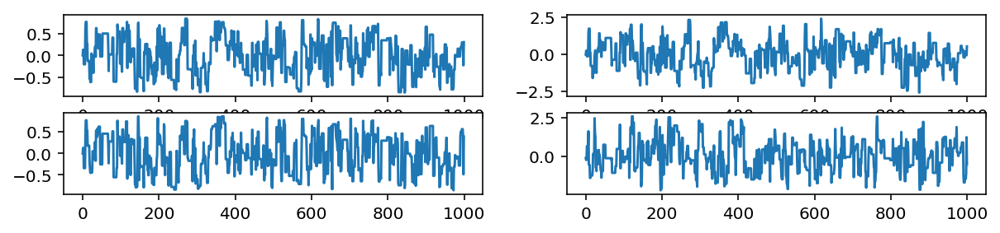

Removed no burn in
668.3836614679462
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.36E+00            7.36             680
param2           6.57E+00            6.57             761


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0734  p_{1}
param2        0.0556  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00091
  2      0.00625

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0272   0.0555   0.0647 upper
param1       0.0104   0.0447   0.0481 lower
param2       0.0208   0.0398   0.0474 upper
param2       0.0249   0.0469   0.0297 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

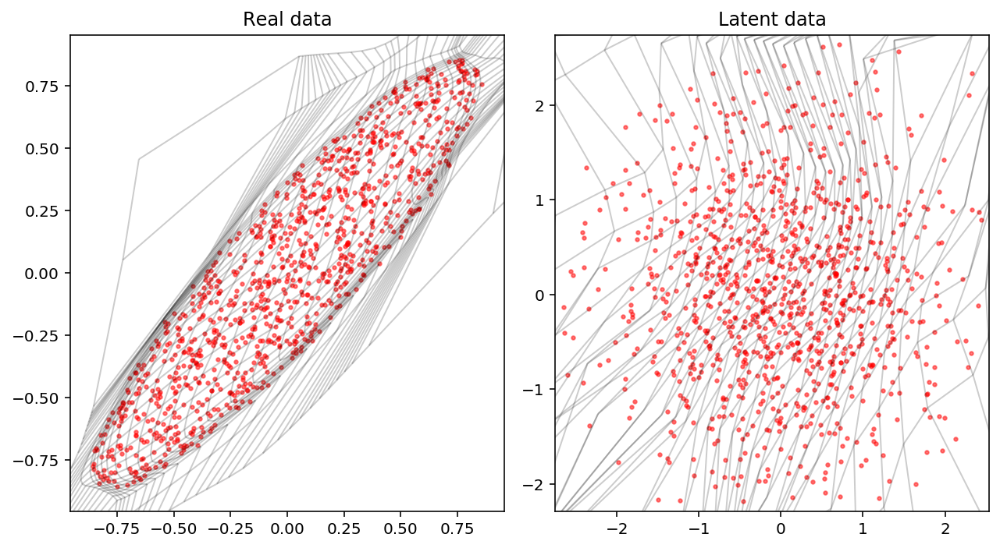

Creating directory for new run logs/test/run279
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


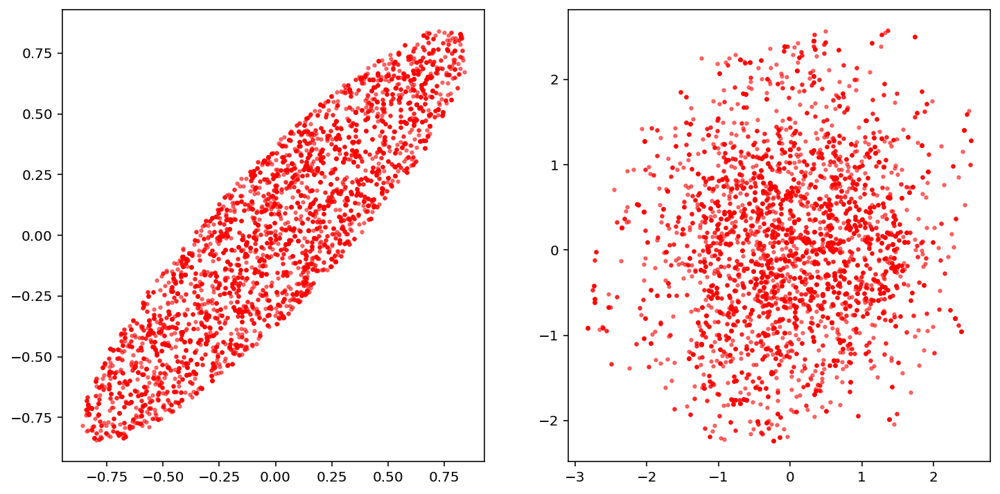

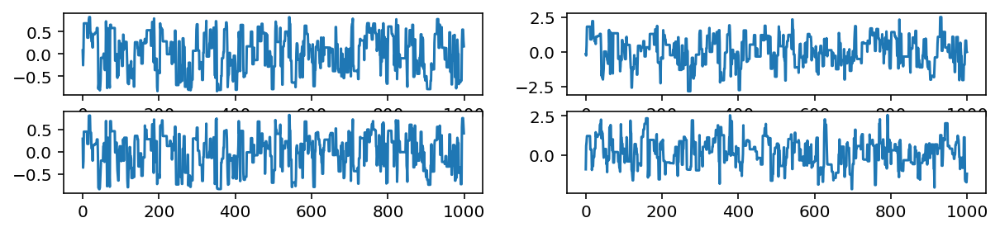

Removed no burn in
710.7748606468098
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.82E+00            6.82             734
param2           6.47E+00            6.47             774


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0843  p_{1}
param2        0.0509  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00251
  2      0.02054

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0175   0.0277   0.0208 upper
param1       0.0386   0.0516   0.0544 lower
param2       0.0331   0.0297   0.0358 upper
param2       0.0465   0.0508   0.0498 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [11]:
model = Trainer(like.x_dim, flow='spline', learning_rate=0.001)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

In [12]:
like = Himmelblau(2)
prior = UniformPrior(2, -5, 5)

[nnest.trainer] [INFO] SingleSpeedCholeksy(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): Choleksy()
    )
  )
)
[nnest.trainer] [INFO] Number of network params: [5]
[nnest.trainer] [INFO] Device [cpu]
[nnest.trainer] [INFO] Number of training samples [1000]
[nnest.trainer] [INFO] Training jitter [0.0010]
[nnest.trainer] [INFO] Epoch [1] train loss [0.1020] validation loss [0.1044]
[nnest.trainer] [INFO] Epoch [100] train loss [0.0589] validation loss [0.0614]
[nnest.trainer] [INFO] Epoch [200] train loss [0.0507] validation loss [0.0522]
[nnest.trainer] [INFO] Epoch [300] train loss [0.0491] validation loss [0.0502]
[nnest.trainer] [INFO] Epoch [400] train loss [0.0489] validation loss [0.0498]
[nnest.trainer] [INFO] Epoch [500] train loss [0.0489] validation loss [0.0497]
[nnest.trainer] [INFO] Epoch [600] train loss [0.0489] validation loss [0.0497]
[nnest.trainer] [INFO] Epoch [673] ran out of patience
[nnest.trainer] [INFO] Best epoch [623] validation loss [0.0497

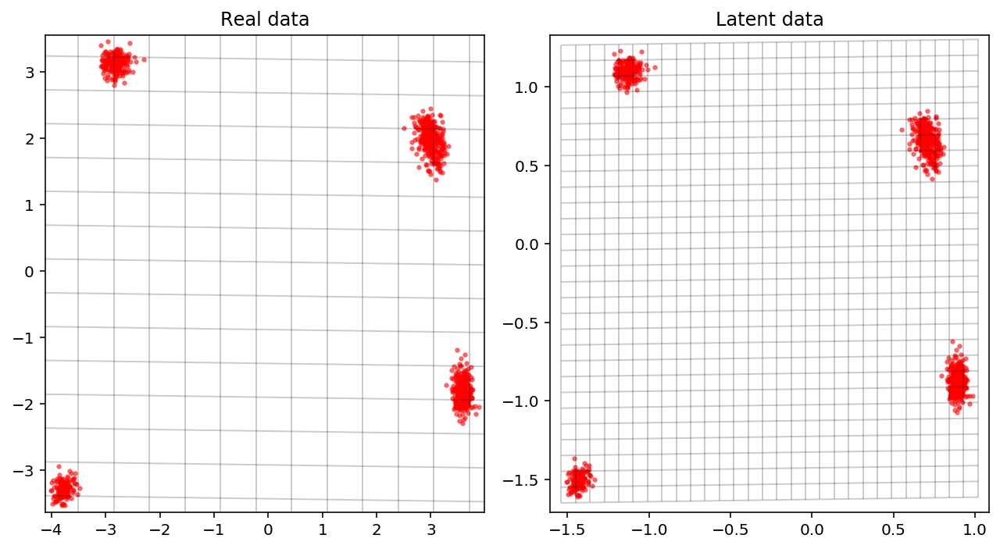

Creating directory for new run logs/test/run280
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


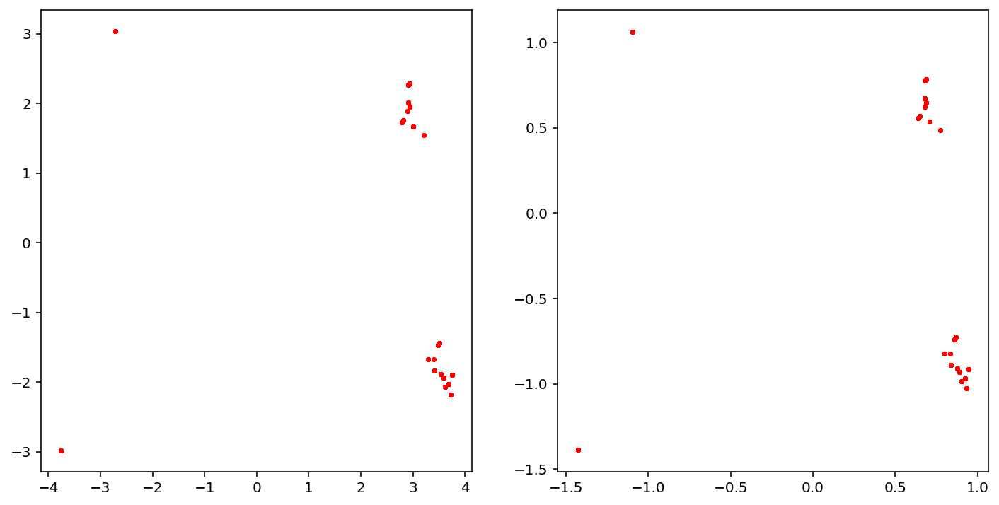

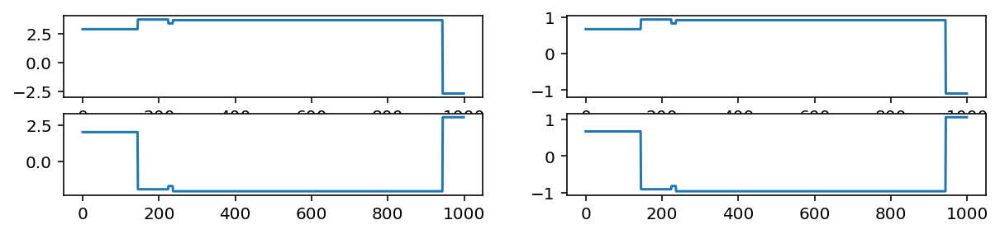

Removed no burn in
13.50816484353421
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.41E-01            0.64            7810
param2           6.03E-01            0.60            8303


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.8371  p_{1}
param2        0.9077  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.56090
  2      1.15319

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0475   0.0388   0.1075 upper
param1       2.2329   1.8670   2.2742 lower
param2       0.1124   0.2280   0.2129 upper
param2       0.3553   0.2901   0.4628 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

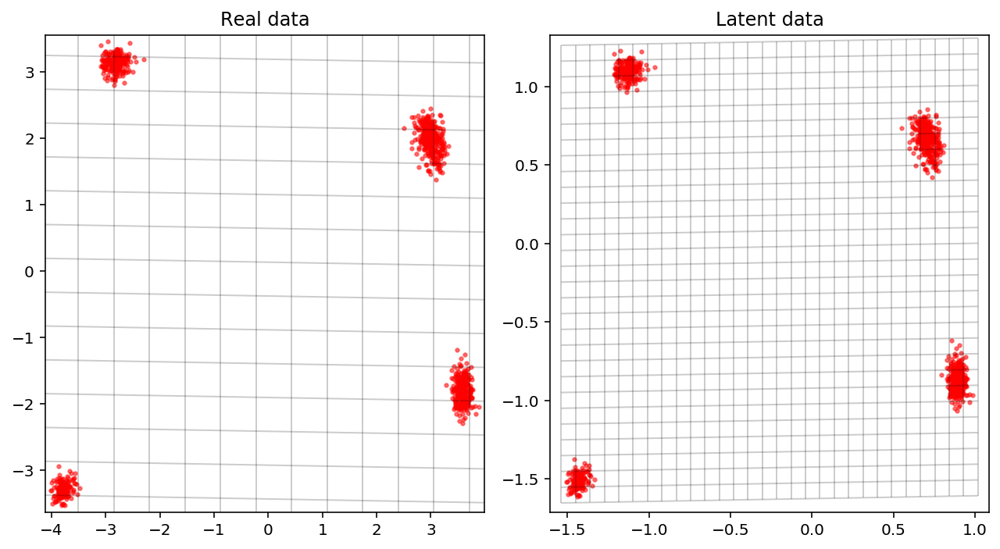

Creating directory for new run logs/test/run281
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


/Users/adammoss/work/code/MCMC/nnest/nnest/sampler.py:351: RuntimeWarning: invalid value encountered in subtract
  log_ratio_3 = torch.tensor(logl_prior_prime - logl_prior)


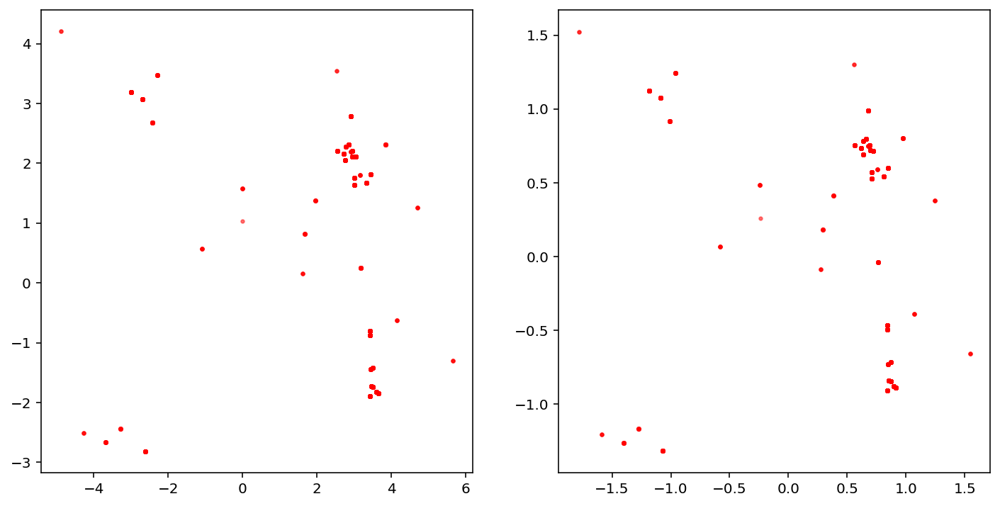

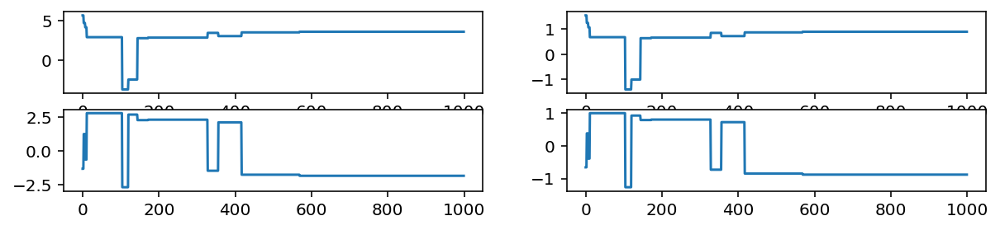

Removed no burn in
21.21819549370773
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           9.47E-01            0.95            5282
param2           6.78E-01            0.68            7384


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.2633  p_{1}
param2        0.7709  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.04614
  2      1.12724

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0231   0.0188   0.0604 upper
param1       1.1800   1.5105   1.6062 lower
param2       0.1434   0.3086   0.3642 upper
param2       0.0176   0.1707   0.9344 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

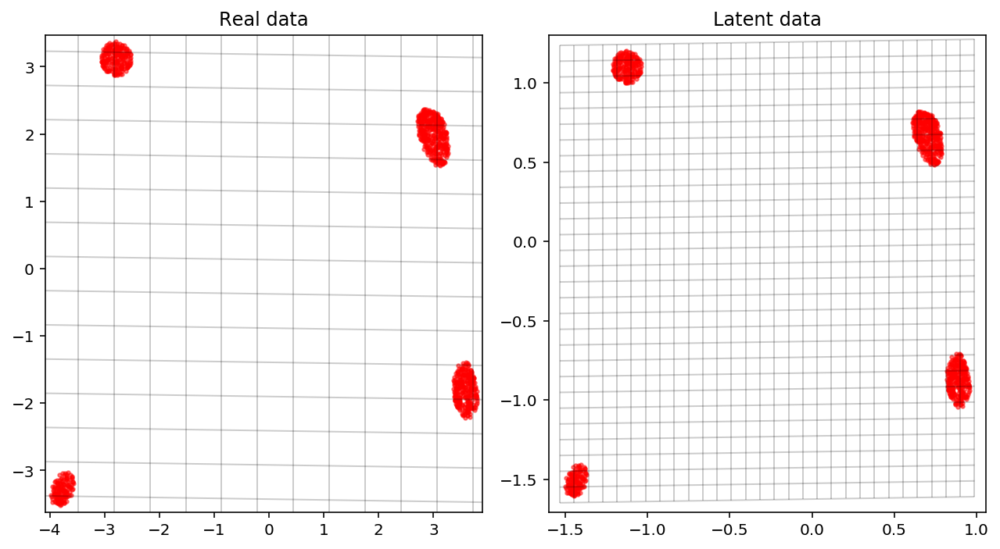

Creating directory for new run logs/test/run282
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


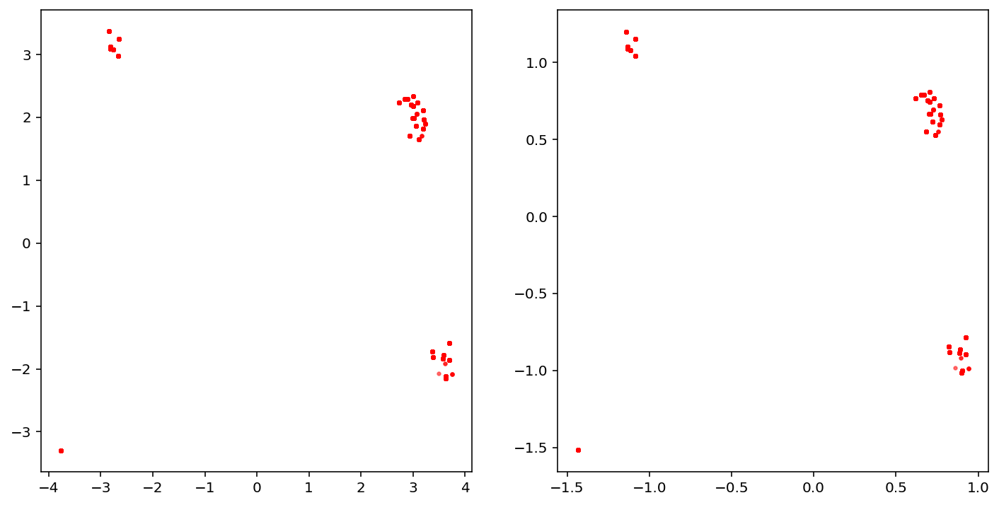

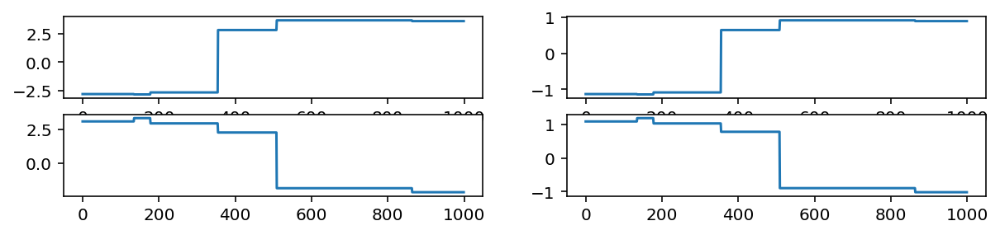

Removed no burn in
14.95244882950479
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.15E-01            0.71            7002
param2           4.83E-01            0.48           10359


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.7063  p_{1}
param2        1.1564  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.30377
  2      1.35400

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0029   0.0243   0.0639 upper
param1       0.0026   0.2018   0.1751 lower
param2       0.0429   0.0578   0.0653 upper
param2       0.1132   0.3315   0.3163 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

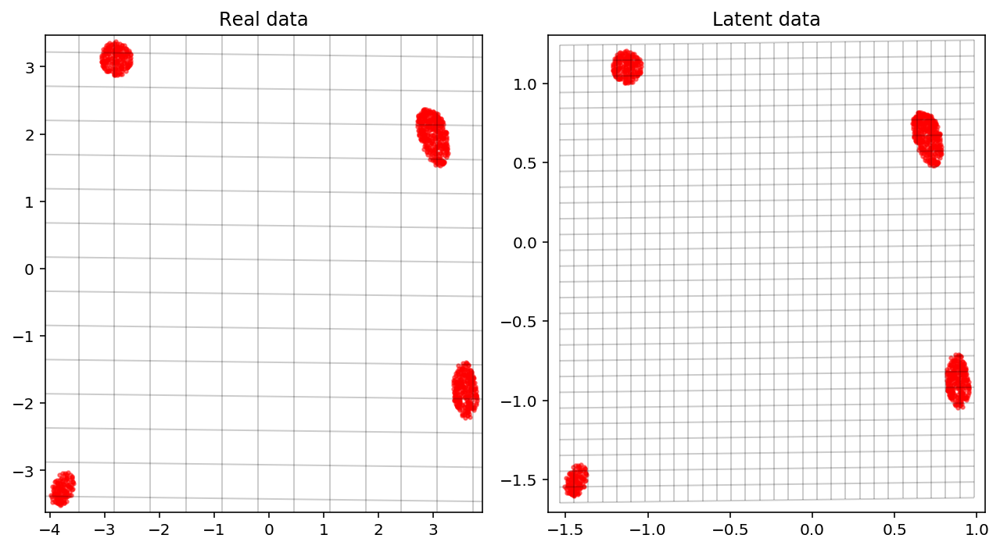

Creating directory for new run logs/test/run283
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


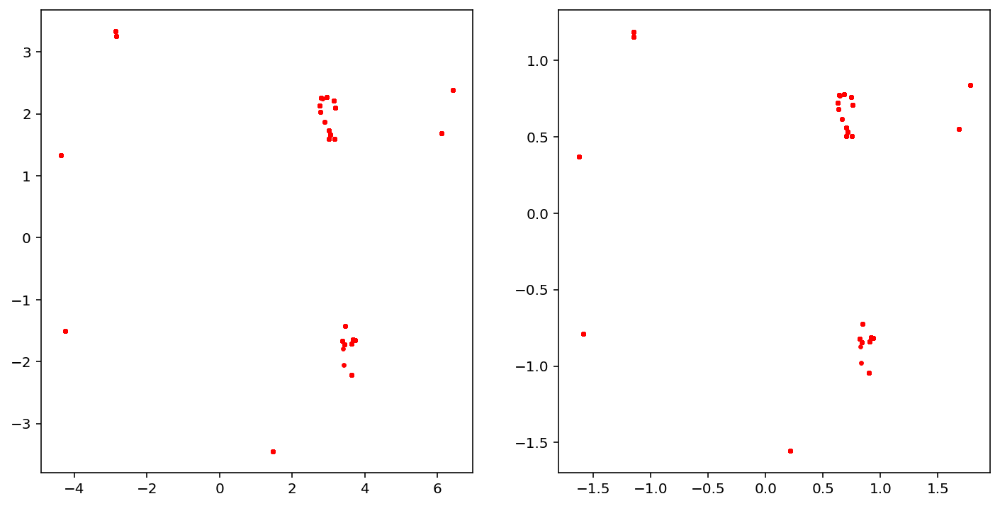

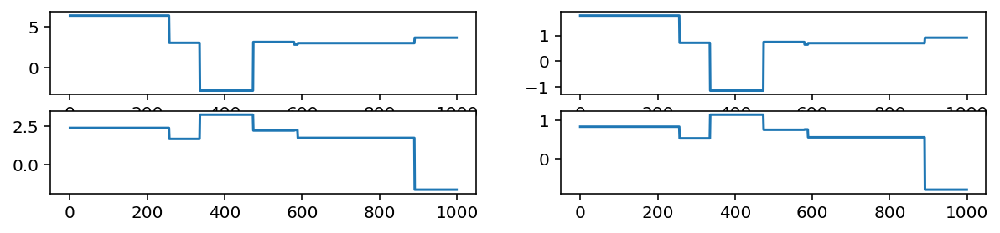

Removed no burn in
12.446457388174936
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           5.15E-01            0.51            9720
param2           4.43E-01            0.44           11293


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        1.0852  p_{1}
param2        1.2532  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      1.12842
  2      1.61225

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.5360   0.6545   0.7064 upper
param1       0.3038   0.2480   0.8534 lower
param2       0.0272   0.2799   0.4689 upper
param2       0.5935   0.6067   0.6757 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

In [13]:
model = Trainer(like.x_dim, flow='choleksy', learning_rate=0.001)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedNVP(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=2, bias=True)
        )
        (translate_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): ReLU()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): ReLU()
          (4): Linear(in_features=64, out_features=2, bias=True)
        )
      )
      (1): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=2, bias=True)
      

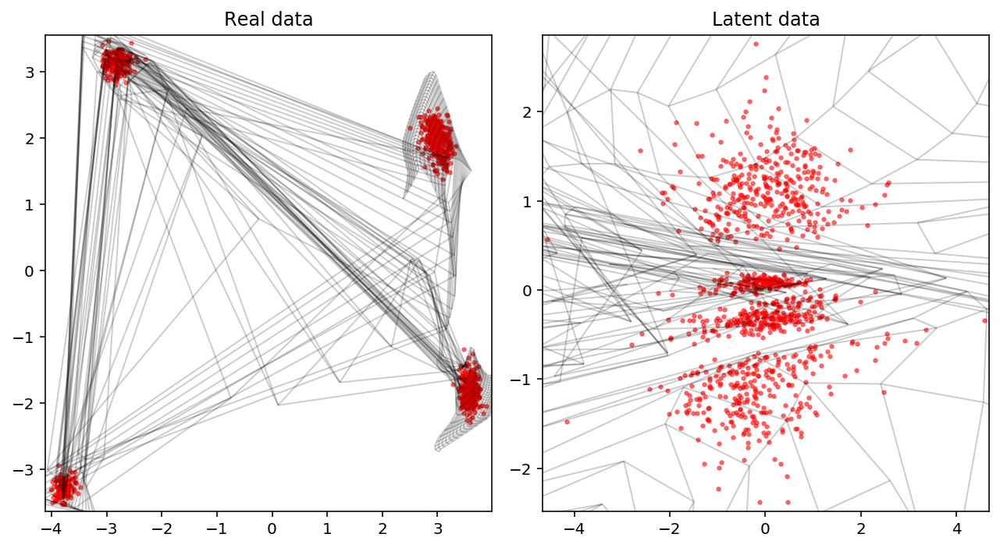

Creating directory for new run logs/test/run284
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


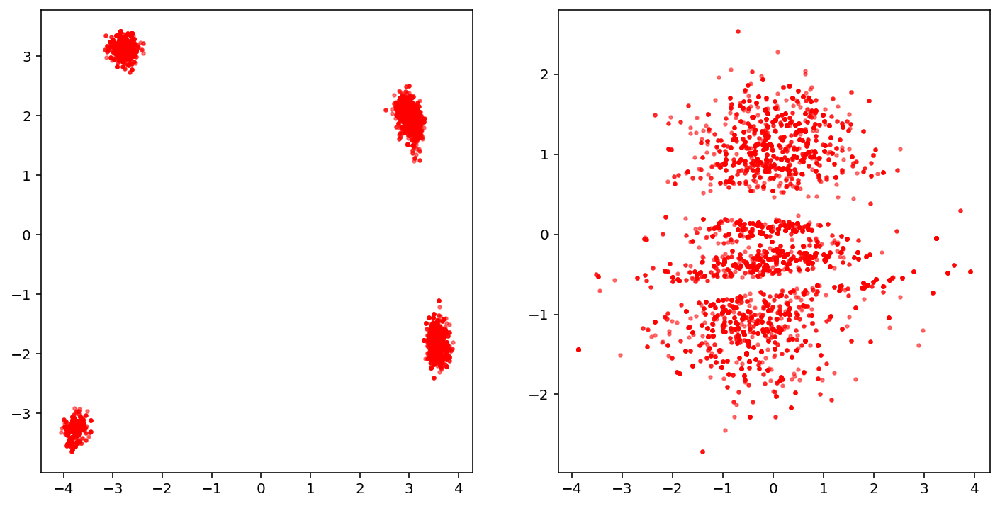

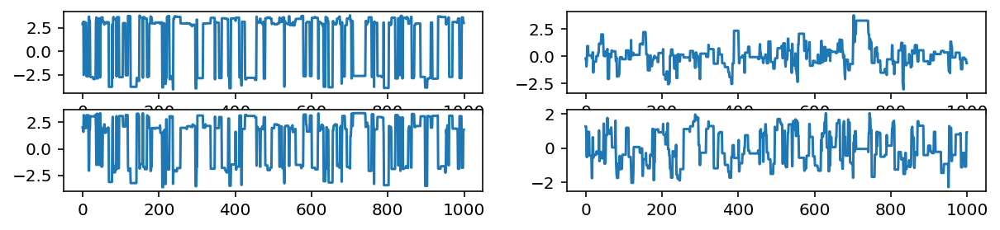

Removed no burn in
394.4794078952801
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.20E+01           12.01             416
param2           1.08E+01           10.82             462


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1160  p_{1}
param2        0.1049  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00638
  2      0.01925

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0012   0.0046   0.0078 upper
param1       0.0115   0.0088   0.0093 lower
param2       0.0113   0.0113   0.0203 upper
param2       0.0036   0.0131   0.0149 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

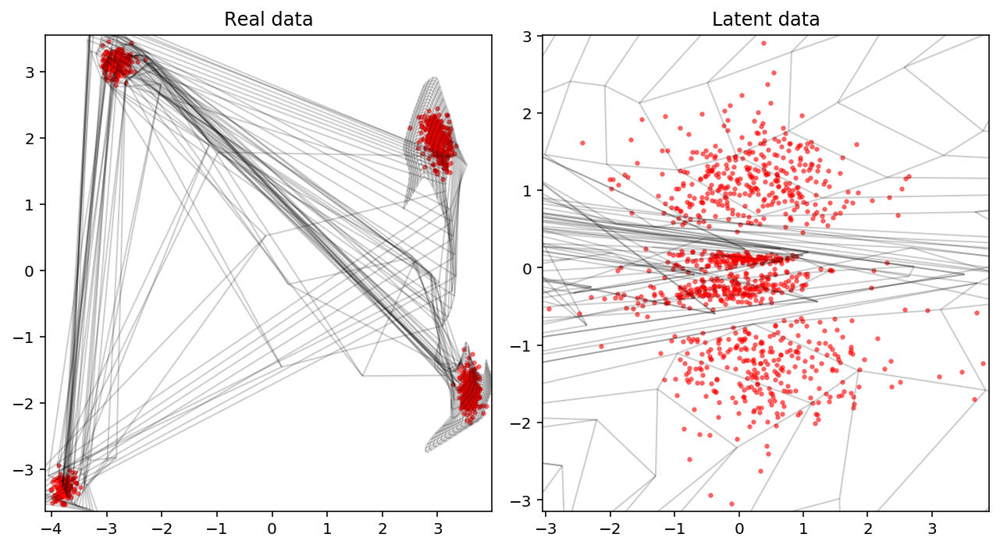

Creating directory for new run logs/test/run285
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


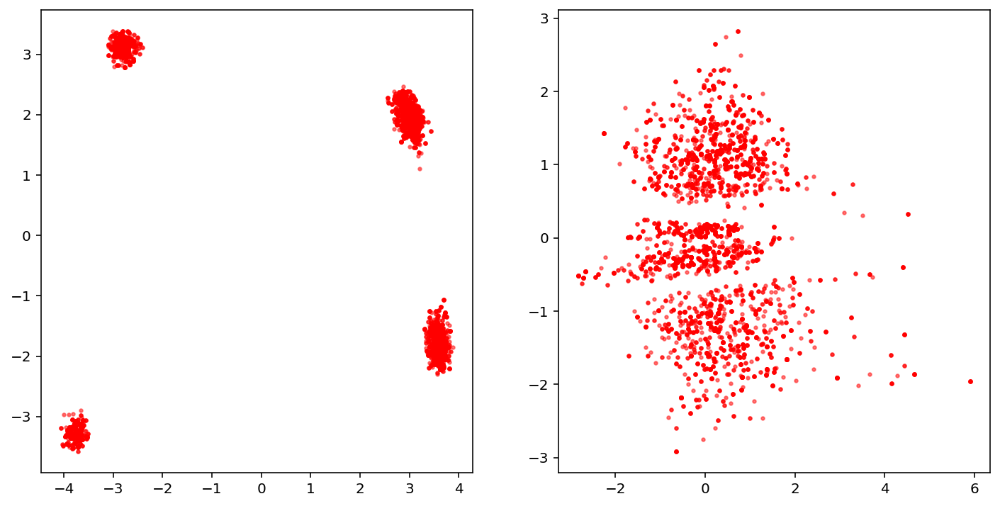

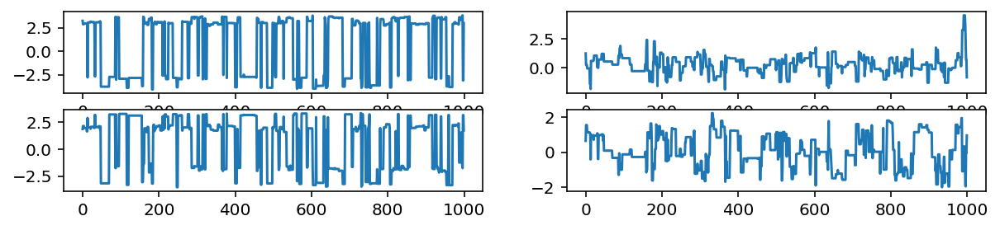

Removed no burn in
284.7924182895003
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.69E+01           16.92             295
param2           1.57E+01           15.73             318


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1292  p_{1}
param2        0.1352  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00920
  2      0.02529

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0059   0.0077   0.0070 upper
param1       0.0061   0.0037   0.0102 lower
param2       0.0045   0.0103   0.0198 upper
param2       0.0002   0.0098   0.0216 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

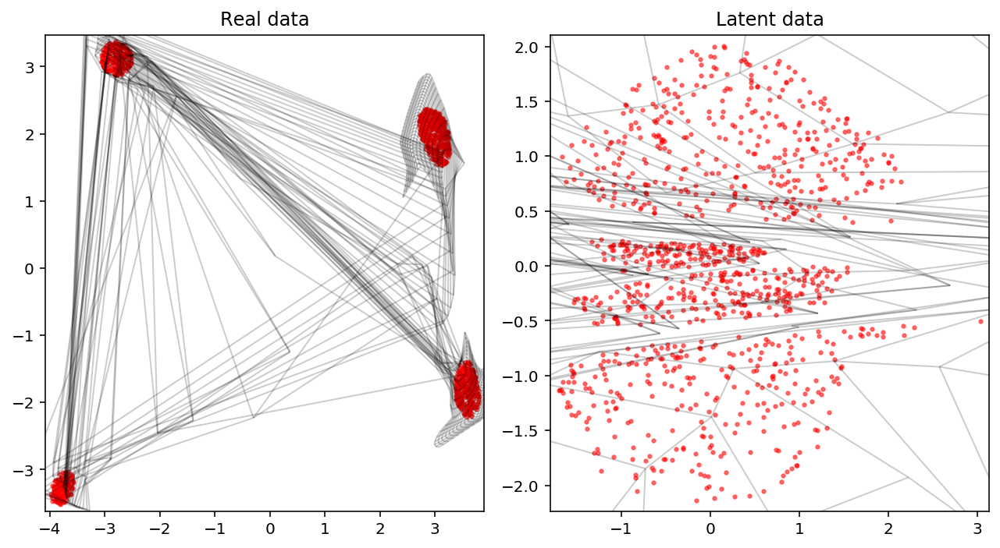

Creating directory for new run logs/test/run286
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


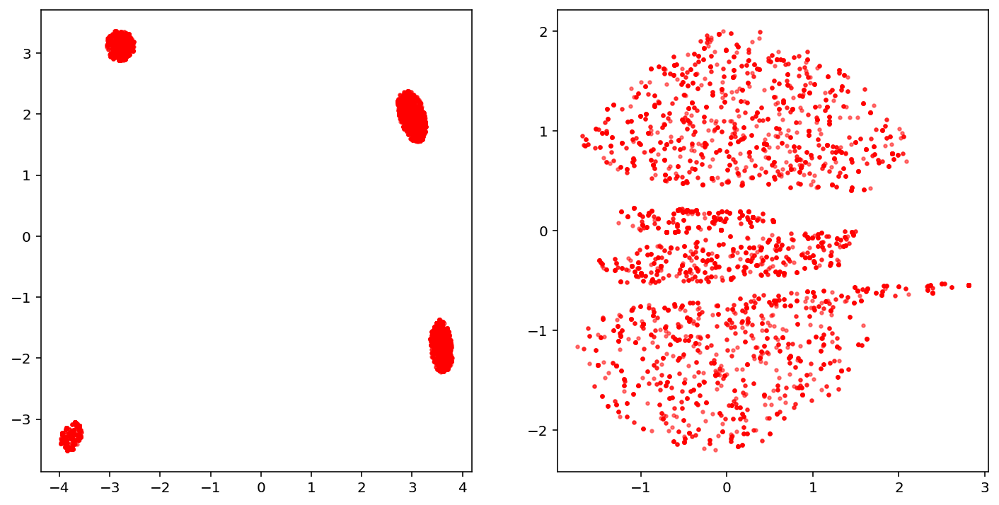

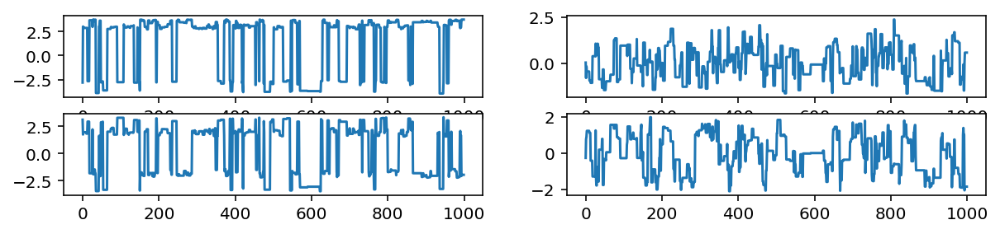

Removed no burn in
363.6720080157014
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.31E+01           13.10             382
param2           1.21E+01           12.10             413


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1012  p_{1}
param2        0.1612  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00781
  2      0.02813

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0008   0.0032   0.0034 upper
param1       0.0051   0.0033   0.0112 lower
param2       0.0031   0.0056   0.0056 upper
param2       0.0003   0.0043   0.0079 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

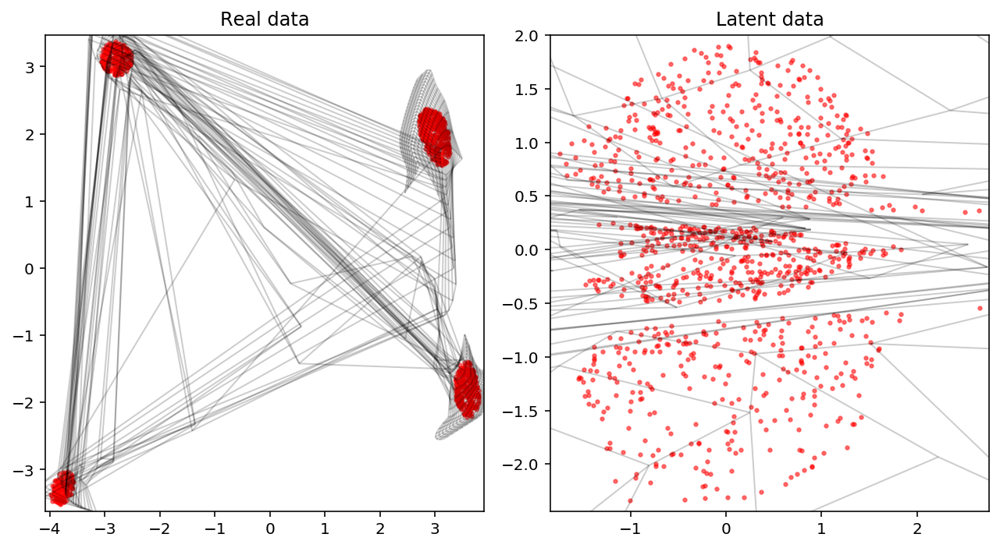

Creating directory for new run logs/test/run288
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


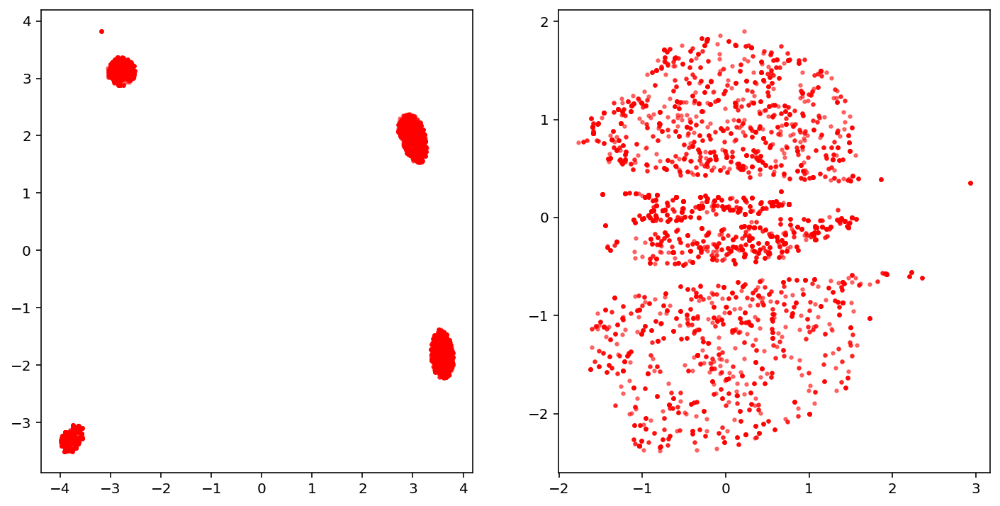

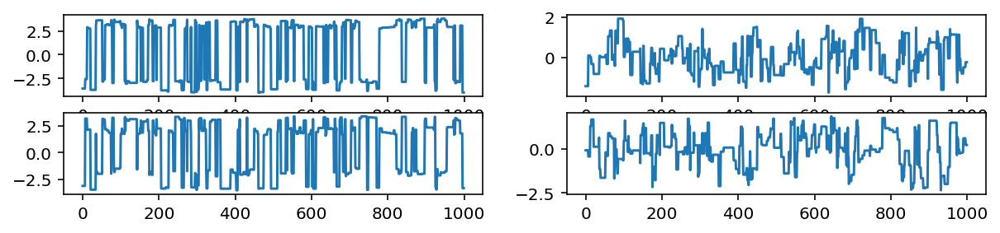

Removed no burn in
421.3475671272373
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.13E+01           11.34             441
param2           1.14E+01           11.39             439


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1442  p_{1}
param2        0.0820  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00244
  2      0.02406

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0062   0.0039   0.0064 upper
param1       0.0021   0.0066   0.0057 lower
param2       0.0014   0.0116   0.0081 upper
param2       0.0097   0.0102   0.0163 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [14]:
model = Trainer(like.x_dim, hidden_dim=64, num_blocks=5, flow='nvp', learning_rate=0.001)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedSpline(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): ActNorm()
      (1): Invertible1x1Conv()
      (2): NSF_CL(
        (f1): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
            (5): LeakyReLU(negative_slope=0.2)
            (6): Linear(in_features=16, out_features=23, bias=True)
          )
        )
        (f2): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
        

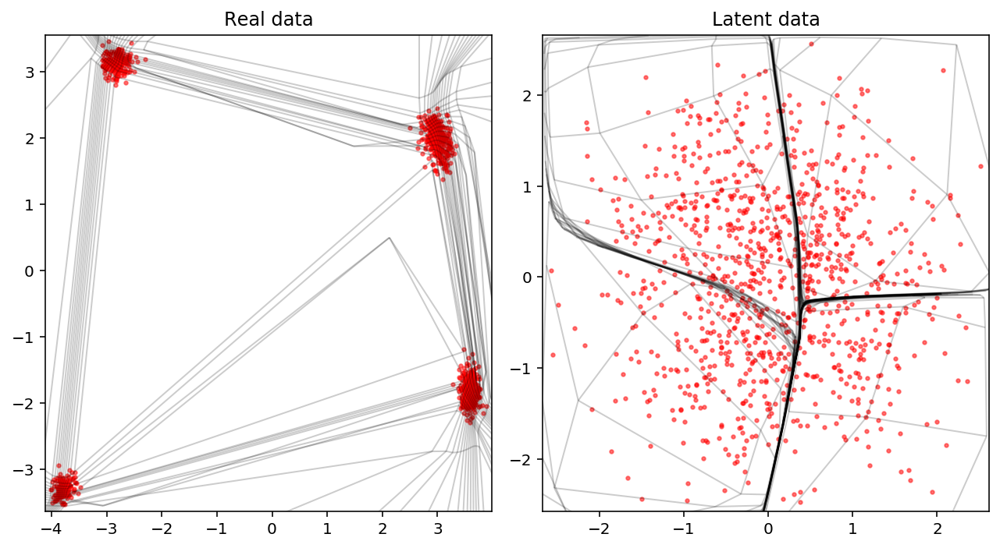

Creating directory for new run logs/test/run290
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


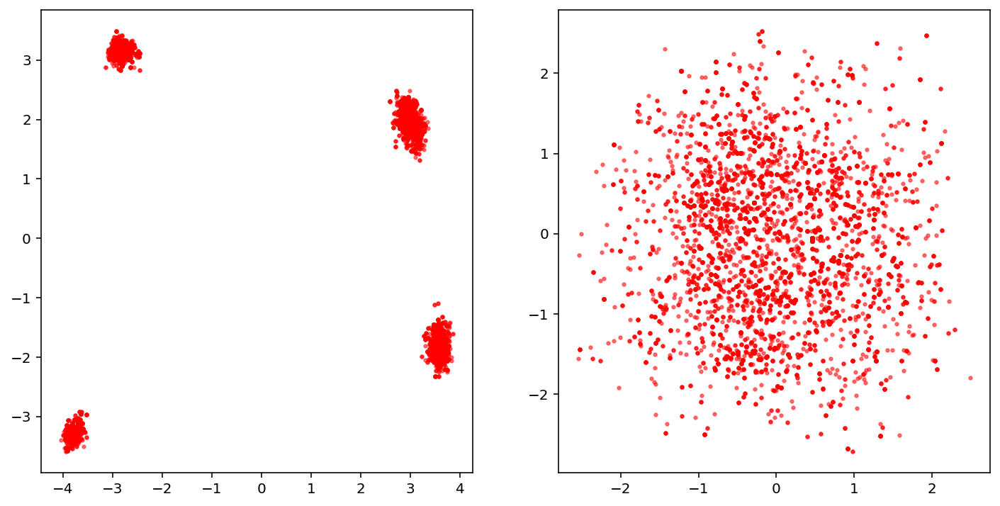

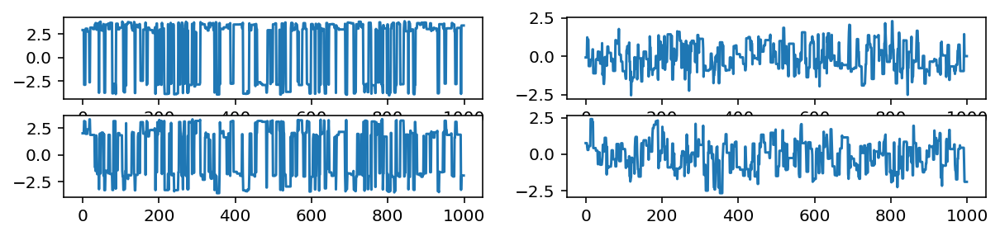

Removed no burn in
785.6461406096844
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.28E+00            6.28             796
param2           7.79E+00            7.79             642


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0671  p_{1}
param2        0.0567  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00194
  2      0.00569

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0002   0.0048   0.0062 upper
param1       0.0009   0.0057   0.0027 lower
param2       0.0015   0.0132   0.0086 upper
param2       0.0016   0.0043   0.0024 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

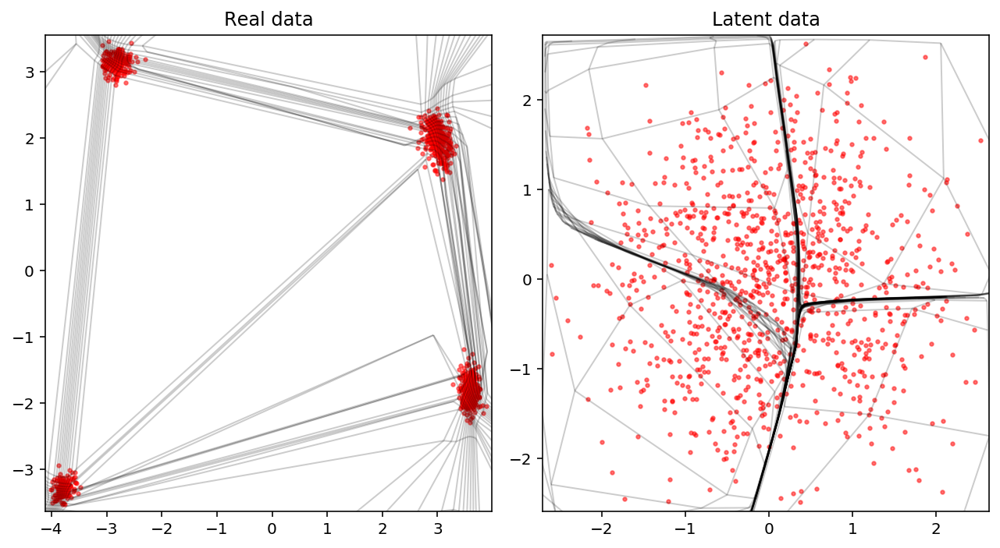

Creating directory for new run logs/test/run291
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


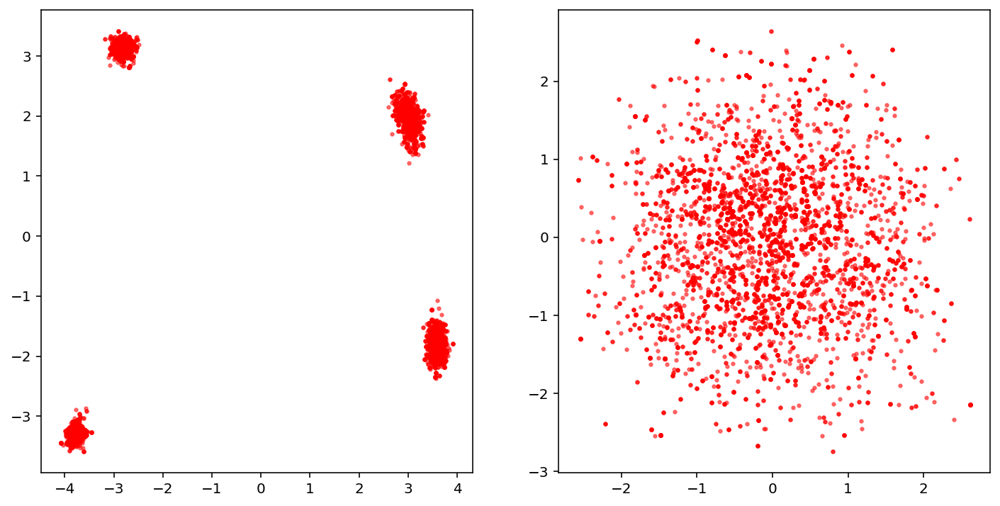

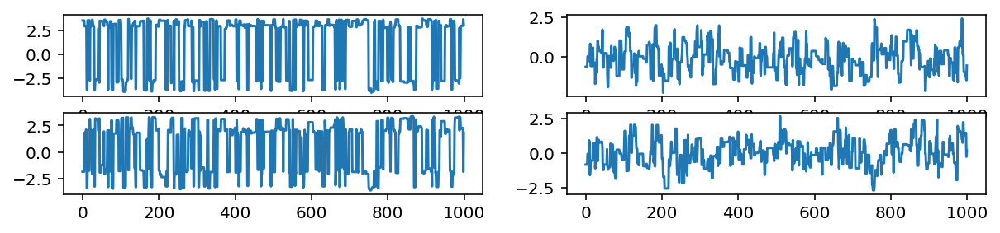

Removed no burn in
749.6660731125097
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.66E+00            6.66             750
param2           6.57E+00            6.57             762


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0561  p_{1}
param2        0.0962  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00182
  2      0.01037

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0001   0.0046   0.0028 upper
param1       0.0049   0.0059   0.0056 lower
param2       0.0014   0.0098   0.0052 upper
param2       0.0011   0.0092   0.0063 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

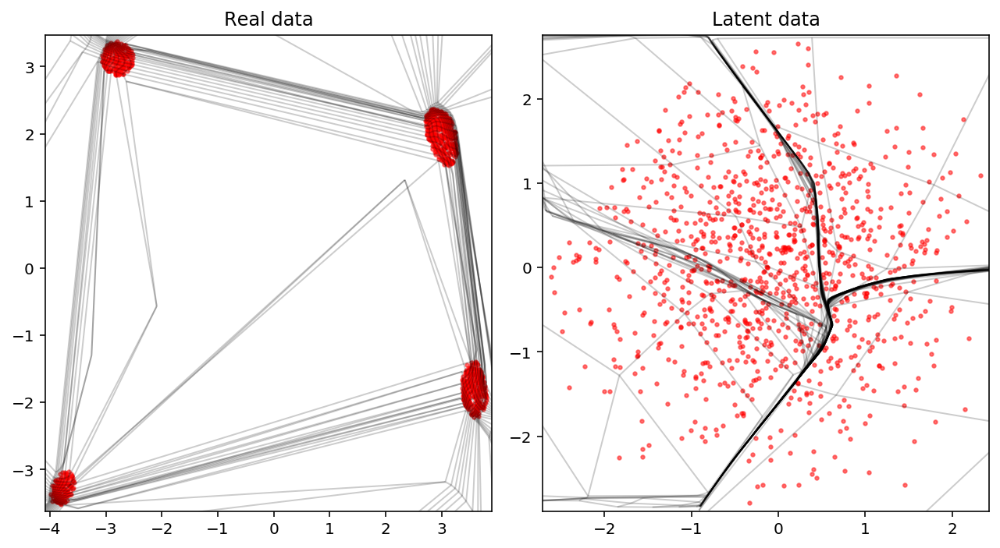

Creating directory for new run logs/test/run293
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


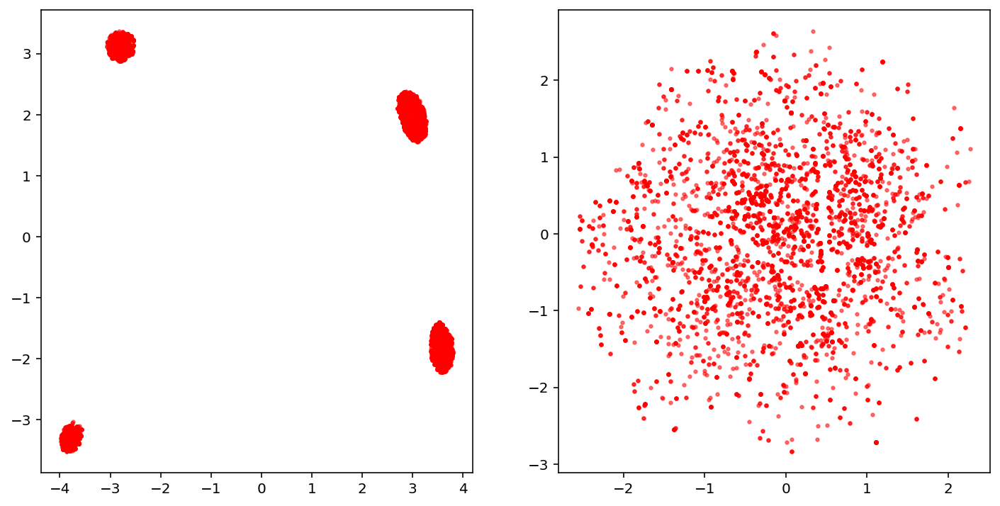

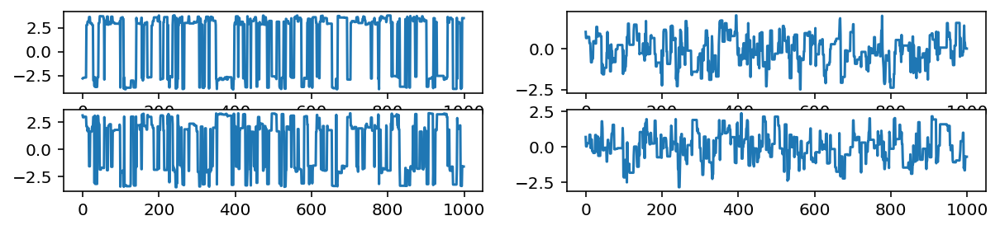

Removed no burn in
647.3250019148587
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.63E+00            7.63             656
param2           7.12E+00            7.12             703


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0718  p_{1}
param2        0.0724  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00399
  2      0.00643

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0009   0.0034   0.0040 upper
param1       0.0029   0.0057   0.0064 lower
param2       0.0033   0.0042   0.0065 upper
param2       0.0031   0.0024   0.0029 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

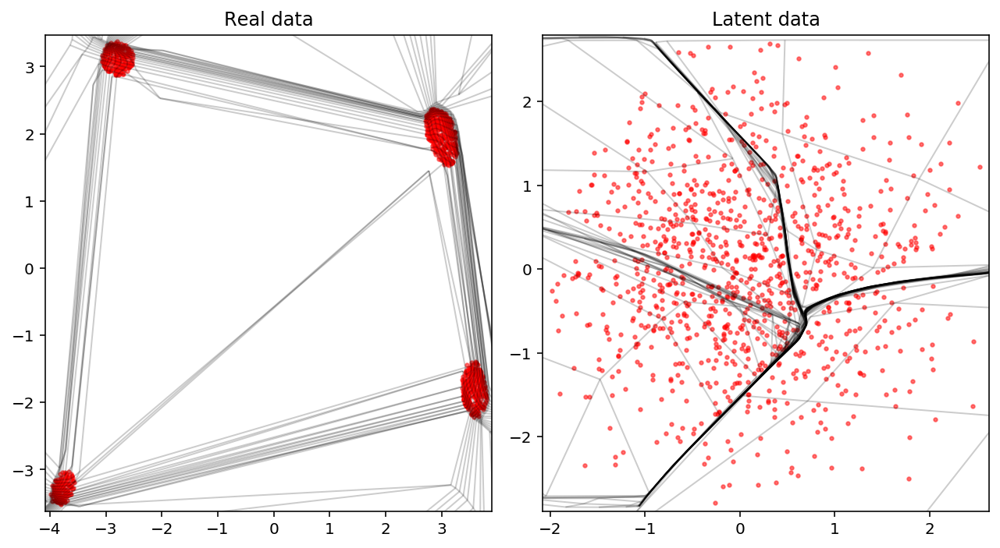

Creating directory for new run logs/test/run295
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


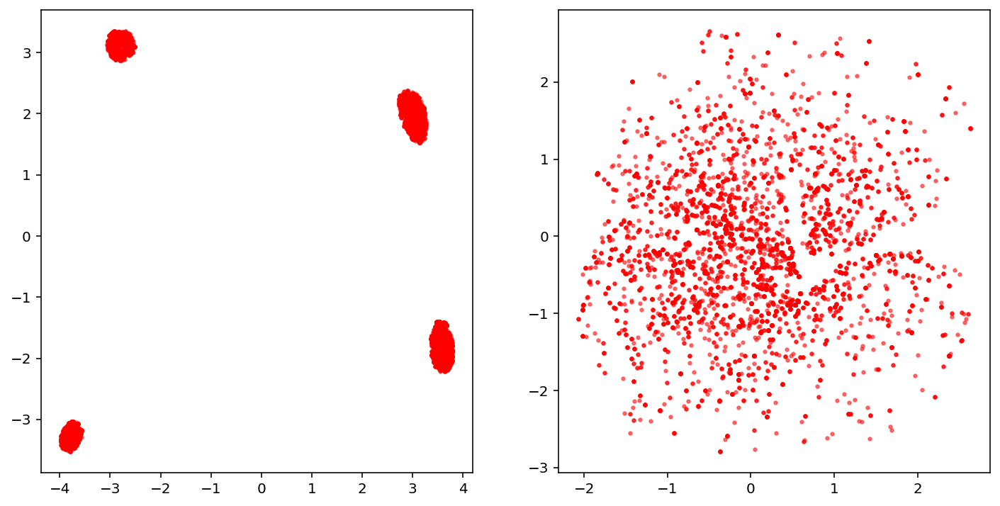

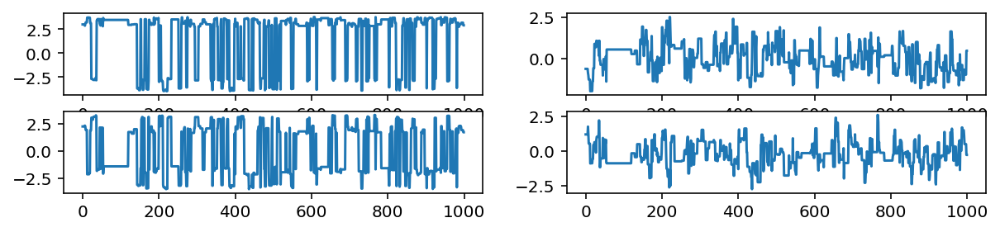

Removed no burn in
623.9686567845083
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.71E+00            7.71             649
param2           7.30E+00            7.30             685


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1049  p_{1}
param2        0.0500  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00223
  2      0.01125

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0042   0.0028   0.0040 upper
param1       0.0068   0.0057   0.0068 lower
param2       0.0049   0.0016   0.0069 upper
param2       0.0091   0.0098   0.0146 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [15]:
model = Trainer(like.x_dim, flow='spline', learning_rate=0.001)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

In [16]:
like = Rosenbrock(2)
prior = UniformPrior(2, -2, 12)

[nnest.trainer] [INFO] SingleSpeedCholeksy(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): Choleksy()
    )
  )
)
[nnest.trainer] [INFO] Number of network params: [5]
[nnest.trainer] [INFO] Device [cpu]
[nnest.trainer] [INFO] Number of training samples [1000]
[nnest.trainer] [INFO] Training jitter [0.0010]
[nnest.trainer] [INFO] Epoch [1] train loss [0.0502] validation loss [0.0384]
[nnest.trainer] [INFO] Epoch [100] train loss [0.0277] validation loss [0.0255]
[nnest.trainer] [INFO] Epoch [200] train loss [0.0251] validation loss [0.0238]
[nnest.trainer] [INFO] Epoch [300] train loss [0.0236] validation loss [0.0228]
[nnest.trainer] [INFO] Epoch [400] train loss [0.0225] validation loss [0.0221]
[nnest.trainer] [INFO] Epoch [500] train loss [0.0218] validation loss [0.0218]
[nnest.trainer] [INFO] Epoch [584] ran out of patience
[nnest.trainer] [INFO] Best epoch [534] validation loss [0.0218] train time (s) [8.3113]]


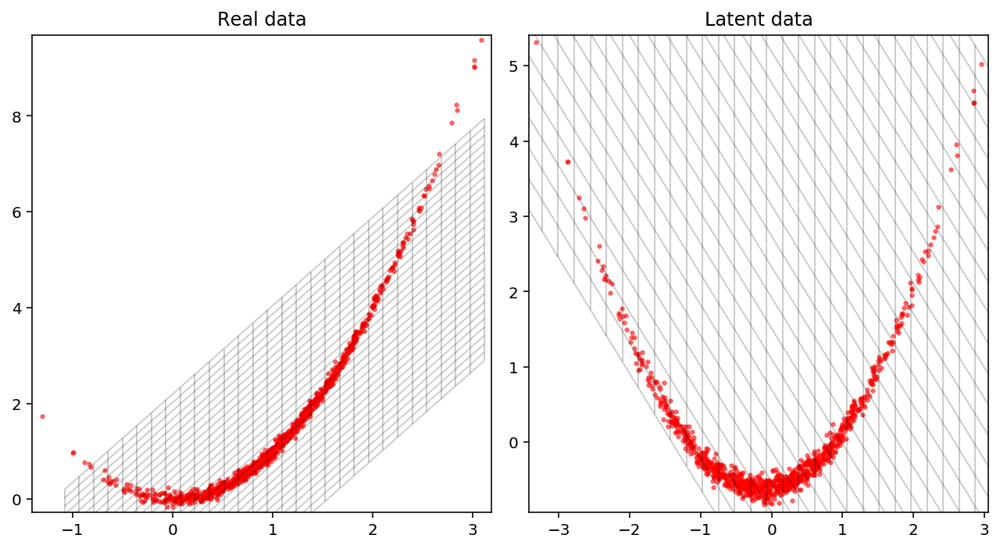

Creating directory for new run logs/test/run297
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


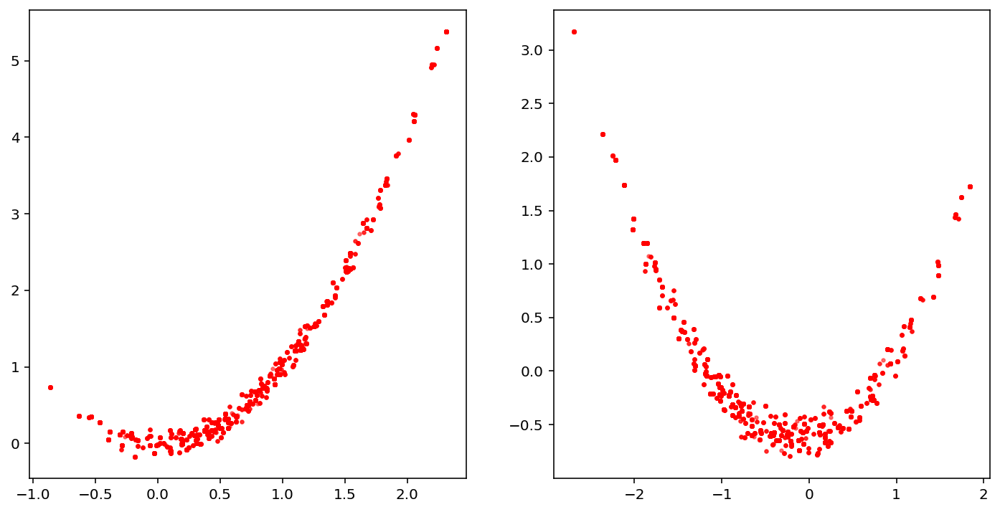

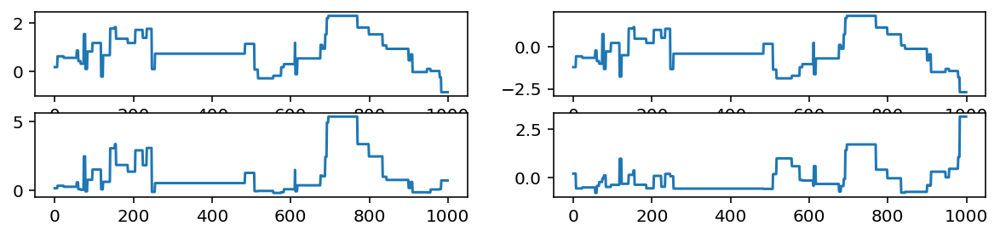

Removed no burn in
52.71696766939939
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           9.03E-01            0.90            5540
param2           6.93E+01           69.26              72


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.3656  p_{1}
param2        0.2682  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.01193
  2      0.14730

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.4014   0.3277   0.4787 upper
param1       0.1492   0.2224   0.2748 lower
param2       0.8854   0.7229   1.0612 upper
param2       0.0180   0.0384   0.0748 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

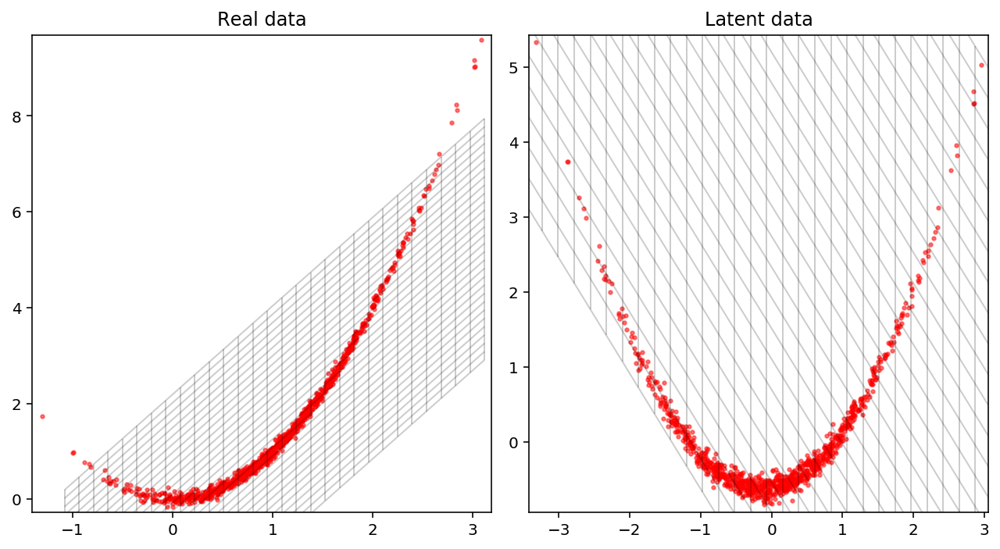

Creating directory for new run logs/test/run298
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


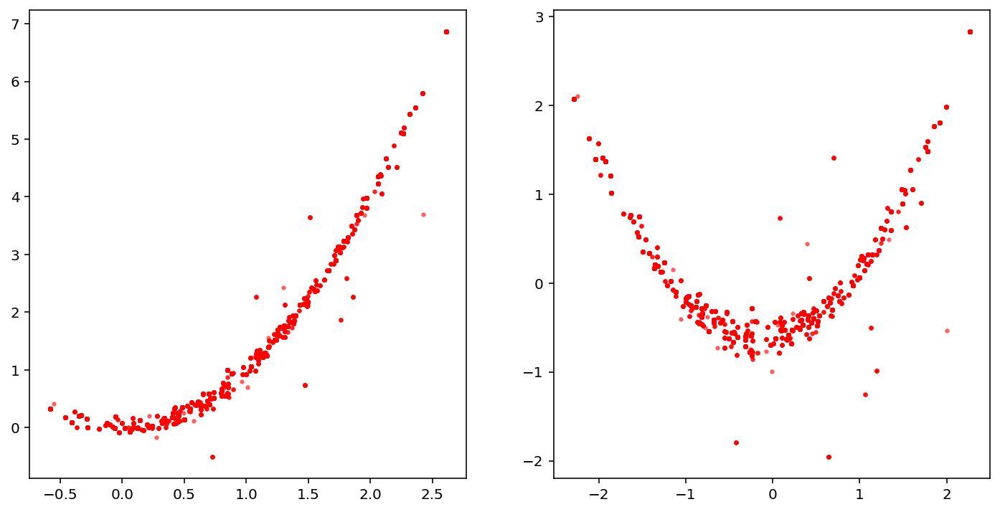

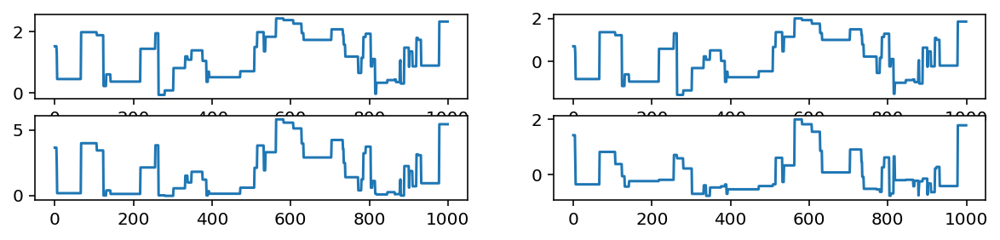

Removed no burn in
58.210642655305385
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           9.18E-01            0.92            5451
param2           9.34E-01            0.93            5357


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.3340  p_{1}
param2        0.2965  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.02607
  2      0.11288

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.2630   0.3102   0.4077 upper
param1       0.1479   0.1270   0.1380 lower
param2       0.5855   0.7344   0.9312 upper
param2       0.0194   0.0178   0.0154 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1         

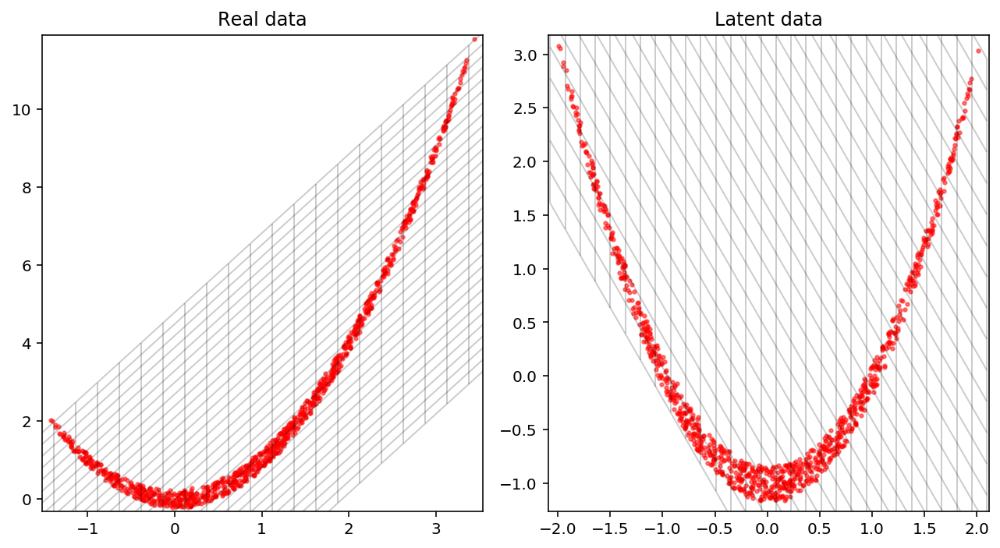

Creating directory for new run logs/test/run299
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


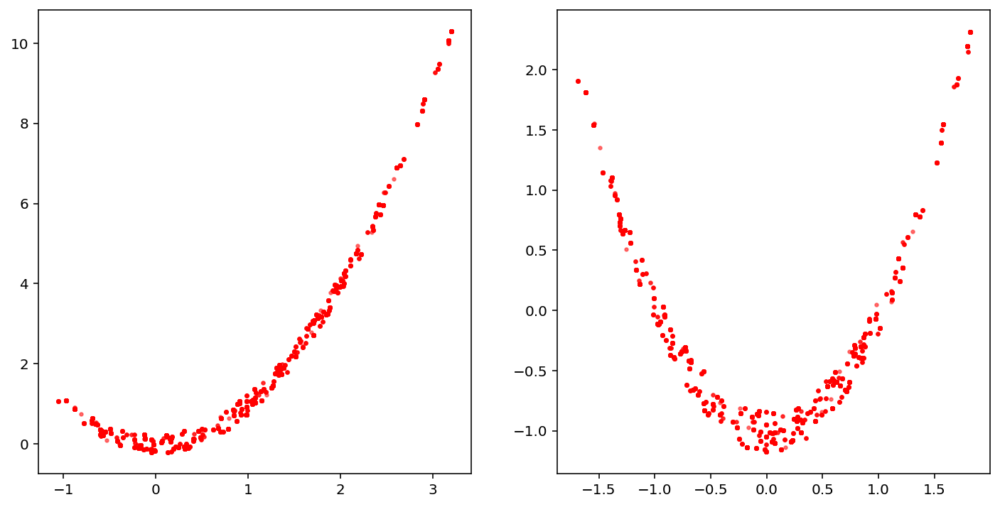

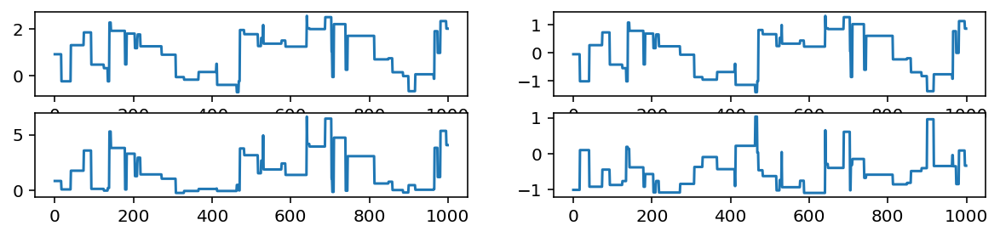

Removed no burn in
45.77811219645501
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           5.59E+01           55.85              89
param2           7.57E-01            0.76            6613


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.5779  p_{1}
param2        0.6339  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.05939
  2      0.40397

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.3630   0.4890   0.4515 upper
param1       0.1786   0.1473   0.2890 lower
param2       0.8364   1.1027   1.0561 upper
param2       0.0085   0.0239   0.0589 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

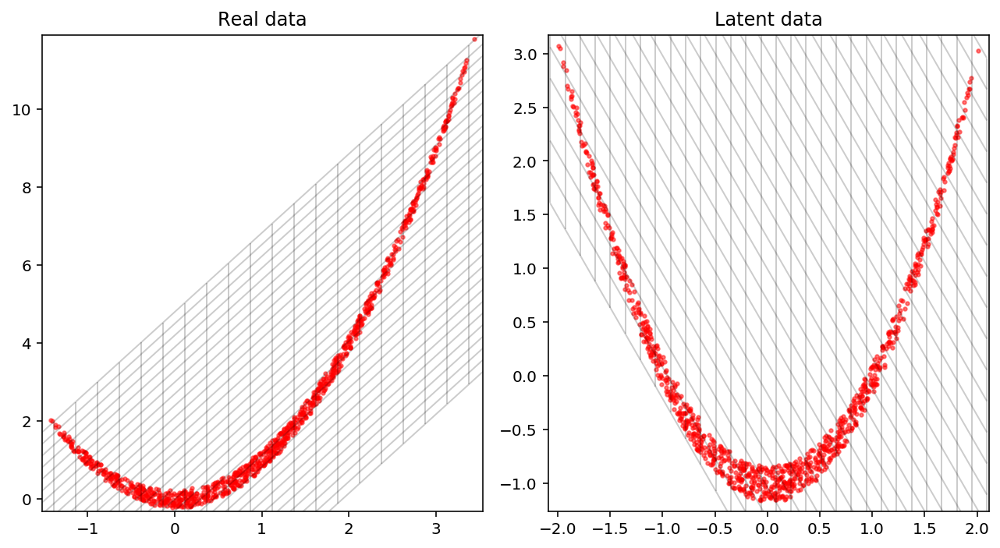

Creating directory for new run logs/test/run300
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


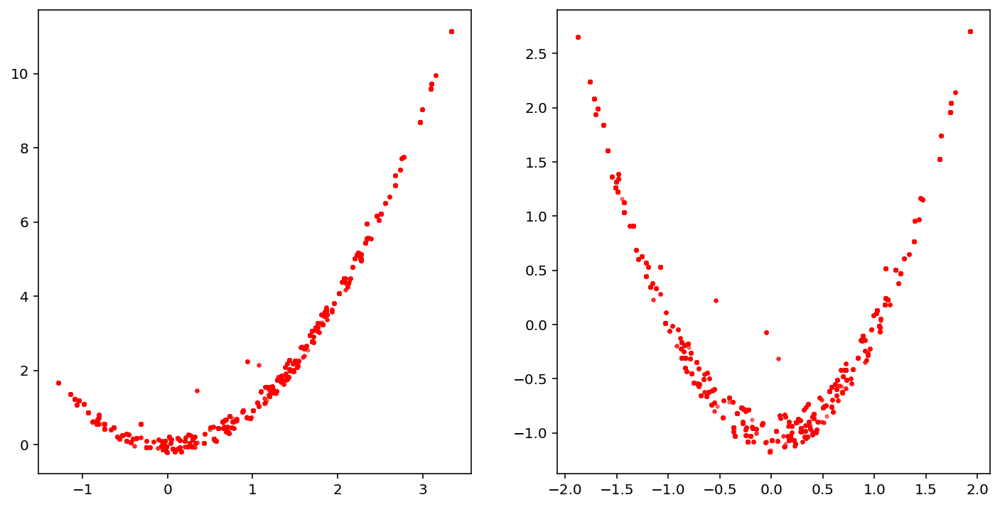

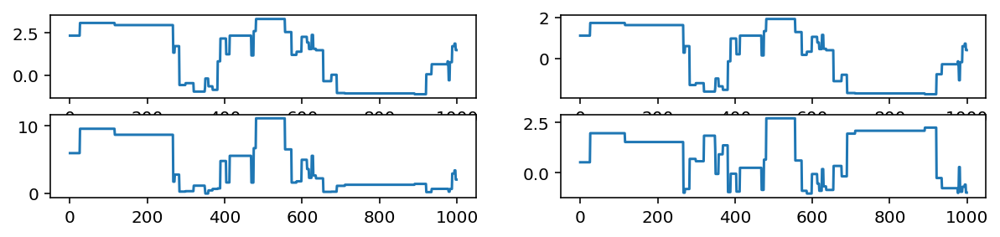

Removed no burn in
31.007276122458414
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.70E-01            0.87            5754
param2           8.12E-01            0.81            6164


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.4326  p_{1}
param2        0.5380  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.17486
  2      0.38631

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.1213   0.1834   0.5242 upper
param1       0.0251   0.0733   0.1847 lower
param2       0.3527   0.4990   1.2977 upper
param2       0.0000   0.0120   0.0180 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

In [17]:
model = Trainer(like.x_dim, flow='choleksy', learning_rate=0.001)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedNVP(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=2, bias=True)
        )
        (translate_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): ReLU()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): ReLU()
          (4): Linear(in_features=64, out_features=2, bias=True)
        )
      )
      (1): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=2, bias=True)
      

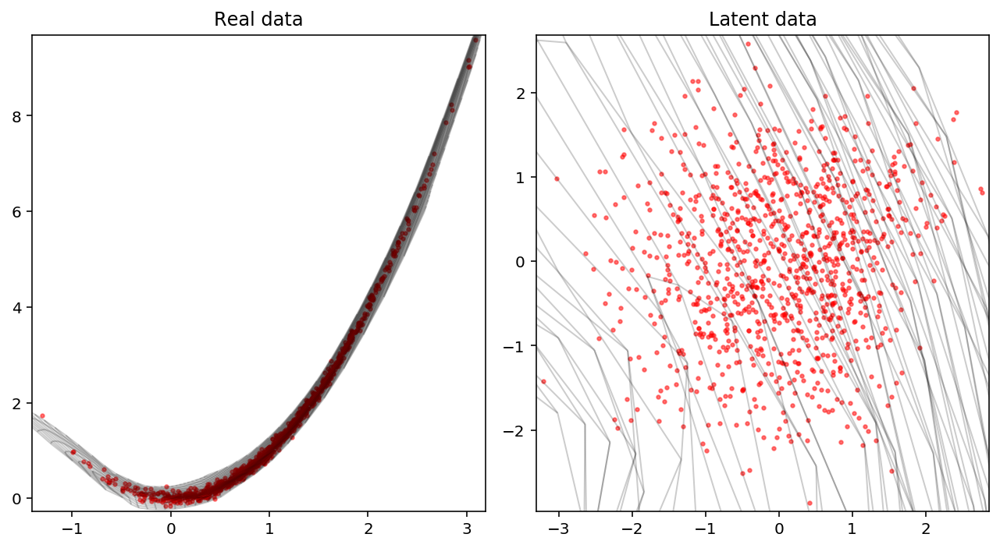

Creating directory for new run logs/test/run301
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


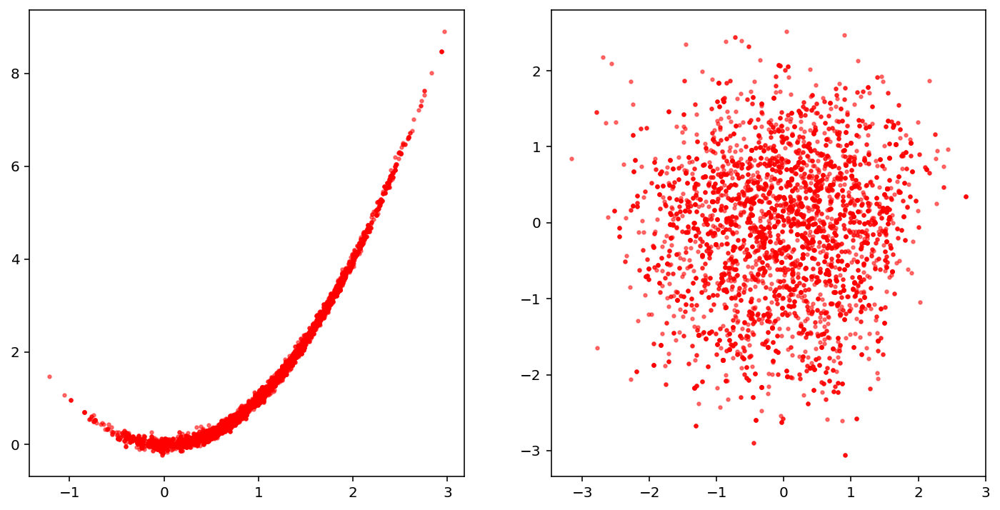

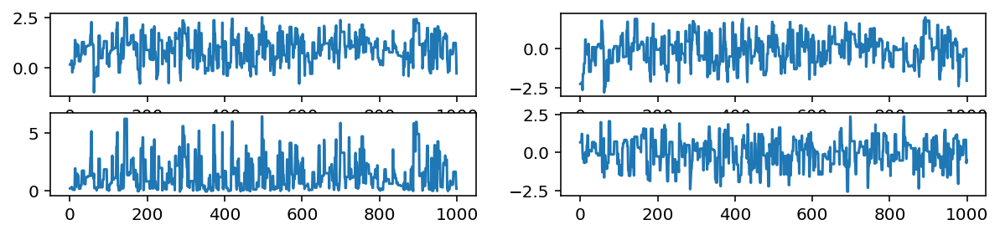

Removed no burn in
807.3532976283832
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.07E+00            6.07             824
param2           5.58E+00            5.58             897


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1055  p_{1}
param2        0.0998  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00201
  2      0.01116

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.1205   0.1243   0.1421 upper
param1       0.0784   0.0706   0.1009 lower
param2       0.2591   0.2869   0.2805 upper
param2       0.0063   0.0040   0.0074 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

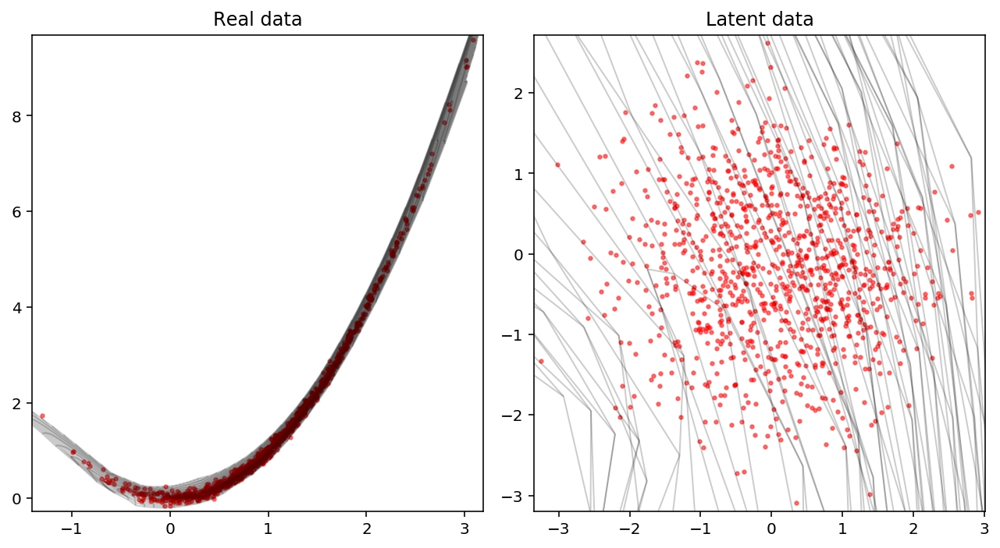

Creating directory for new run logs/test/run302
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


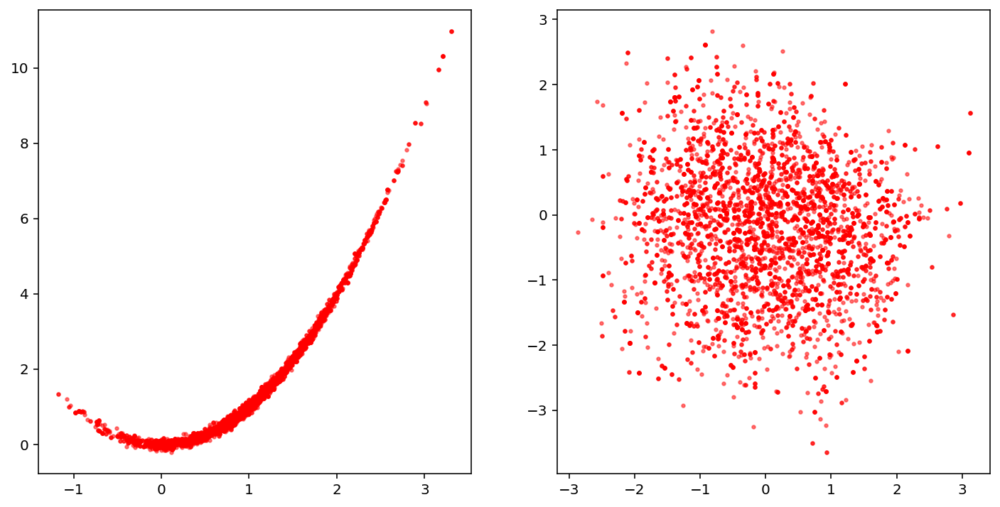

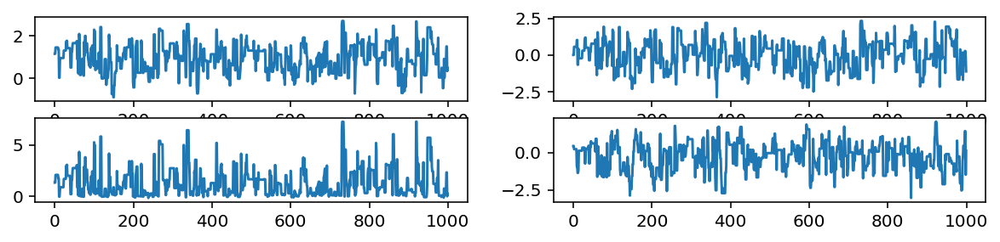

Removed no burn in
606.8851886317507
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.20E+00            8.20             610
param2           7.66E+00            7.66             653


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0601  p_{1}
param2        0.0485  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00207
  2      0.00522

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0061   0.0844   0.0342 upper
param1       0.1293   0.2147   0.2749 lower
param2       0.0441   0.1709   0.0840 upper
param2       0.0032   0.0045   0.0047 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

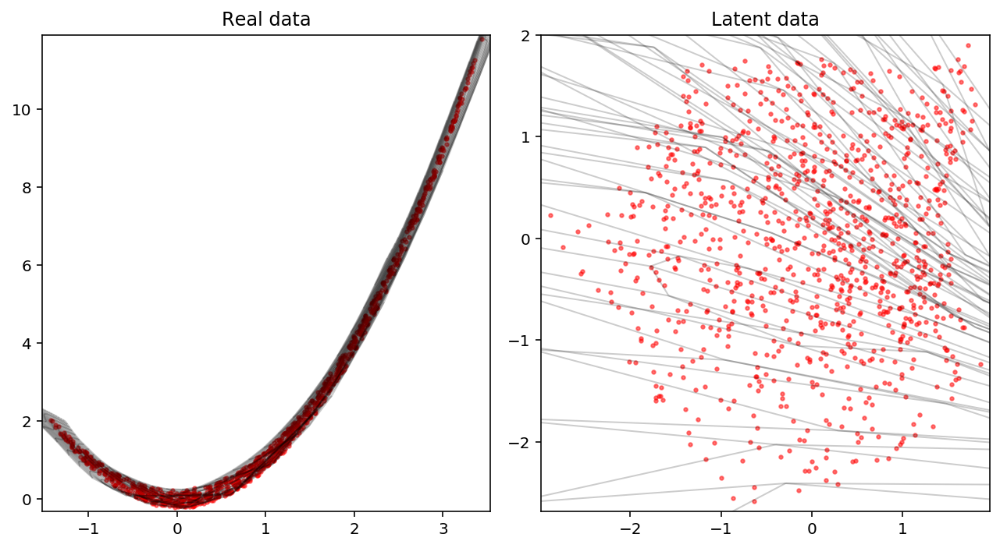

Creating directory for new run logs/test/run303
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


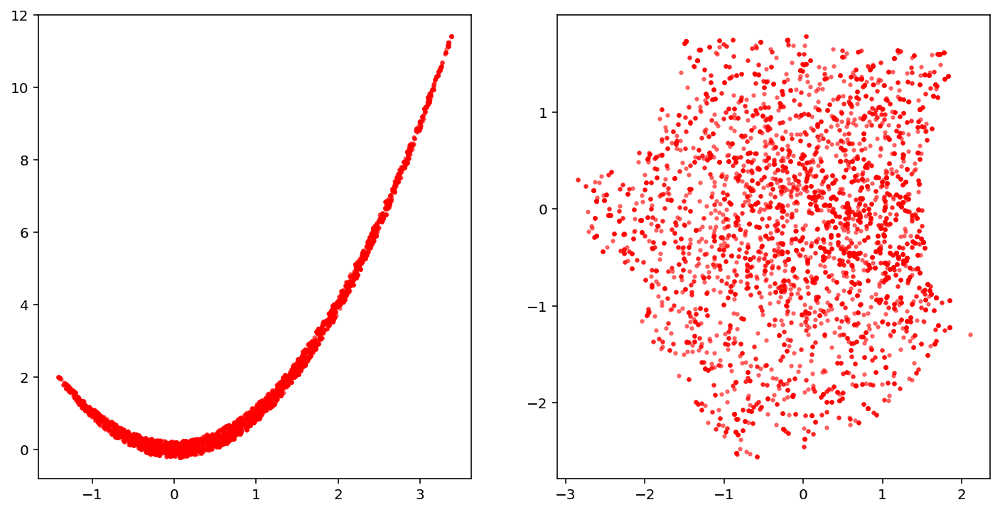

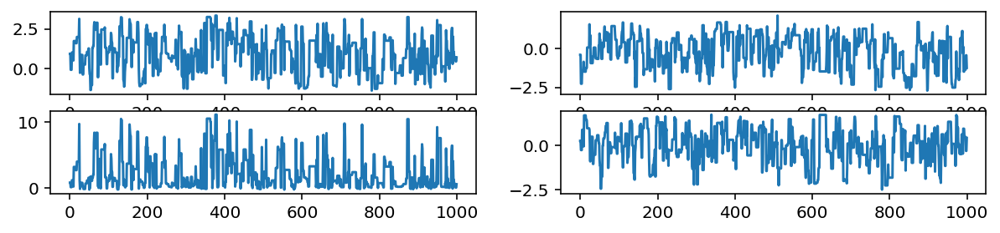

Removed no burn in
584.3203659702922
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.69E+00            8.69             575
param2           8.43E+00            8.43             593


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0338  p_{1}
param2        0.0355  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00080
  2      0.00535

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0374   0.0176   0.0726 upper
param1       0.0189   0.0253   0.0254 lower
param2       0.1060   0.0580   0.1930 upper
param2       0.0085   0.0138   0.0129 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

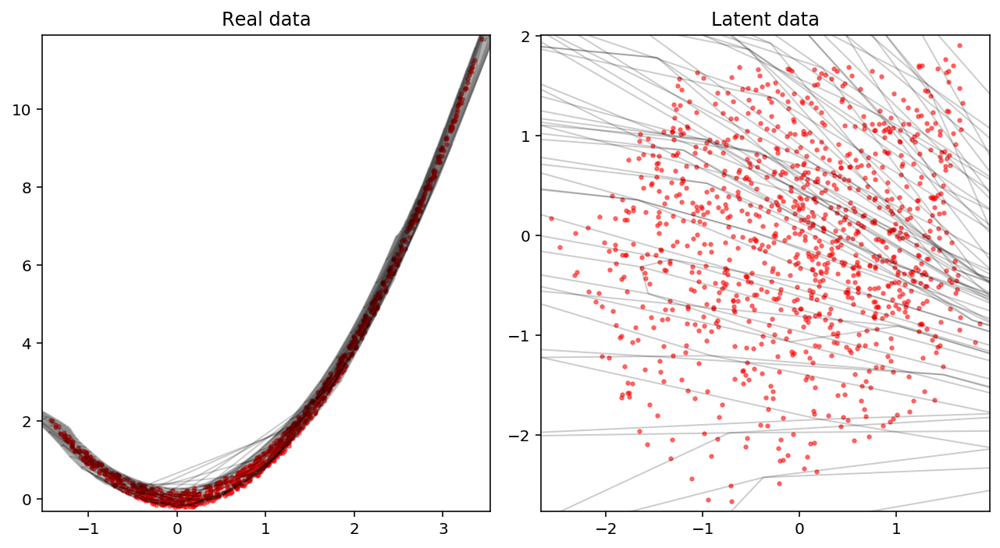

Creating directory for new run logs/test/run304
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


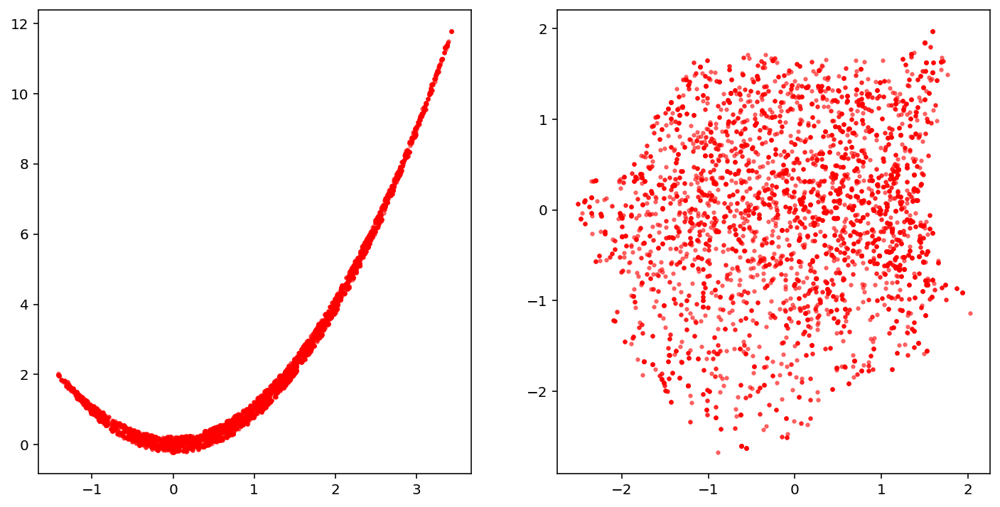

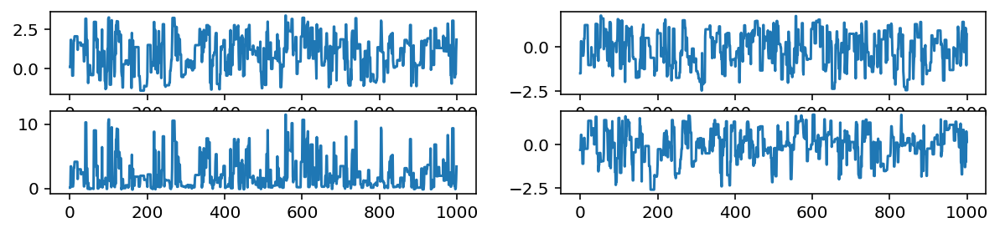

Removed no burn in
632.149883923584
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.72E+00            7.72             648
param2           6.72E+00            6.72             744


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1038  p_{1}
param2        0.0820  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00506
  2      0.01263

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0008   0.0107   0.0461 upper
param1       0.0308   0.0166   0.0827 lower
param2       0.0037   0.0486   0.1221 upper
param2       0.0109   0.0086   0.0123 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1           

In [18]:
model = Trainer(like.x_dim, hidden_dim=64, num_blocks=5, flow='nvp', learning_rate=0.001)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedSpline(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): ActNorm()
      (1): Invertible1x1Conv()
      (2): NSF_CL(
        (f1): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
            (5): LeakyReLU(negative_slope=0.2)
            (6): Linear(in_features=16, out_features=23, bias=True)
          )
        )
        (f2): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
        

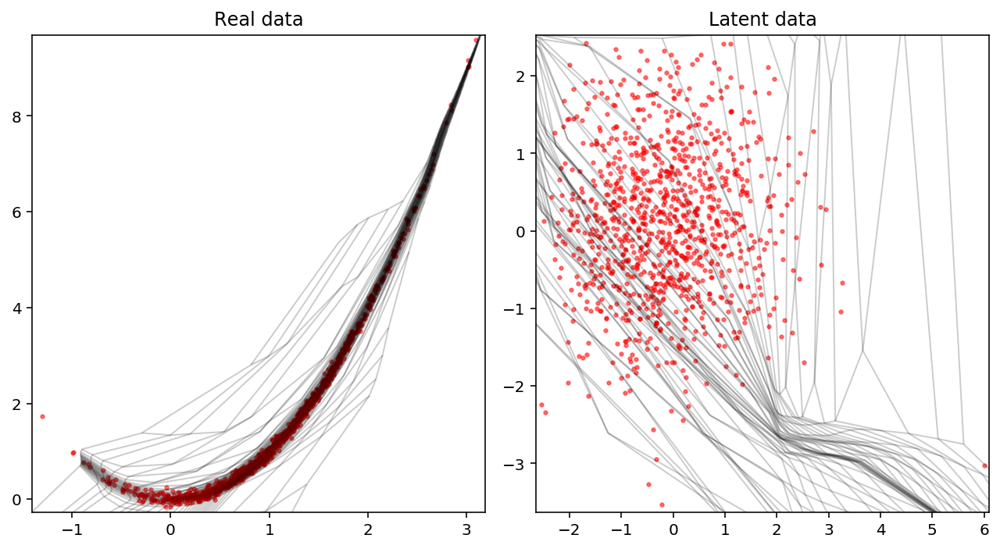

Creating directory for new run logs/test/run305
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


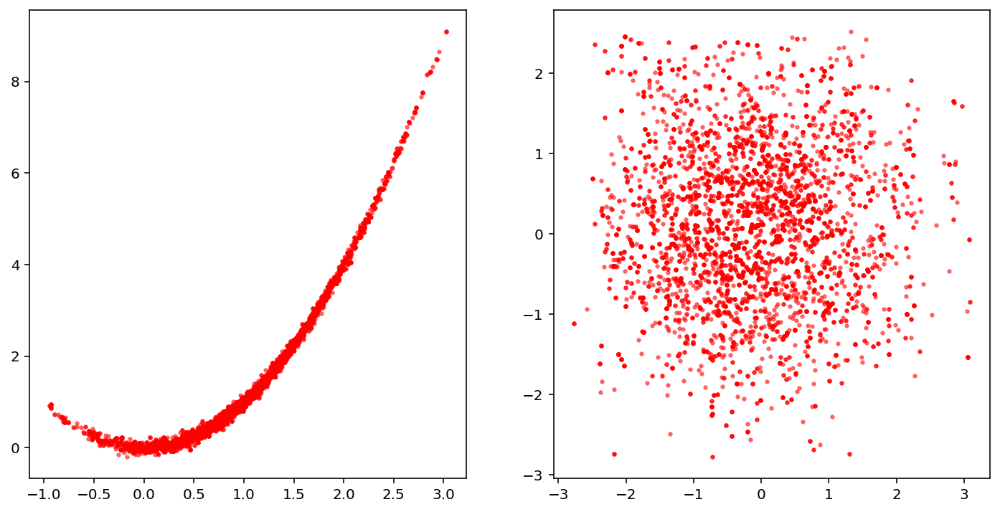

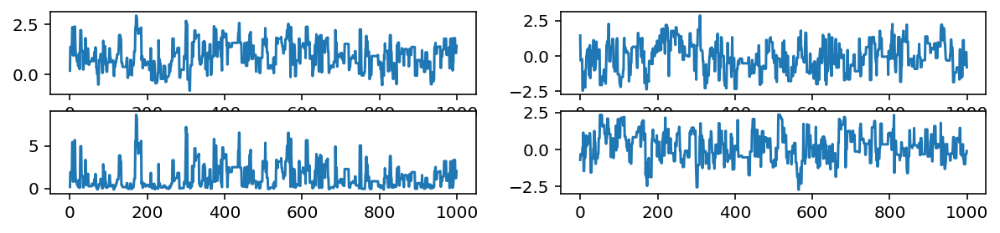

Removed no burn in
683.079667923192
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.17E+00            7.17             697
param2           6.62E+00            6.62             755


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0892  p_{1}
param2        0.0818  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00423
  2      0.00813

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0437   0.0643   0.0739 upper
param1       0.0841   0.1346   0.0805 lower
param2       0.0831   0.0974   0.1682 upper
param2       0.0024   0.0058   0.0168 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1           

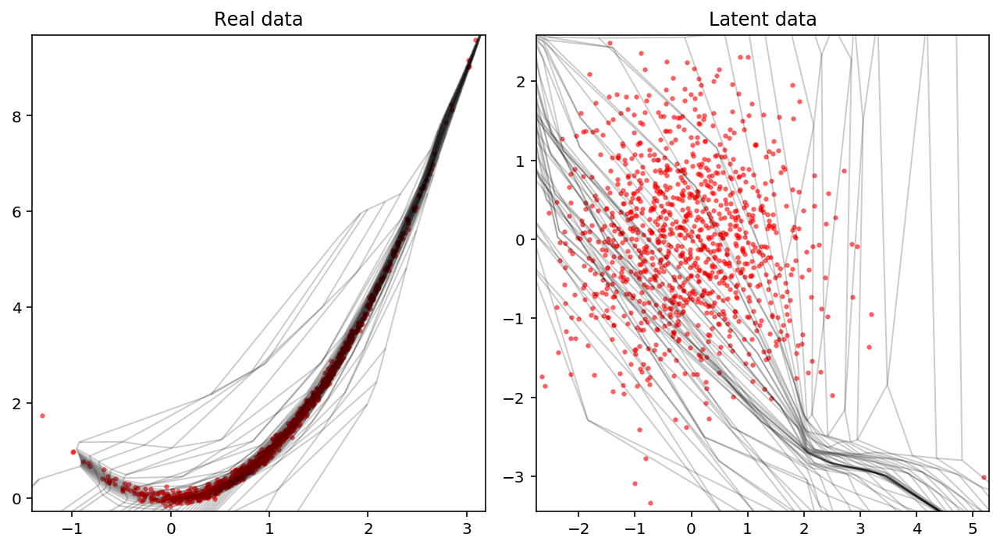

Creating directory for new run logs/test/run306
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


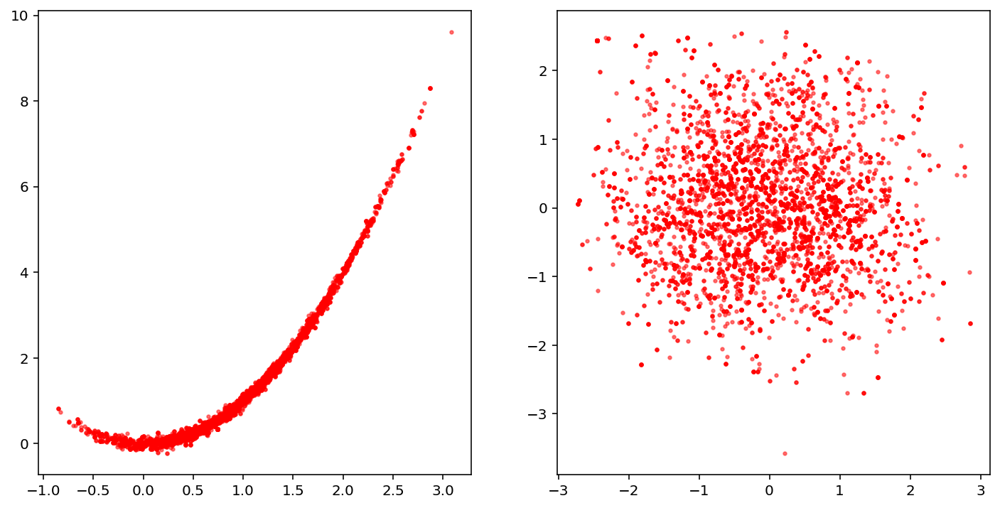

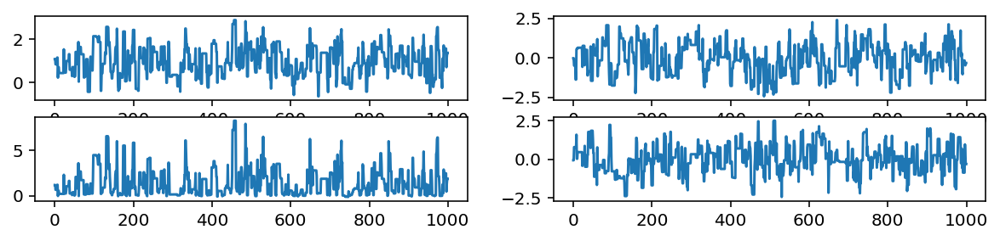

Removed no burn in
708.8290922234106
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.02E+00            7.02             712
param2           6.58E+00            6.58             760


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0493  p_{1}
param2        0.0558  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00242
  2      0.00827

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0656   0.0650   0.1866 upper
param1       0.0564   0.0439   0.1881 lower
param2       0.1614   0.1637   0.3761 upper
param2       0.0174   0.0233   0.0214 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

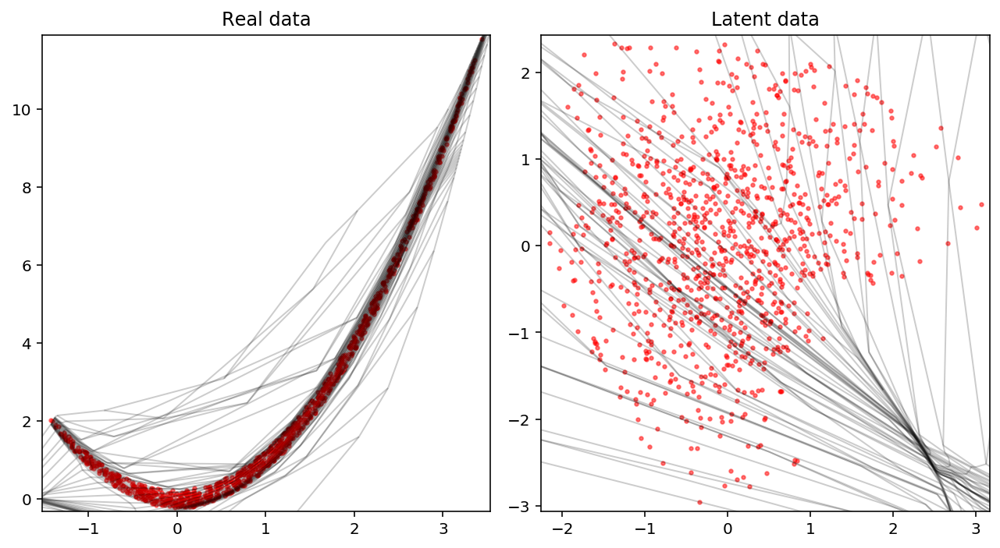

Creating directory for new run logs/test/run307
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


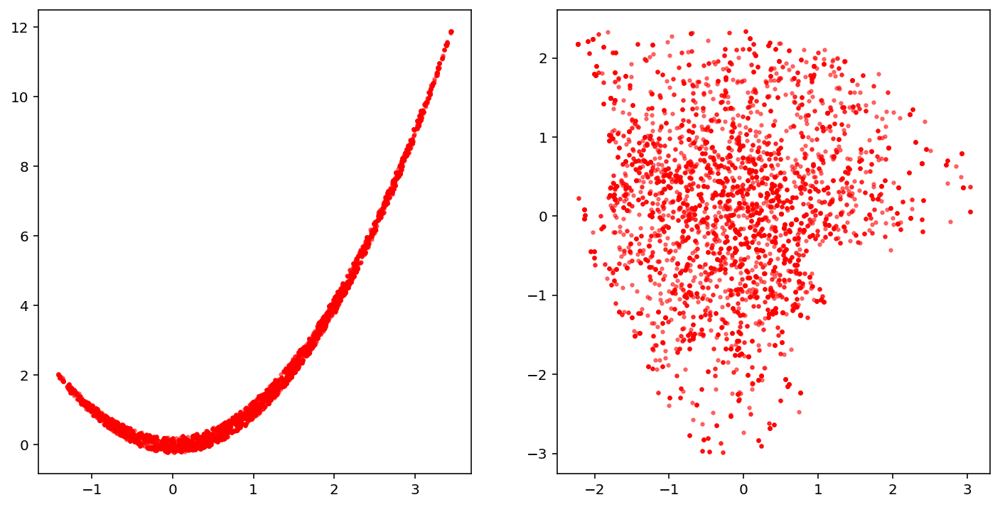

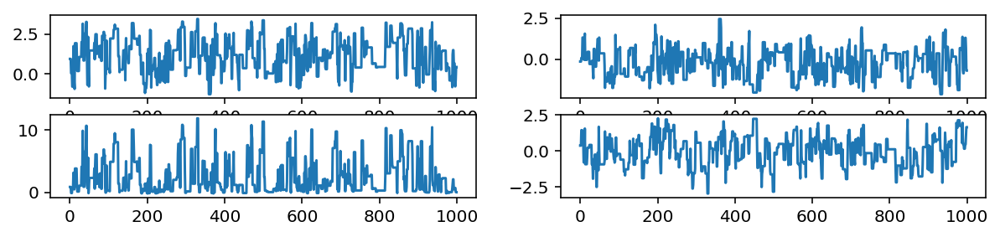

Removed no burn in
620.1030318967684
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.83E+00            7.83             639
param2           7.18E+00            7.18             697


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1181  p_{1}
param2        0.0916  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00546
  2      0.01569

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0496   0.0452   0.0555 upper
param1       0.0392   0.0223   0.1066 lower
param2       0.1372   0.1118   0.1505 upper
param2       0.0013   0.0138   0.0122 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

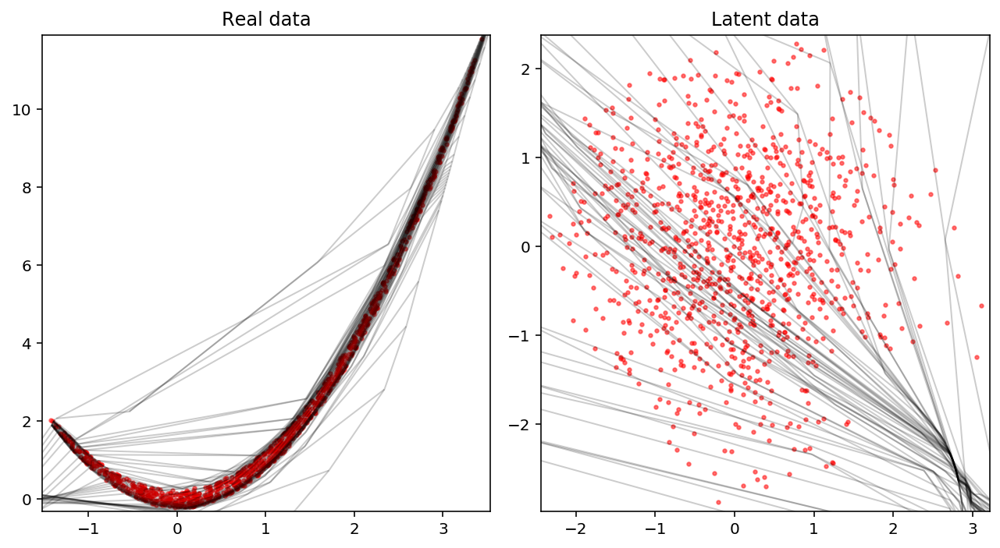

Creating directory for new run logs/test/run309
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


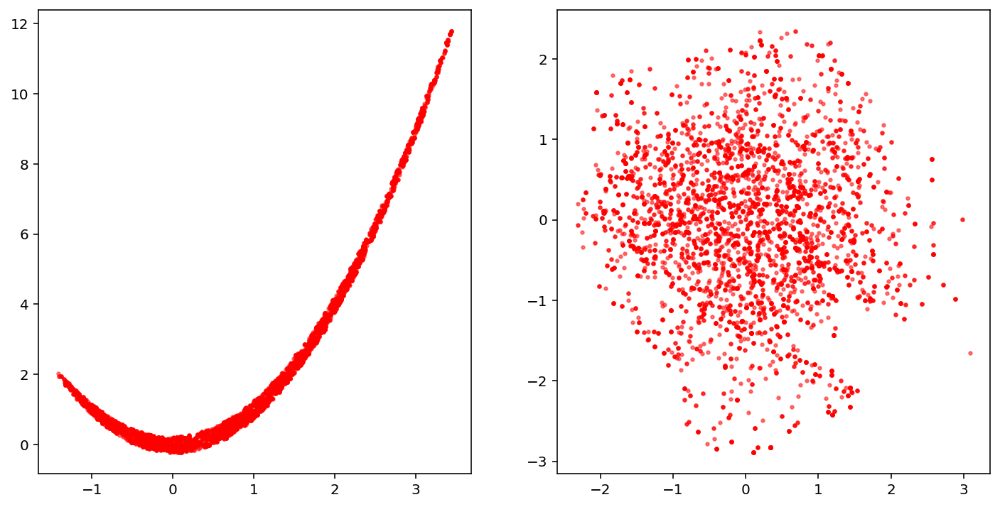

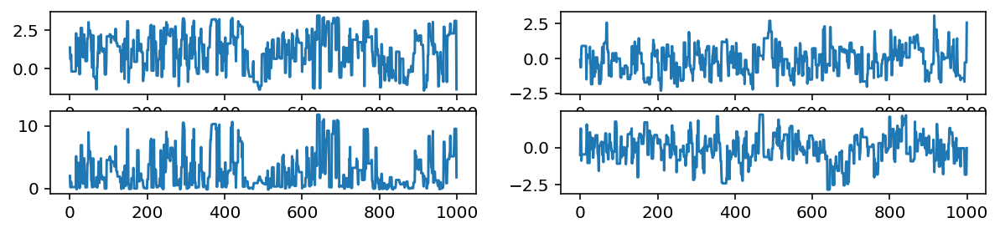

Removed no burn in
650.4902279145977
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.26E+00            7.26             689
param2           7.08E+00            7.08             706


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1377  p_{1}
param2        0.1026  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00159
  2      0.02011

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0069   0.0598   0.0394 upper
param1       0.0438   0.0601   0.0514 lower
param2       0.0168   0.1560   0.1221 upper
param2       0.0038   0.0030   0.0111 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [19]:
model = Trainer(like.x_dim, flow='spline', learning_rate=0.001)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

In [20]:
prior = UniformPrior(2, -15, 15)
like = Eggbox(2)

[nnest.trainer] [INFO] SingleSpeedCholeksy(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): Choleksy()
    )
  )
)
[nnest.trainer] [INFO] Number of network params: [5]
[nnest.trainer] [INFO] Device [cpu]
[nnest.trainer] [INFO] Number of training samples [1000]
[nnest.trainer] [INFO] Training jitter [0.0010]
[nnest.trainer] [INFO] Epoch [1] train loss [0.8740] validation loss [0.8449]
[nnest.trainer] [INFO] Epoch [100] train loss [0.3412] validation loss [0.3316]
[nnest.trainer] [INFO] Epoch [200] train loss [0.1778] validation loss [0.1738]
[nnest.trainer] [INFO] Epoch [300] train loss [0.1173] validation loss [0.1153]
[nnest.trainer] [INFO] Epoch [400] train loss [0.0918] validation loss [0.0906]
[nnest.trainer] [INFO] Epoch [500] train loss [0.0805] validation loss [0.0798]
[nnest.trainer] [INFO] Epoch [600] train loss [0.0755] validation loss [0.0750]
[nnest.trainer] [INFO] Epoch [700] train loss [0.0736] validation loss [0.0733]
[nnest.trainer] [INFO] Epoch [800] tra

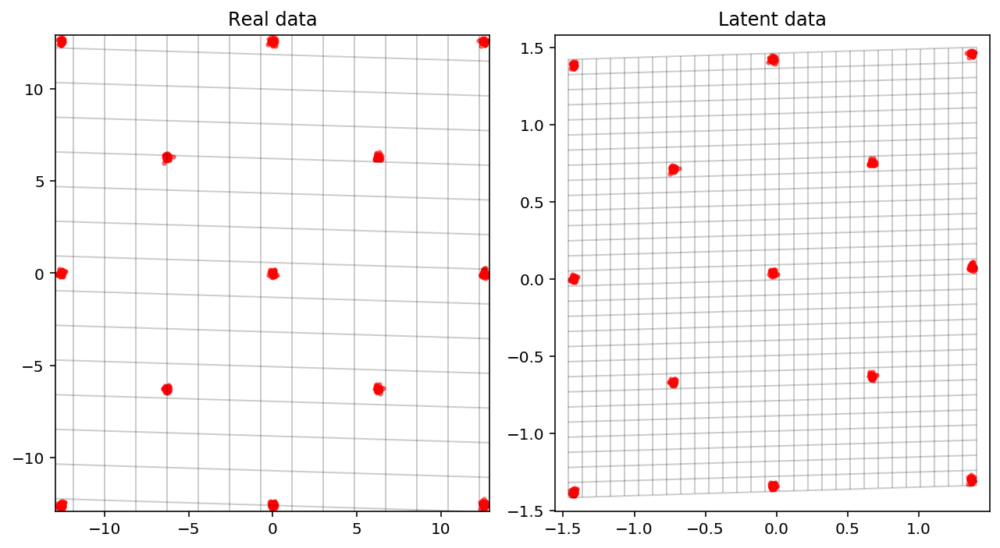

Creating directory for new run logs/test/run310
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


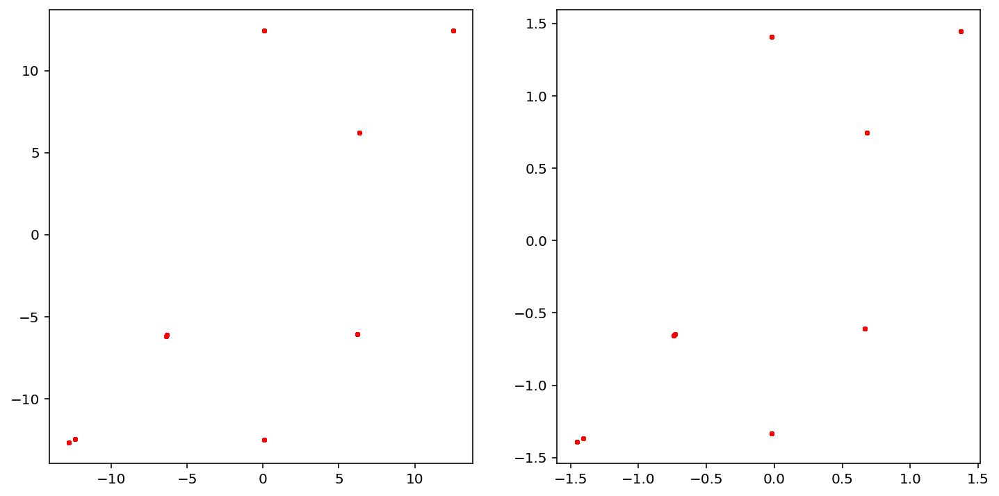

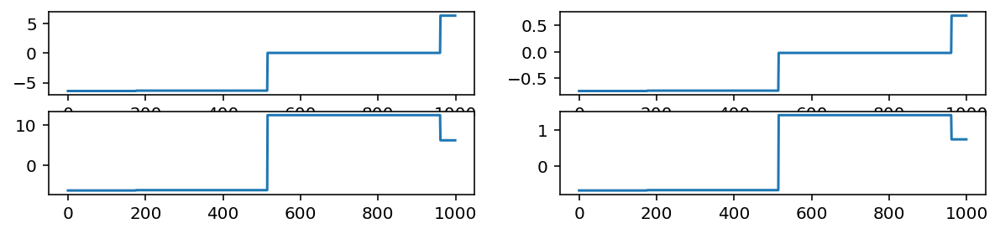

Removed no burn in
5004.999980149633
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           2.00E-01            0.20           25086
param2           1.54E-01            0.15           32538


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        2.2395  p_{1}
param2        2.6223  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      2.87522
  2      6.96119

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0000   0.8587   0.4697 upper
param1       0.0312   0.0255   0.6860 lower
param2       0.0000   0.9805   0.8492 upper
param2       0.0116   0.0095   0.0116 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

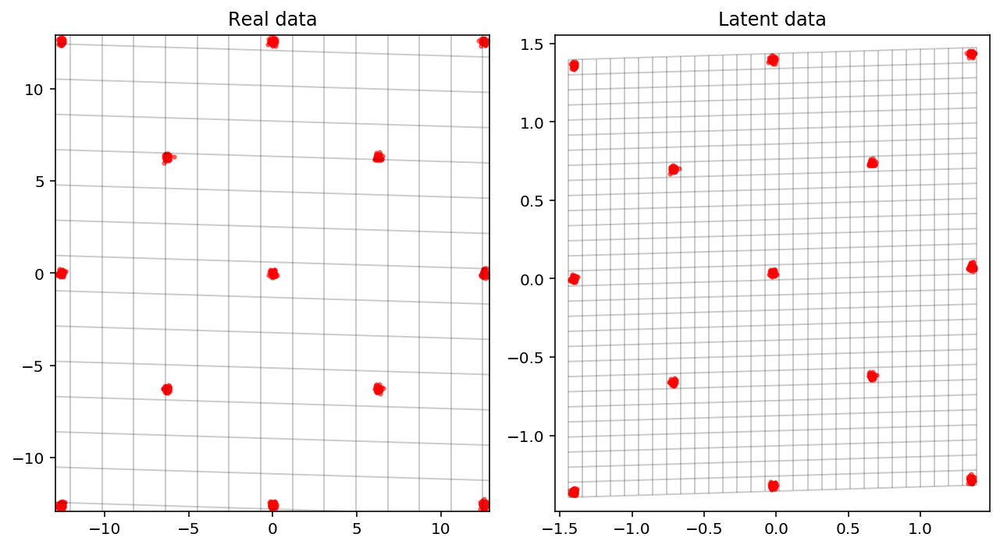

Creating directory for new run logs/test/run311
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


/Users/adammoss/work/code/MCMC/nnest/nnest/sampler.py:351: RuntimeWarning: invalid value encountered in subtract
  log_ratio_3 = torch.tensor(logl_prior_prime - logl_prior)


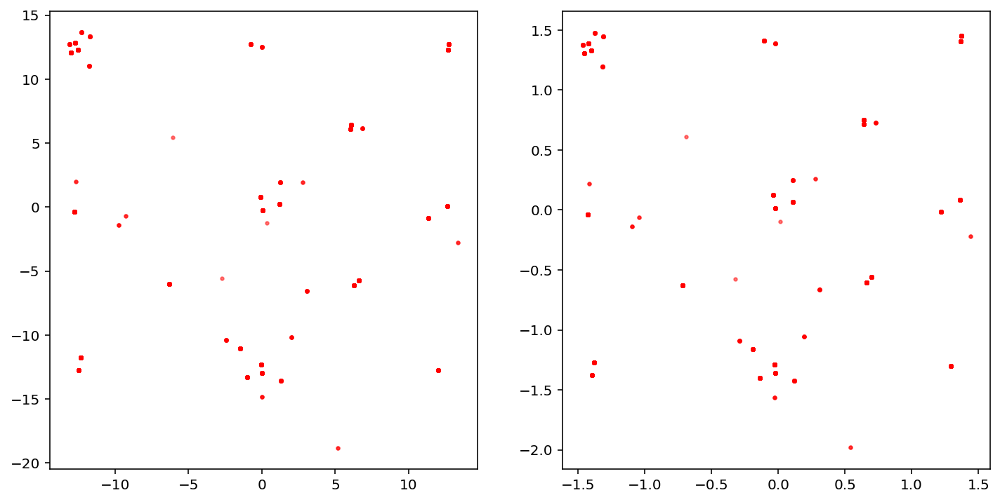

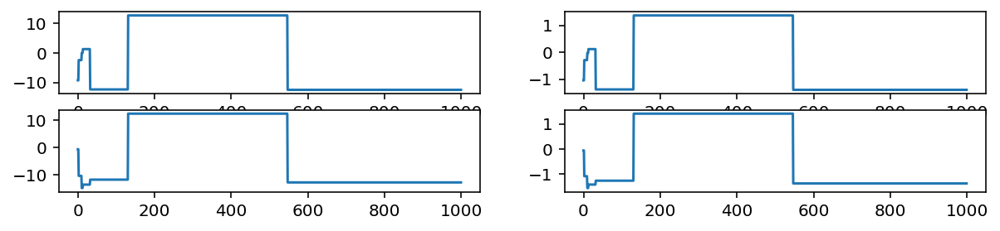

Removed no burn in
15.901517167481149
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.96E-01            0.70            7188
param2           8.45E-01            0.85            5921


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.7385  p_{1}
param2        0.4785  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.20021
  2      0.61038

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0020   0.0046   0.0055 upper
param1       0.0356   0.0316   0.6963 lower
param2       0.0416   0.0574   0.3403 upper
param2       0.0404   0.0393   0.3803 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

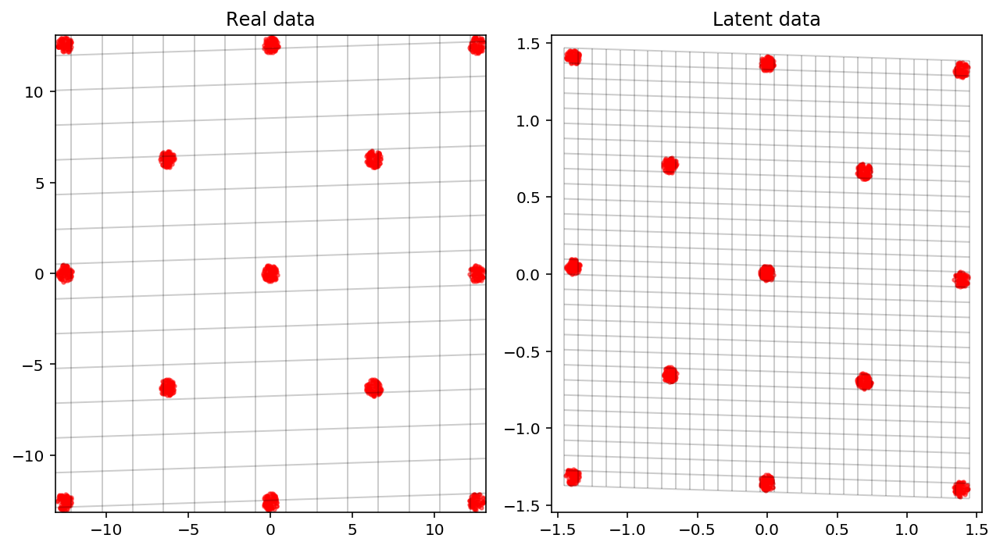

Creating directory for new run logs/test/run312
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


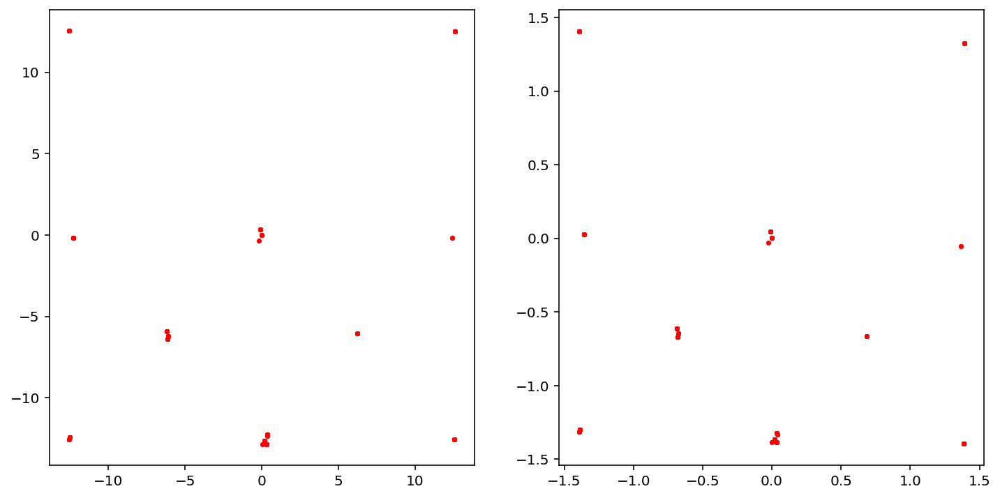

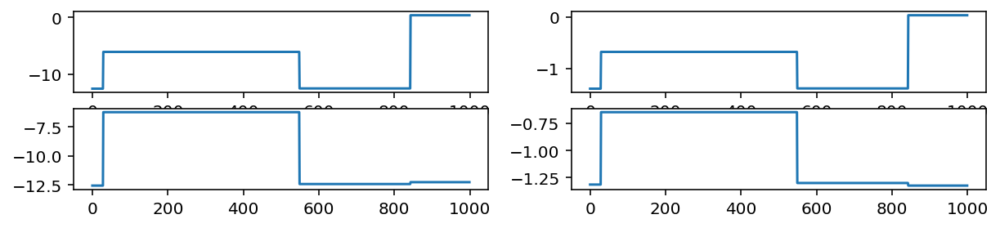

Removed no burn in
5004.9999923924615
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           3.00E-01            0.30           16691
param2           2.08E-01            0.21           24101


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        1.7084  p_{1}
param2        2.1839  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      1.84803
  2      6.93967

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.9401   0.7676   0.9458 upper
param1       0.0240   0.4007   0.7018 lower
param2       0.0019   1.1063   1.1429 upper
param2       0.0134   0.0197   0.0134 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

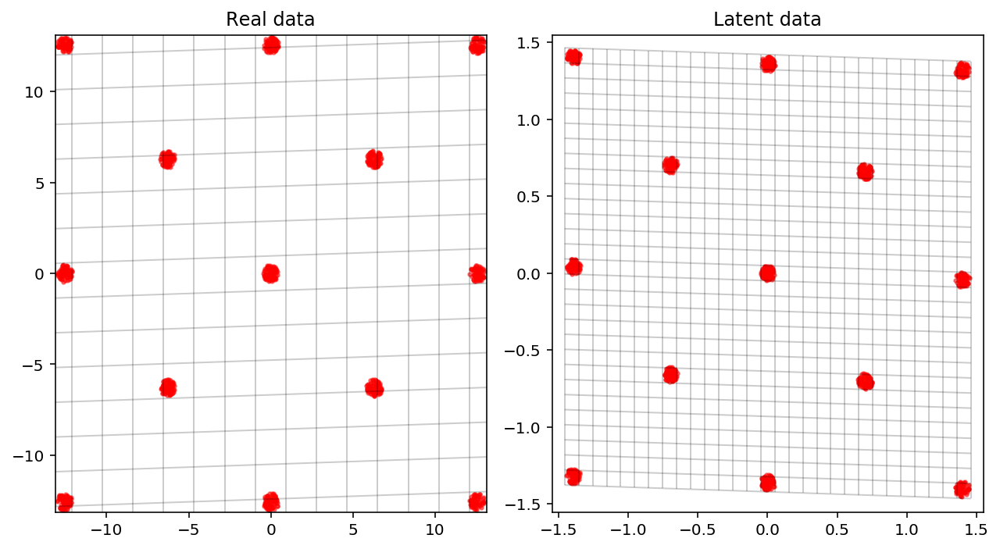

Creating directory for new run logs/test/run313
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


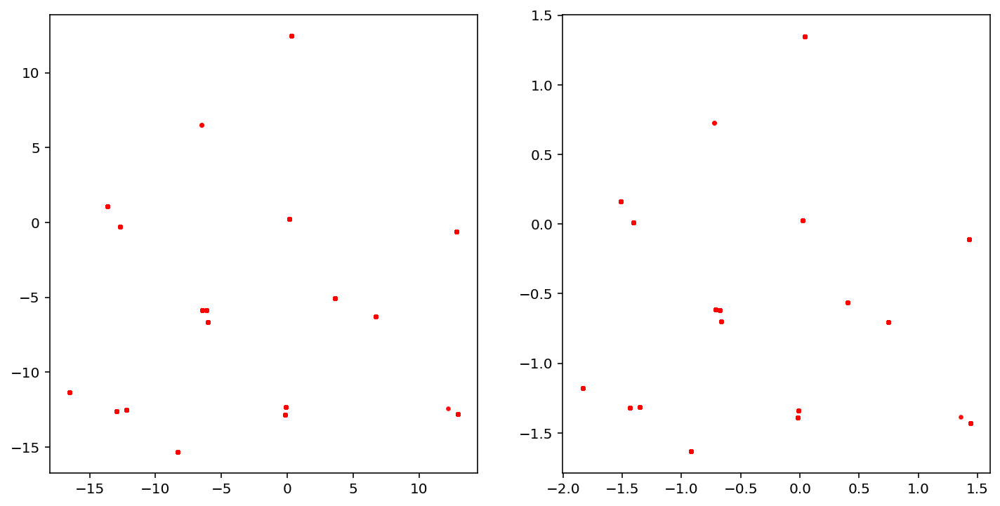

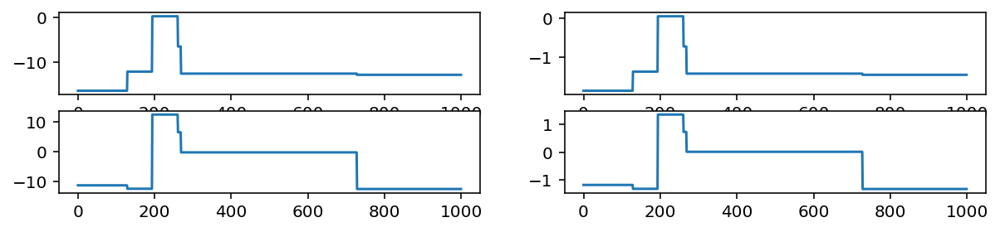

Removed no burn in
5004.999968609614
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.91E-01            0.19           26252
param2           6.08E-01            0.61            8236


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        2.3036  p_{1}
param2        0.8984  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.65465
  2      6.78763

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.8939   0.7298   1.1455 upper
param1       0.7176   0.9628   0.9761 lower
param2       1.2767   1.0512   1.0252 upper
param2       0.2765   0.2258   0.2765 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

In [21]:
model = Trainer(like.x_dim, flow='choleksy', learning_rate=0.001)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedNVP(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=2, bias=True)
        )
        (translate_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): ReLU()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): ReLU()
          (4): Linear(in_features=64, out_features=2, bias=True)
        )
      )
      (1): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=2, bias=True)
      

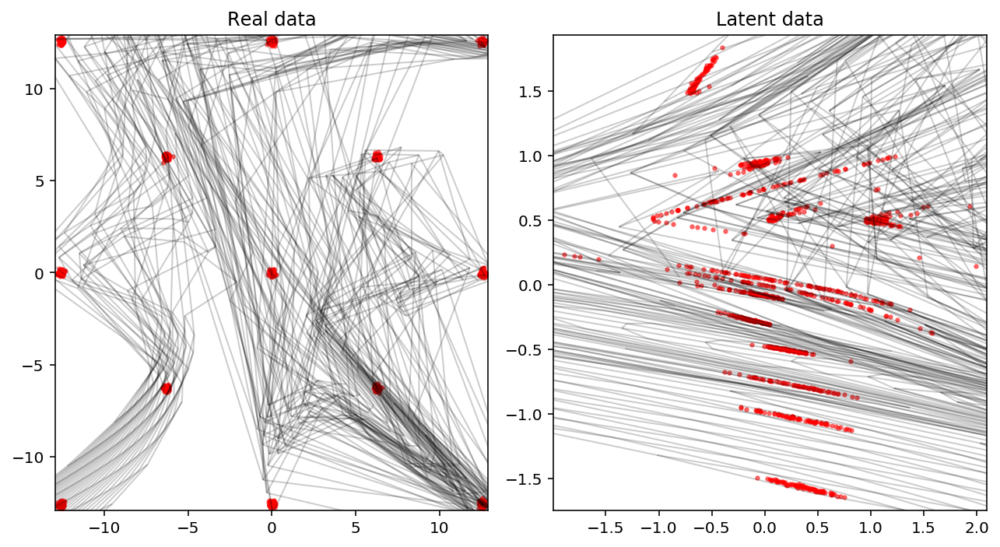

Creating directory for new run logs/test/run314
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


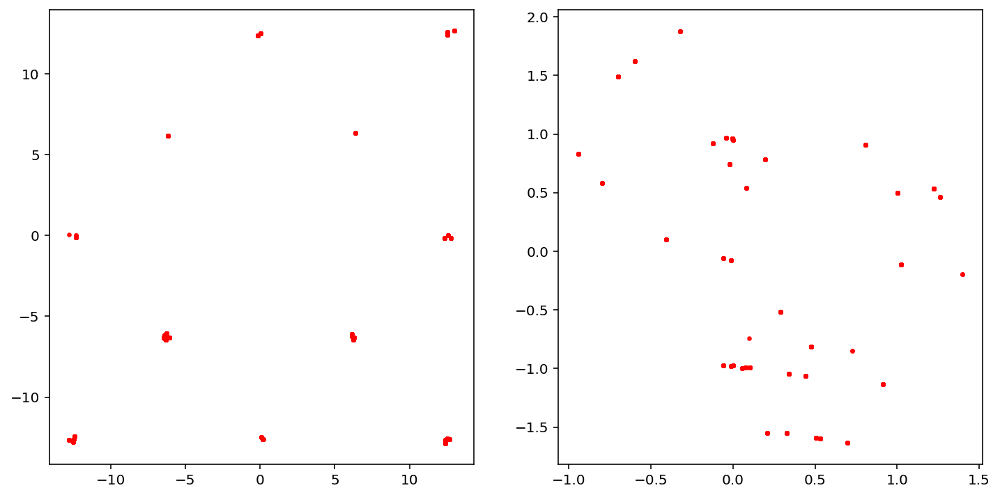

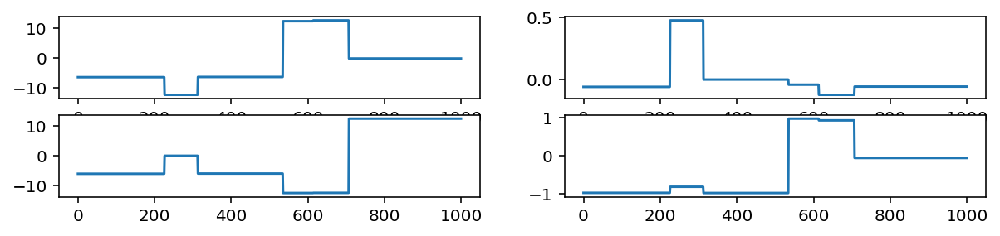

Removed no burn in
19.81425692788383
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.19E-01            0.72            6958
param2           6.72E-01            0.67            7453


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.6985  p_{1}
param2        0.7820  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.05233
  2      0.92353

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0061   0.0089   0.0089 upper
param1       0.0274   0.4054   0.3511 lower
param2       0.0150   0.0123   0.0134 upper
param2       0.0162   0.0132   0.0152 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

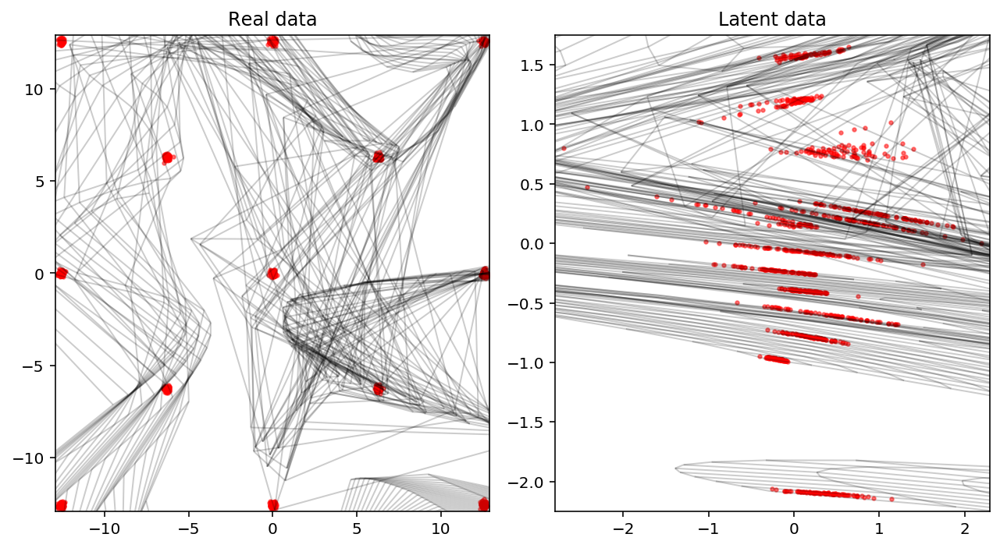

Creating directory for new run logs/test/run315
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


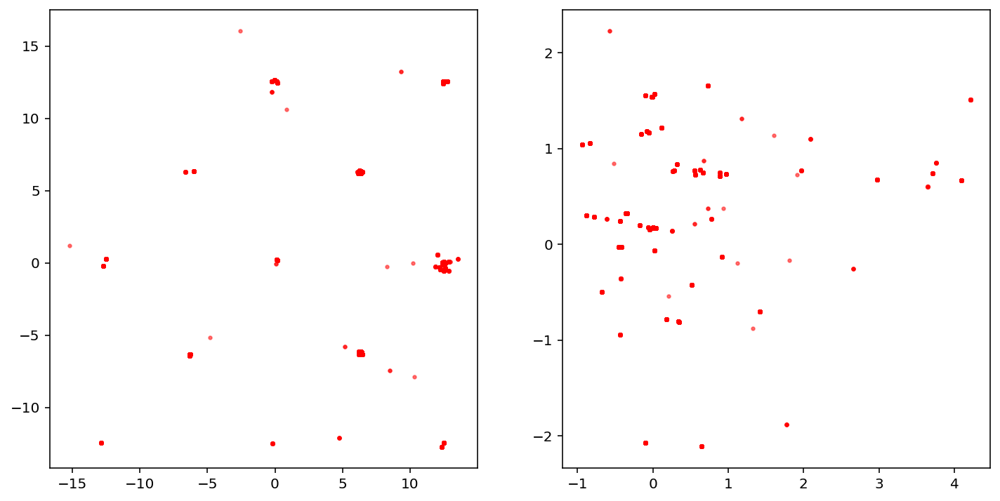

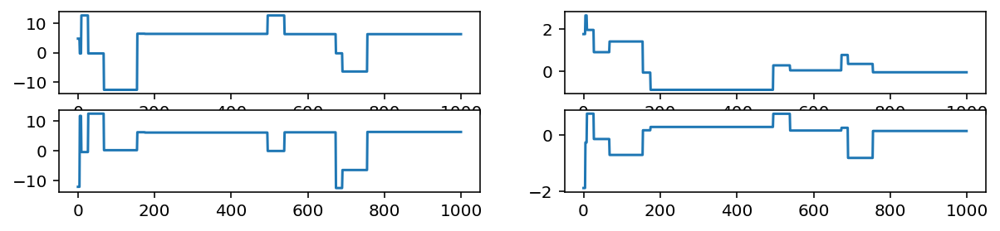

Removed no burn in
41.277451302600966
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           9.26E-01            0.93            5403
param2           9.10E-01            0.91            5501


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.3153  p_{1}
param2        0.3523  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.06138
  2      0.16616

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0031   0.0140   0.0236 upper
param1       0.6636   1.0562   1.0279 lower
param2       0.0031   0.0067   0.3927 upper
param2       0.5496   0.0280   0.6789 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

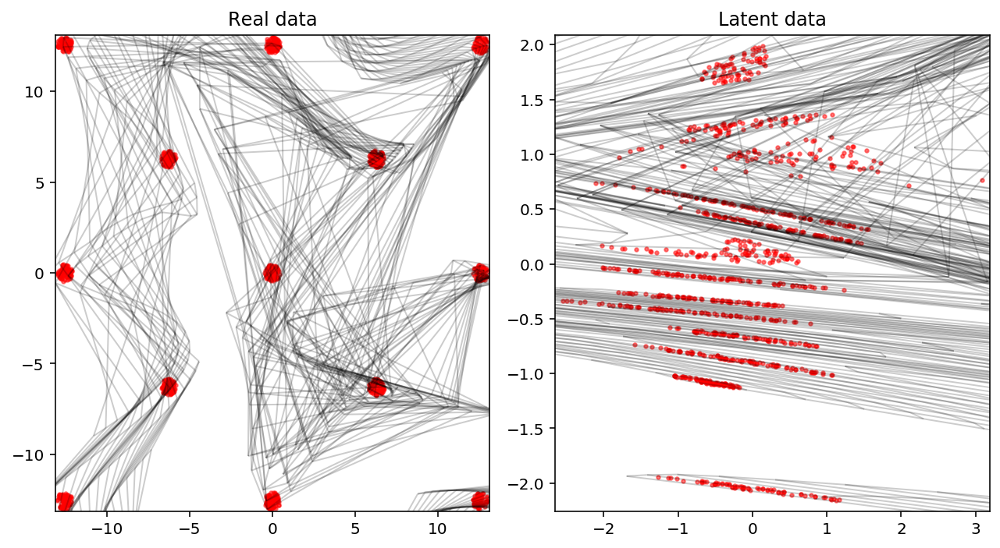

Creating directory for new run logs/test/run316
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


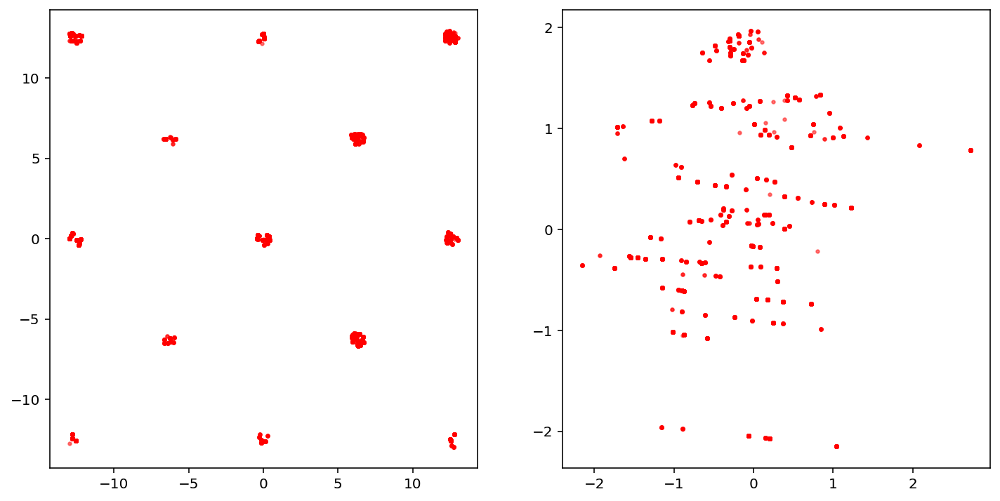

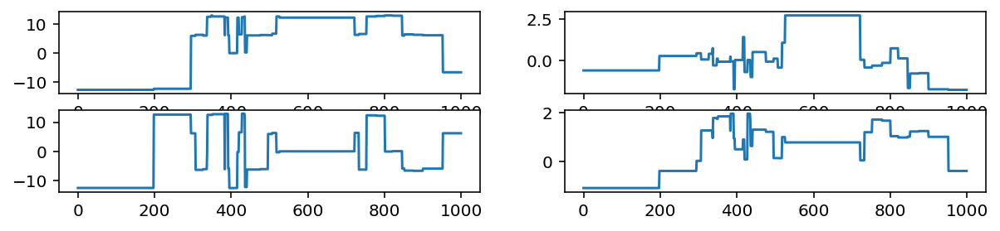

Removed no burn in
30.7815541309456
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           9.17E-01            0.92            5457
param2           9.15E-01            0.92            5469


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.3363  p_{1}
param2        0.3406  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.01616
  2      0.22228

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0068   0.0177   0.0192 upper
param1       0.0087   0.0203   0.0181 lower
param2       0.0027   0.0026   0.0023 upper
param2       0.0003   0.4166   0.3605 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enough

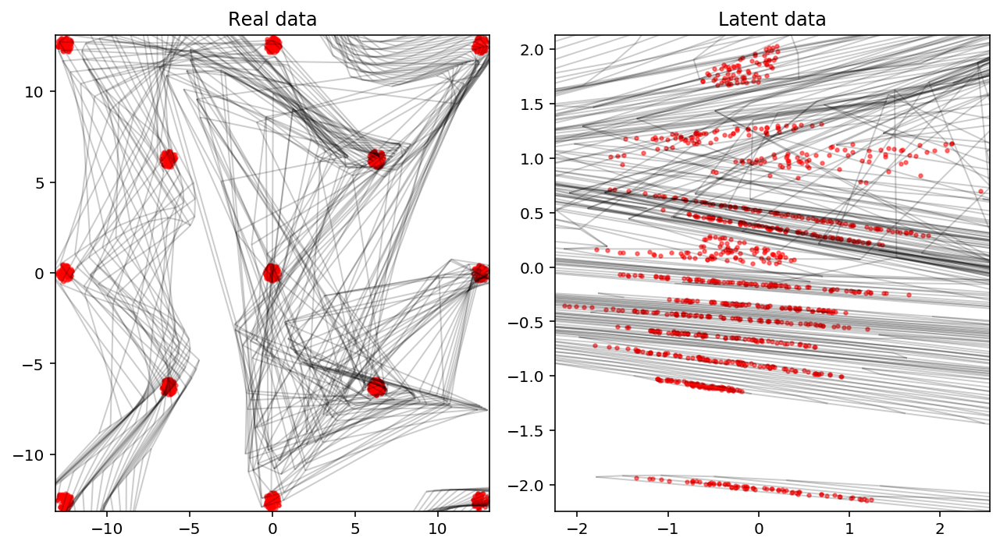

Creating directory for new run logs/test/run317
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


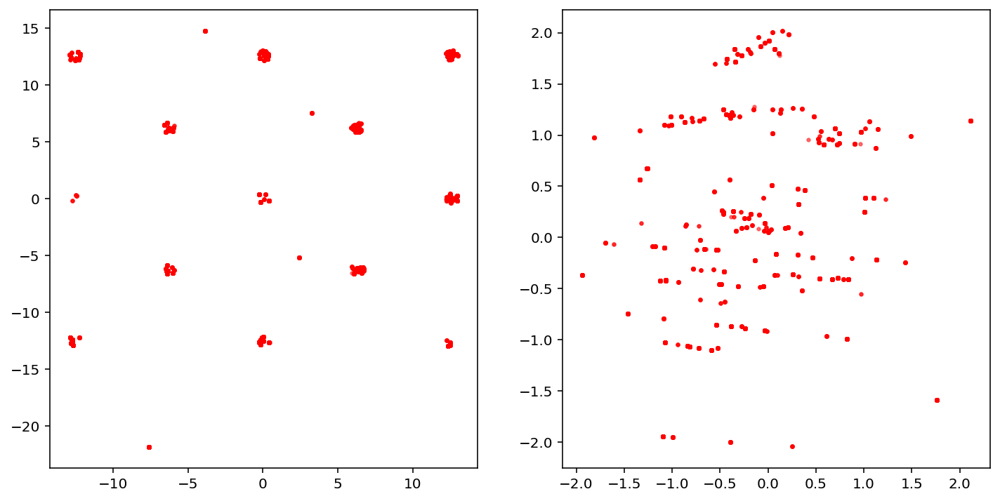

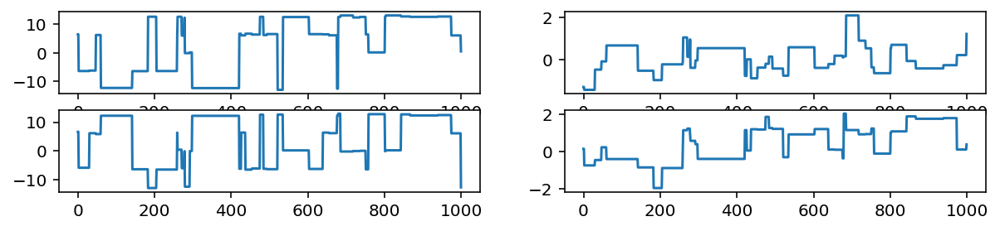

Removed no burn in
37.64805766697509
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.09E-01            0.81            6189
param2           8.92E-01            0.89            5612


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.5439  p_{1}
param2        0.3894  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.02180
  2      0.45968

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0043   0.0199   0.0232 upper
param1       0.0025   0.0096   0.0260 lower
param2       0.0039   0.0079   0.0103 upper
param2       0.6143   0.5017   0.4345 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [22]:
model = Trainer(like.x_dim, hidden_dim=64, num_blocks=5, flow='nvp', learning_rate=0.001)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedSpline(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): ActNorm()
      (1): Invertible1x1Conv()
      (2): NSF_CL(
        (f1): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
            (5): LeakyReLU(negative_slope=0.2)
            (6): Linear(in_features=16, out_features=23, bias=True)
          )
        )
        (f2): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
        

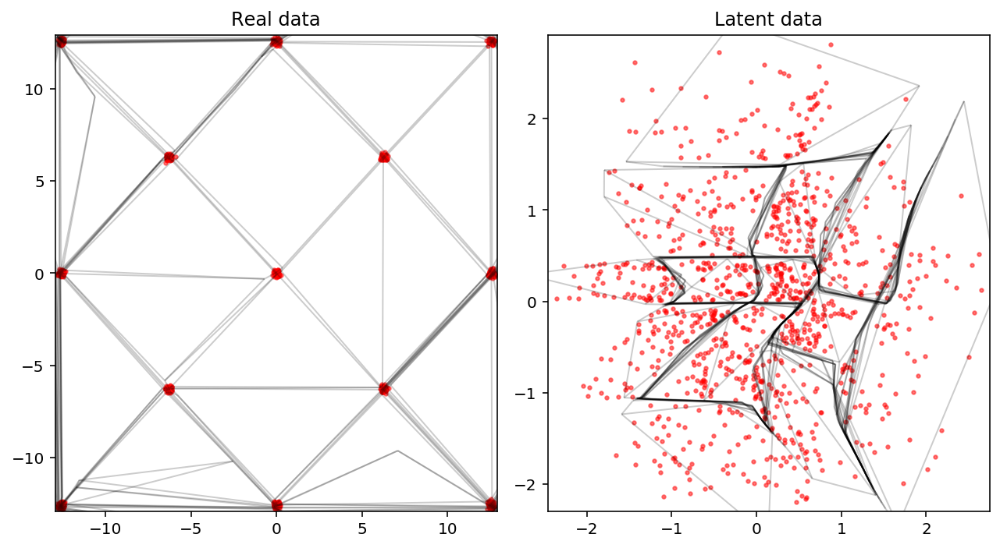

Creating directory for new run logs/test/run318
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


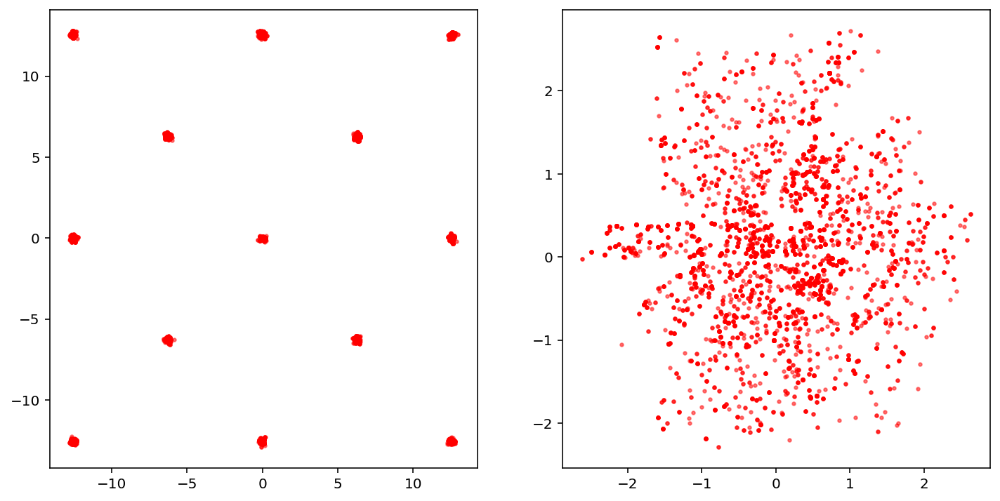

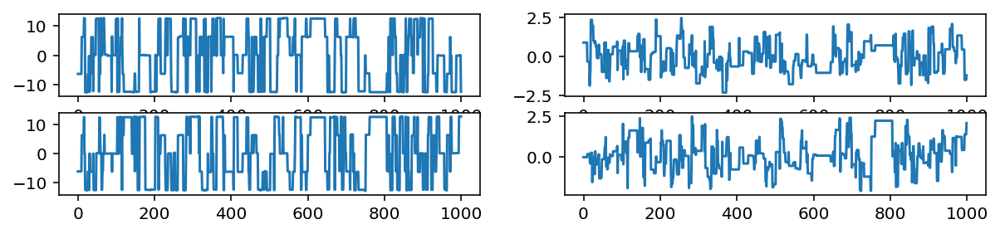

Removed no burn in
392.0924055247977
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.26E+01           12.64             395
param2           9.63E+00            9.63             519


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0838  p_{1}
param2        0.1121  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00399
  2      0.01686

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0005   0.0015   0.0005 upper
param1       0.0002   0.0006   0.0022 lower
param2       0.0004   0.0020   0.0037 upper
param2       0.0015   0.0012   0.0014 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

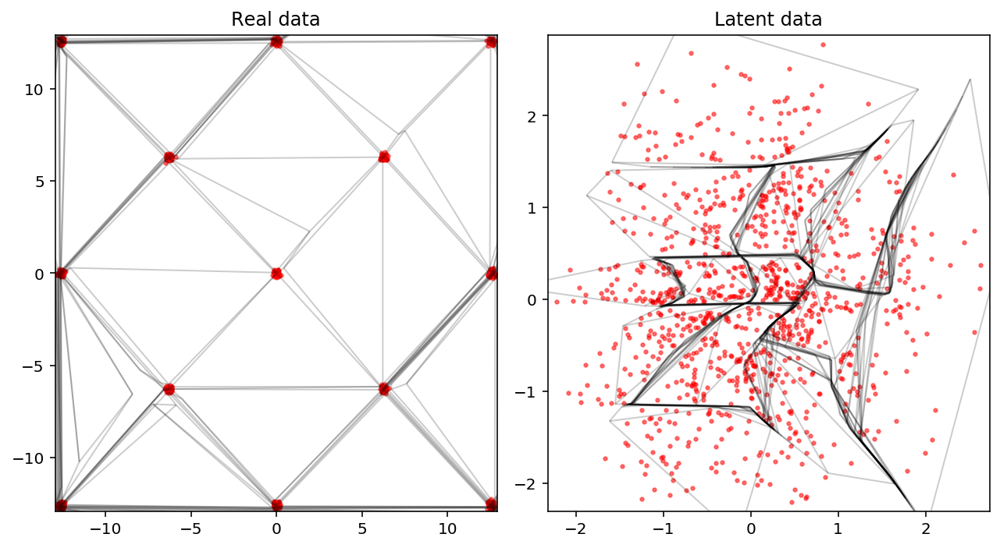

Creating directory for new run logs/test/run319
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


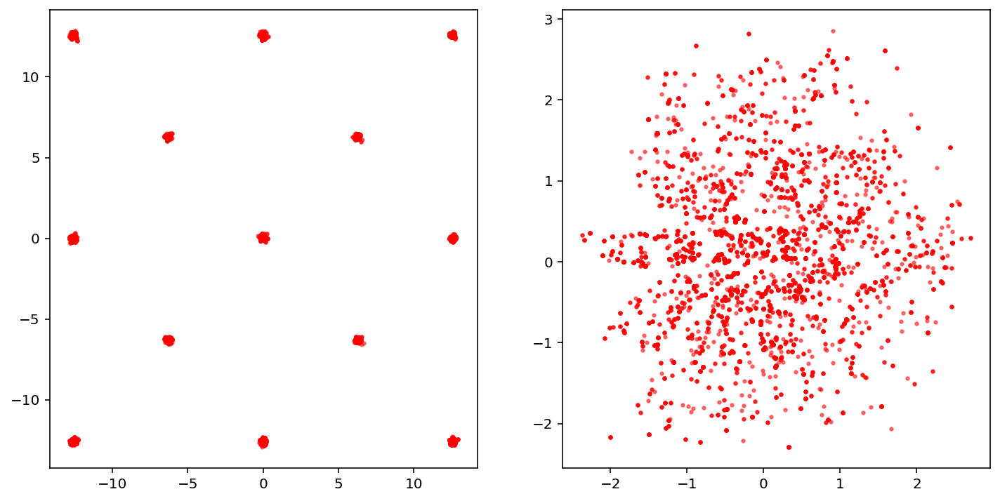

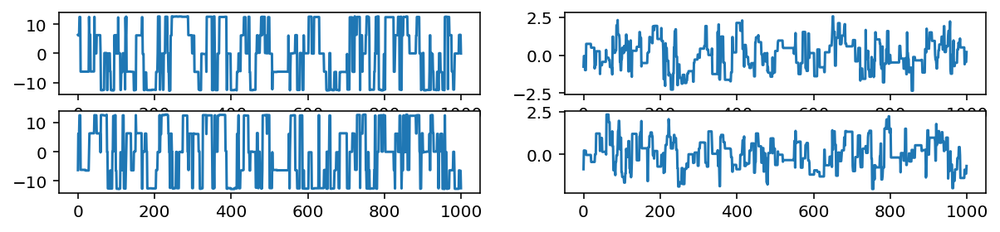

Removed no burn in
410.80384806421887
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.22E+01           12.19             410
param2           1.02E+01           10.17             492


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0291  p_{1}
param2        0.1257  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00066
  2      0.01583

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0001   0.0006   0.0007 upper
param1       0.0026   0.0014   0.0027 lower
param2       0.0006   0.0011   0.0018 upper
param2       0.0024   0.0026   0.0025 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1         

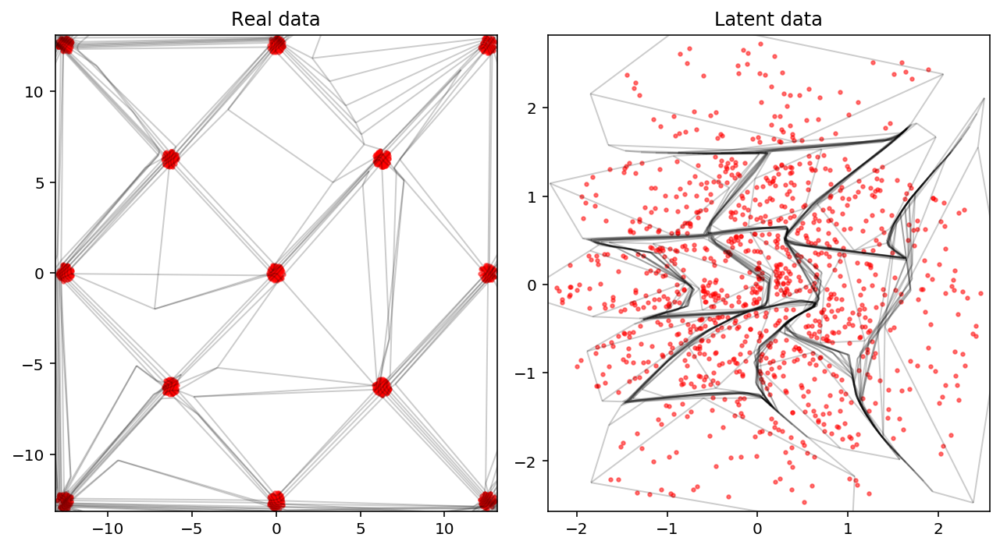

Creating directory for new run logs/test/run320
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


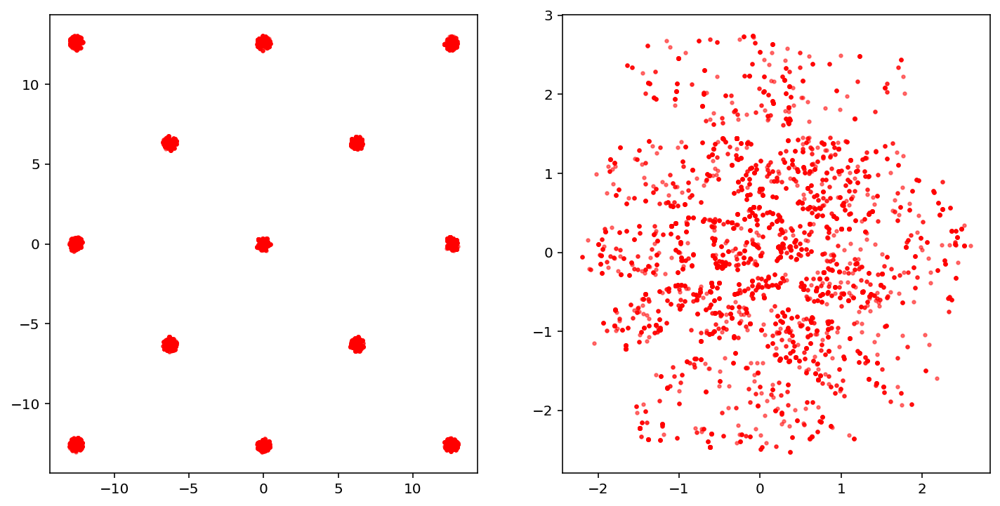

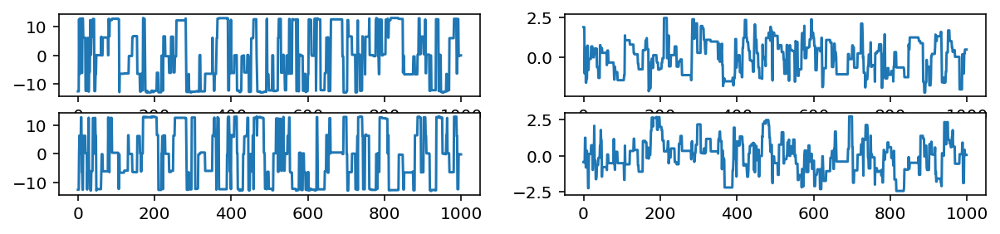

Removed no burn in
443.08002483569146
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.12E+01           11.16             448
param2           1.18E+01           11.80             424


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0727  p_{1}
param2        0.0897  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00468
  2      0.00876

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0005   0.0028   0.0032 upper
param1       0.0035   0.0051   0.0049 lower
param2       0.0009   0.0023   0.0025 upper
param2       0.0006   0.0041   0.0026 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1         

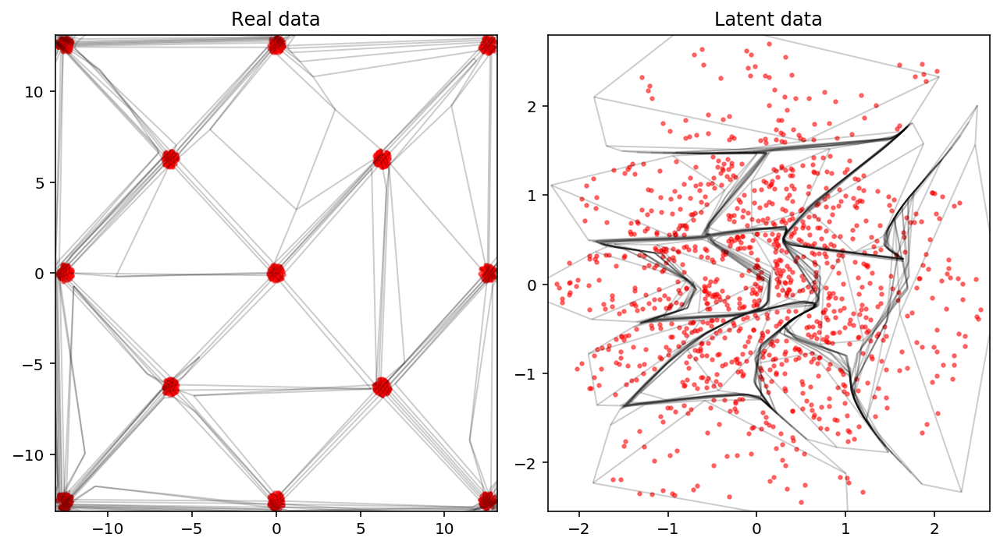

Creating directory for new run logs/test/run321
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


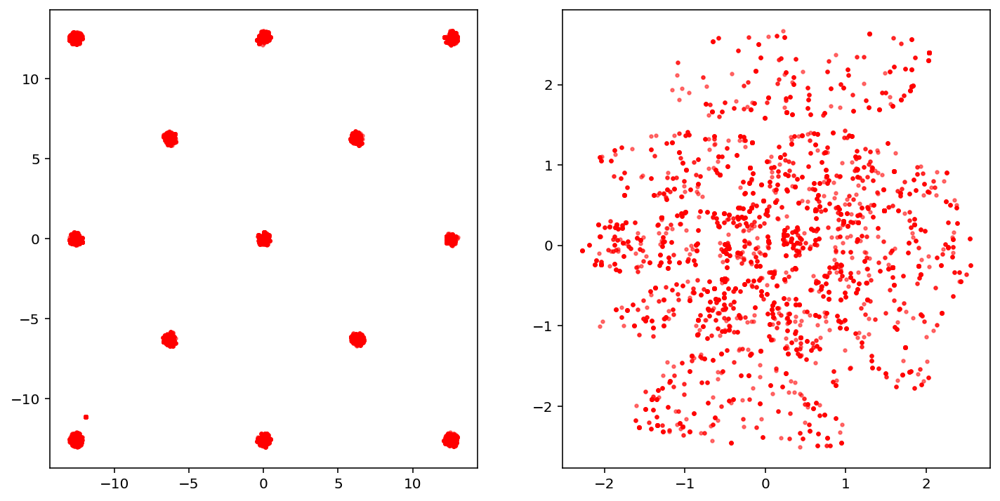

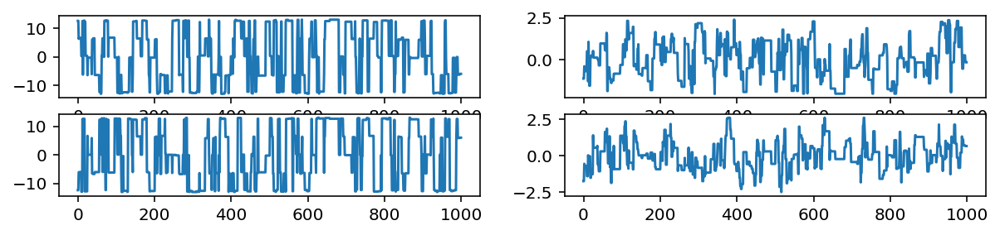

Removed no burn in
184.5275761247808
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           2.66E+01           26.57             188
param2           1.14E+01           11.38             439


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1485  p_{1}
param2        0.2220  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00914
  2      0.06069

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0033   0.0027   0.0047 upper
param1       0.0079   0.0086   0.0072 lower
param2       0.0029   0.0040   0.0035 upper
param2       0.0003   0.0048   0.0027 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [23]:
model = Trainer(like.x_dim, flow='spline', learning_rate=0.001)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

In [24]:
prior = UniformPrior(2, [-7, -3], [7, 3])
like = DoubleGaussianShell(2, centers=[[-4.0, 0.0], [4.0, 0.0]])

[nnest.trainer] [INFO] SingleSpeedCholeksy(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): Choleksy()
    )
  )
)
[nnest.trainer] [INFO] Number of network params: [5]
[nnest.trainer] [INFO] Device [cpu]
[nnest.trainer] [INFO] Number of training samples [1000]
[nnest.trainer] [INFO] Training jitter [0.0010]
[nnest.trainer] [INFO] Epoch [1] train loss [0.1224] validation loss [0.1174]
[nnest.trainer] [INFO] Epoch [100] train loss [0.0668] validation loss [0.0650]
[nnest.trainer] [INFO] Epoch [200] train loss [0.0524] validation loss [0.0515]
[nnest.trainer] [INFO] Epoch [300] train loss [0.0481] validation loss [0.0476]
[nnest.trainer] [INFO] Epoch [400] train loss [0.0470] validation loss [0.0466]
[nnest.trainer] [INFO] Epoch [500] train loss [0.0467] validation loss [0.0464]
[nnest.trainer] [INFO] Epoch [600] train loss [0.0467] validation loss [0.0464]
[nnest.trainer] [INFO] Epoch [601] ran out of patience
[nnest.trainer] [INFO] Best epoch [551] validation loss [0.0464

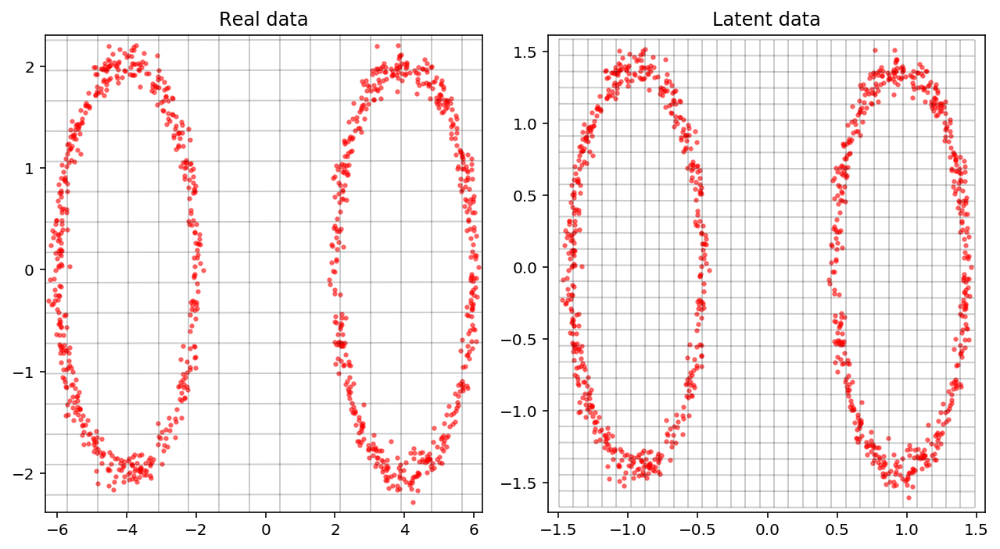

Creating directory for new run logs/test/run322
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


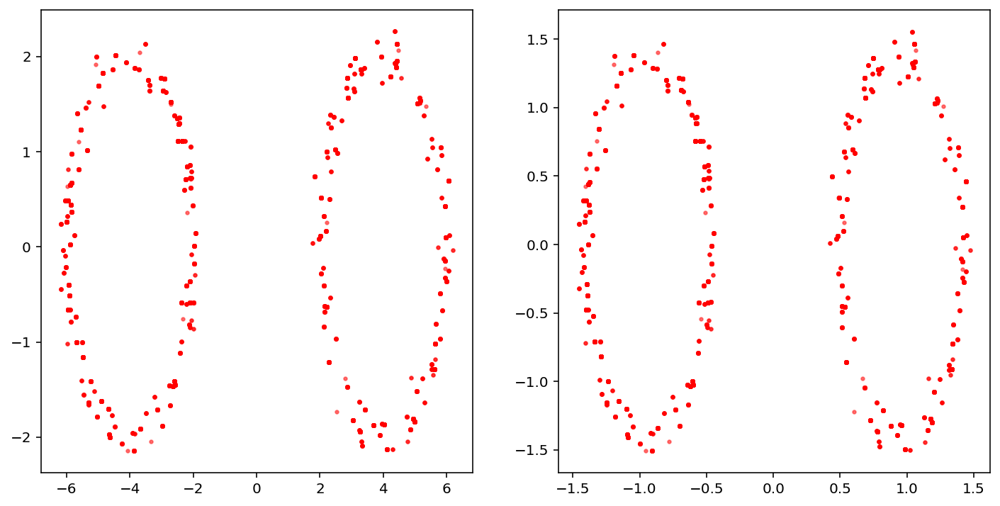

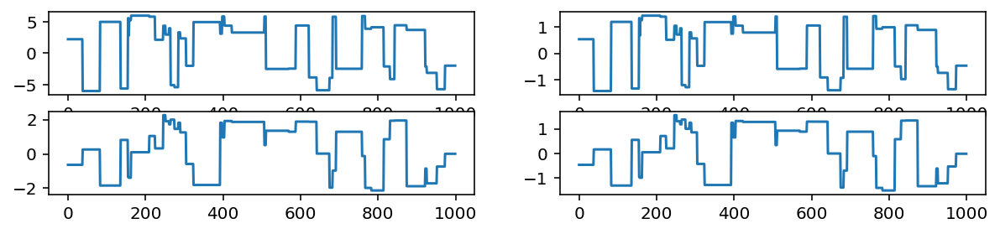

Removed no burn in
63.04036422437374
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           9.67E-01            0.97            5173
param2           4.85E+01           48.47             103


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.2050  p_{1}
param2        0.1356  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.01595
  2      0.04461

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0162   0.0132   0.0400 upper
param1       0.0097   0.0081   0.0104 lower
param2       0.0029   0.0597   0.0972 upper
param2       0.0349   0.0665   0.0611 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

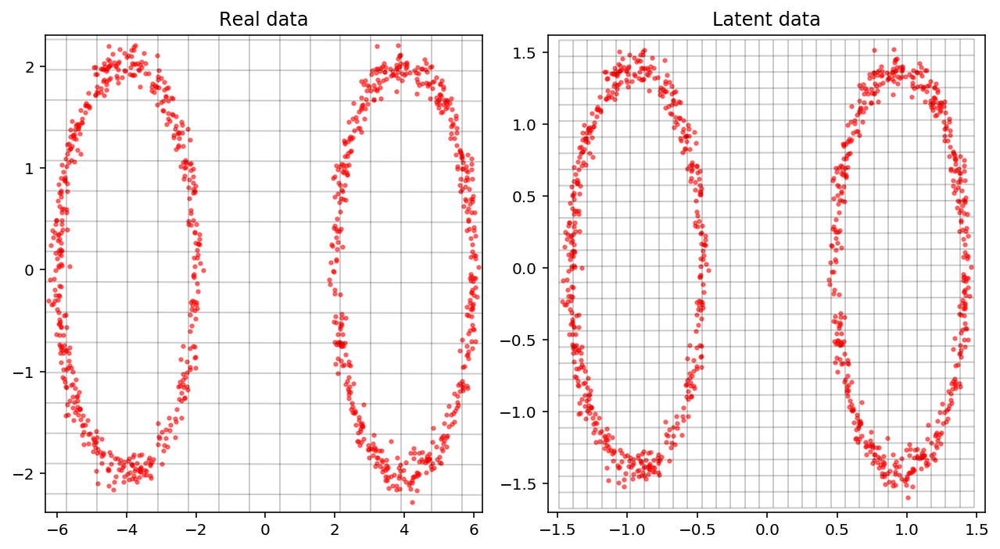

Creating directory for new run logs/test/run323
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


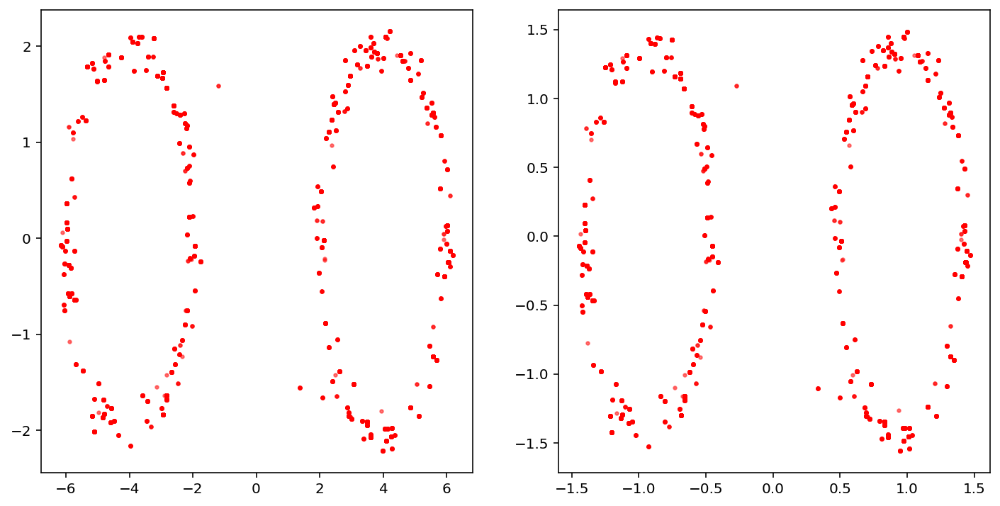

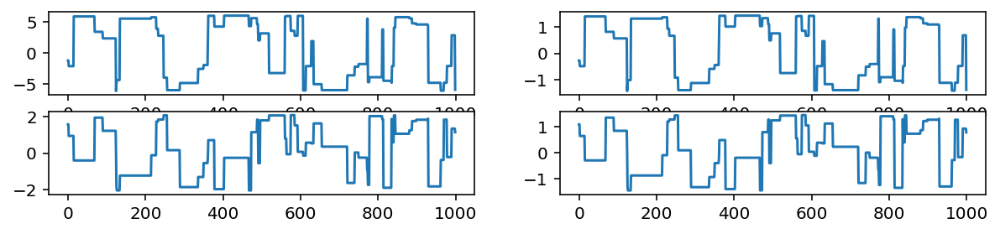

Removed no burn in
89.79202192196293
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           4.84E+01           48.41             103
param2           5.53E+01           55.26              90


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.2583  p_{1}
param2        0.0944  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00545
  2      0.06918

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0085   0.0065   0.0575 upper
param1       0.0115   0.0183   0.0159 lower
param2       0.0080   0.0686   0.0595 upper
param2       0.0198   0.0624   0.0466 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

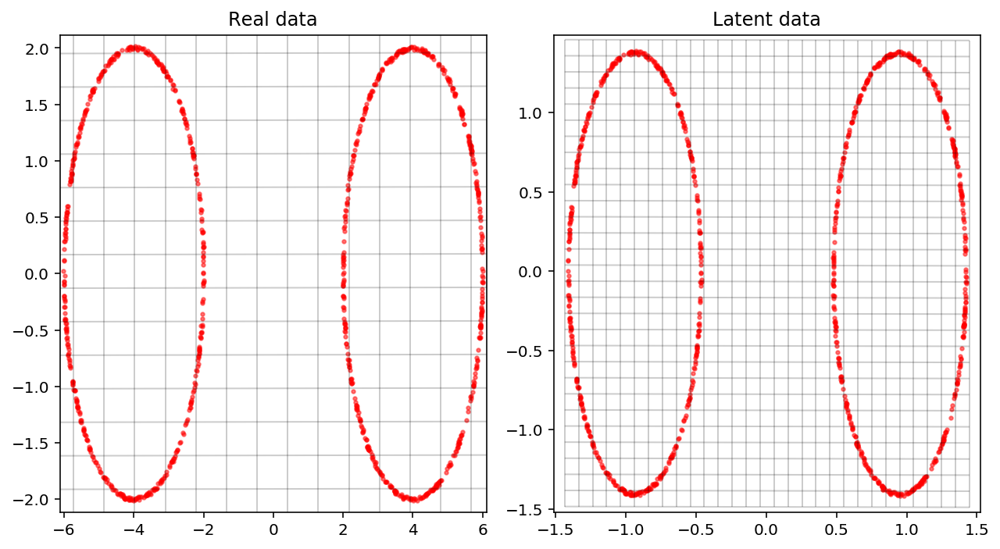

Creating directory for new run logs/test/run324
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


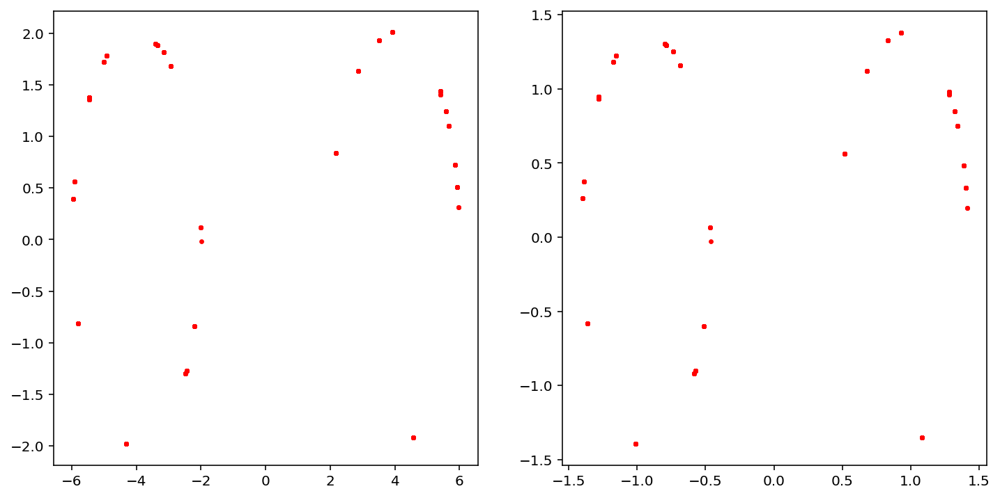

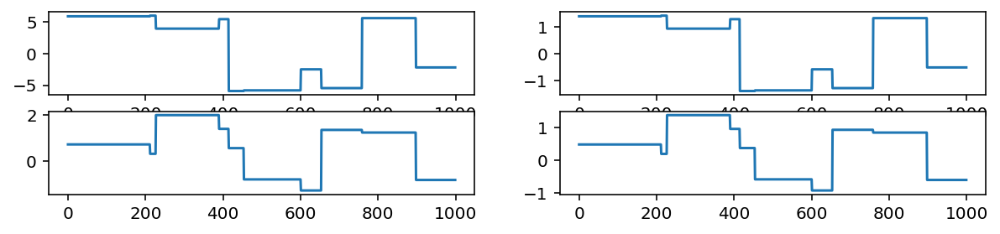

Removed no burn in
20.543862225388235
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.42E-01            0.84            5944
param2           1.57E-01            0.16           31947


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.4845  p_{1}
param2        2.5940  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.22677
  2      7.03073

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0109   0.0255   0.1442 upper
param1       0.0602   0.1055   0.1001 lower
param2       0.0389   0.0449   0.1227 upper
param2       1.2253   1.0004   1.3806 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

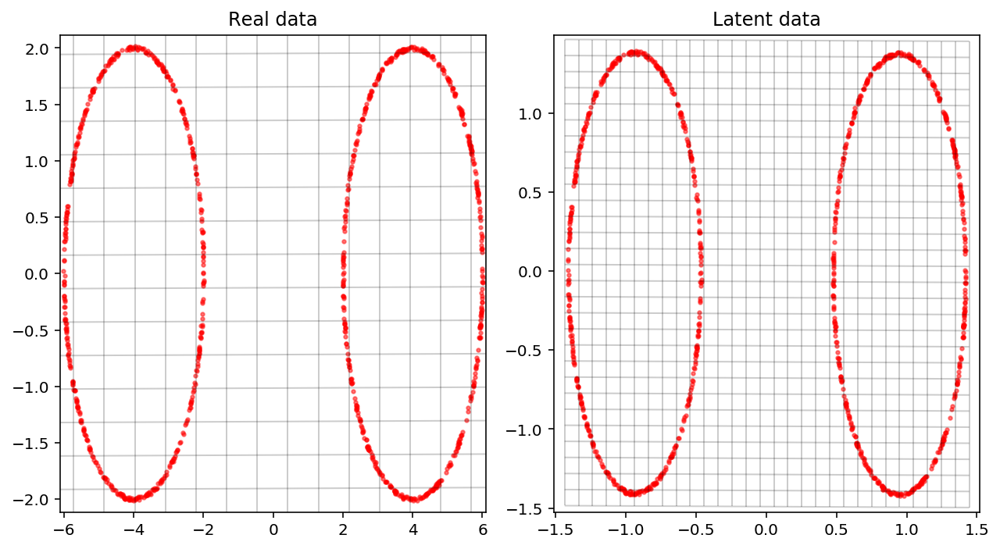

Creating directory for new run logs/test/run325
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


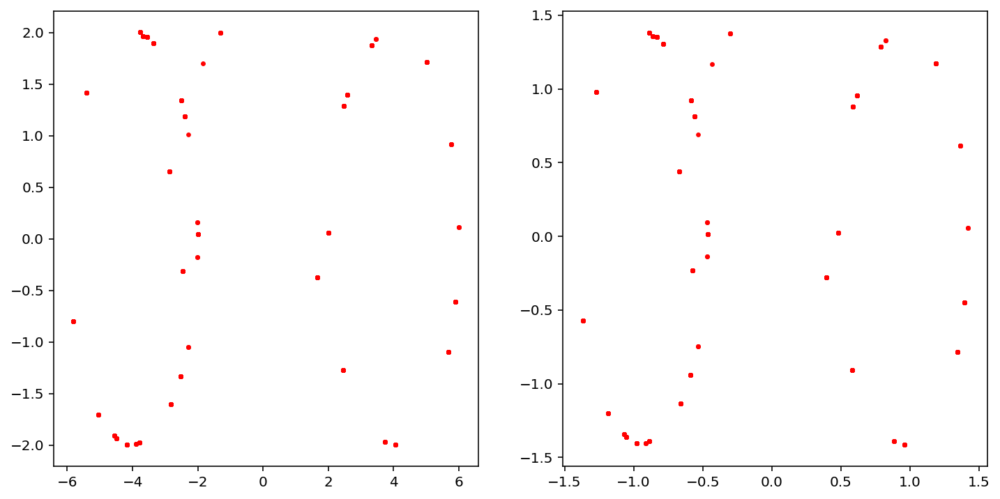

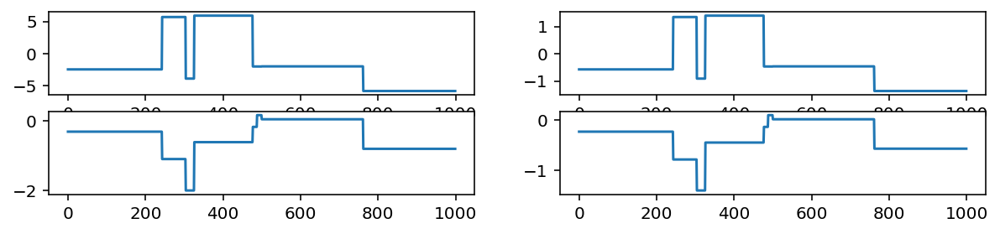

Removed no burn in
15.957197836121376
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.49E-01            0.65            7706
param2           6.61E-01            0.66            7569


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.8213  p_{1}
param2        0.8003  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.12670
  2      1.18406

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.1681   0.3213   0.1691 upper
param1       0.2528   0.3807   0.2143 lower
param2       0.0164   0.2875   0.3255 upper
param2       0.3273   1.3473   0.3155 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

In [25]:
model = Trainer(like.x_dim, flow='choleksy', learning_rate=0.001)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedNVP(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=2, bias=True)
        )
        (translate_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): ReLU()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): ReLU()
          (4): Linear(in_features=64, out_features=2, bias=True)
        )
      )
      (1): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=2, bias=True)
      

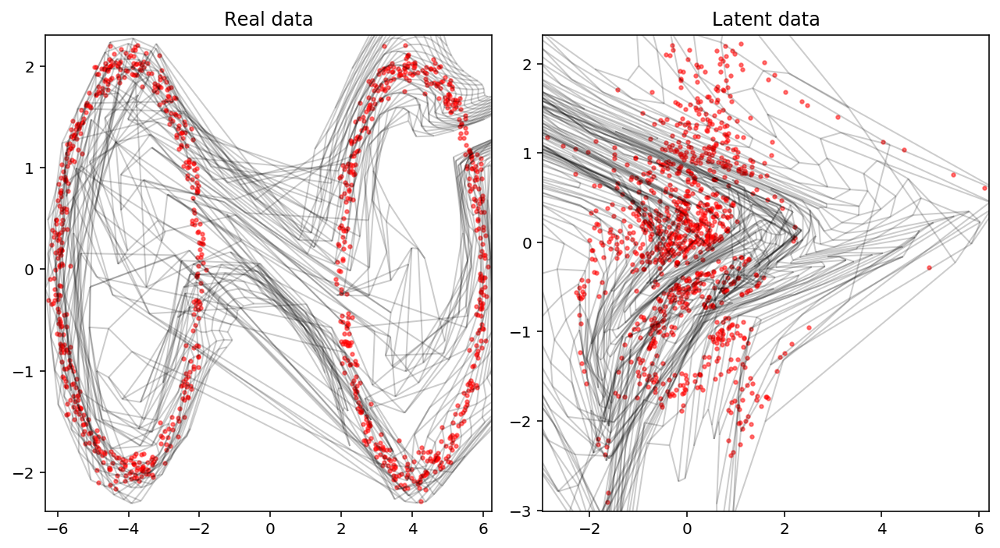

Creating directory for new run logs/test/run326
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


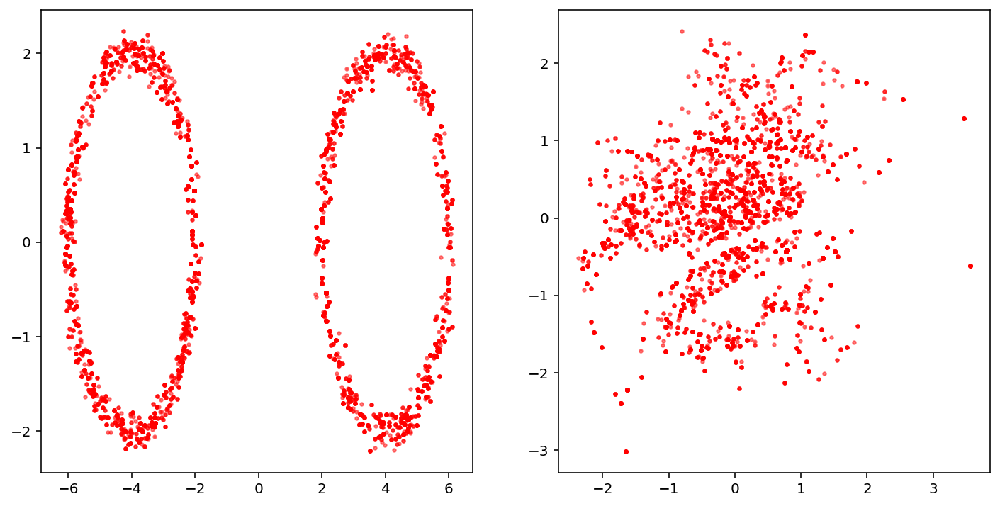

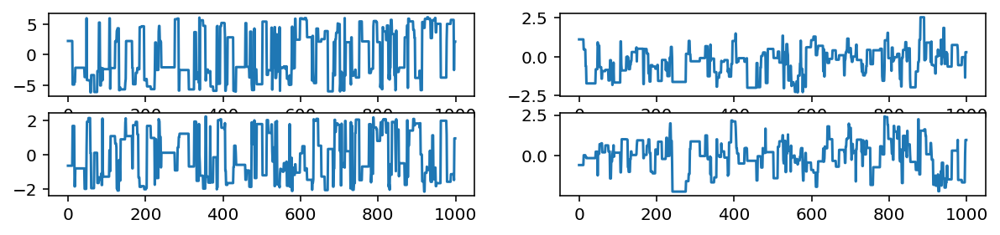

Removed no burn in
515.274112615313
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           9.32E+00            9.32             537
param2           1.06E+01           10.62             471


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1276  p_{1}
param2        0.0779  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00088
  2      0.02251

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0001   0.0057   0.0194 upper
param1       0.0014   0.0080   0.0118 lower
param2       0.0061   0.0257   0.0238 upper
param2       0.0142   0.0178   0.0176 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1           

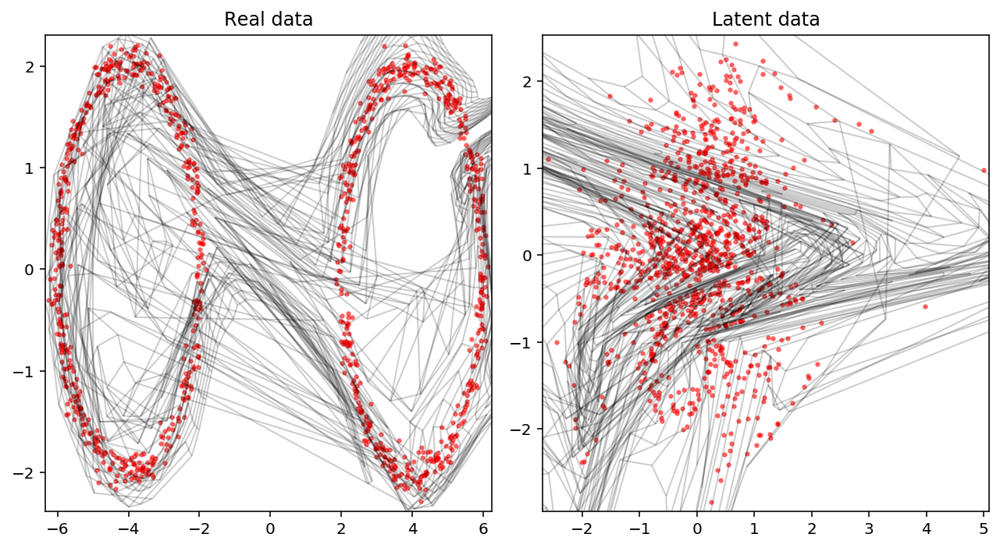

Creating directory for new run logs/test/run327
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


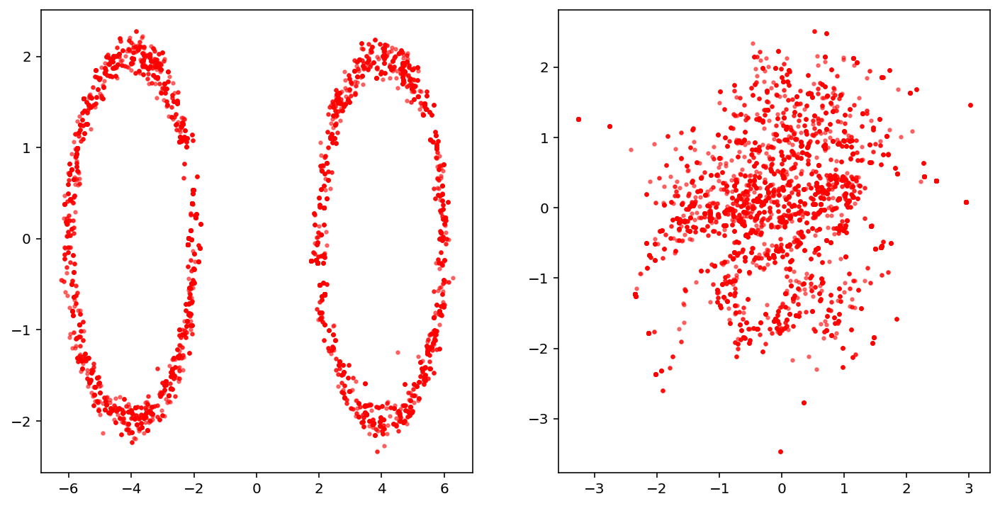

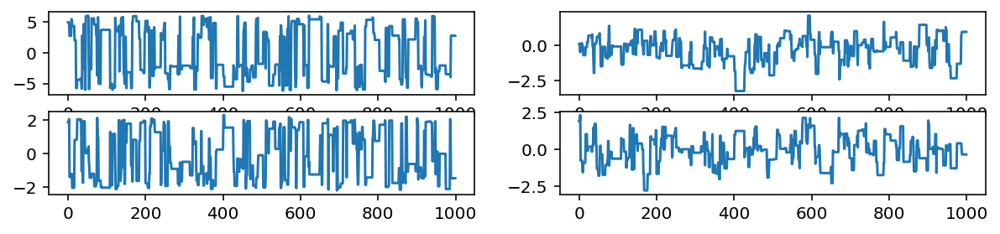

Removed no burn in
589.7952225228514
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.45E+00            8.45             591
param2           8.89E+00            8.89             562


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0735  p_{1}
param2        0.0553  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00212
  2      0.00644

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0066   0.0054   0.0062 upper
param1       0.0085   0.0090   0.0068 lower
param2       0.0105   0.0206   0.0109 upper
param2       0.0007   0.0108   0.0268 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

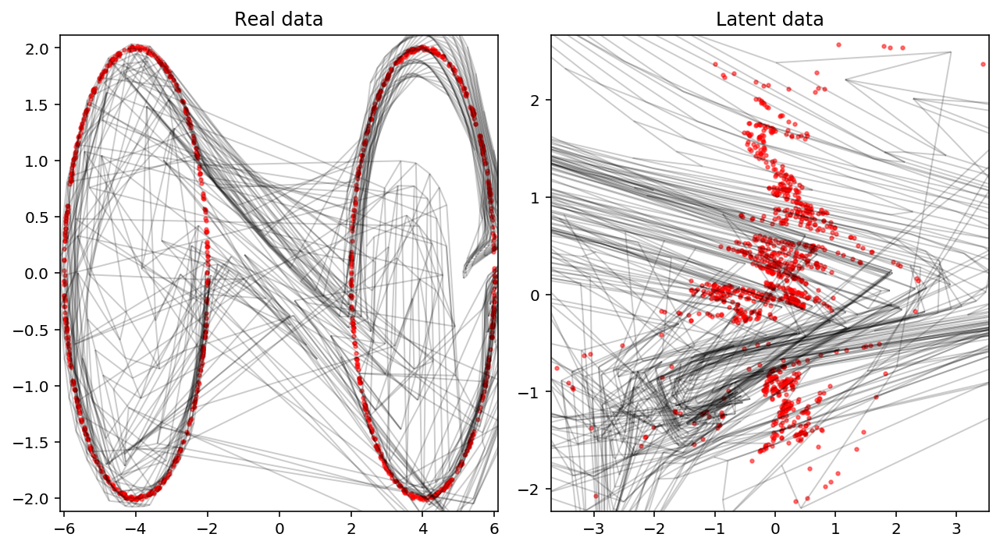

Creating directory for new run logs/test/run328
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


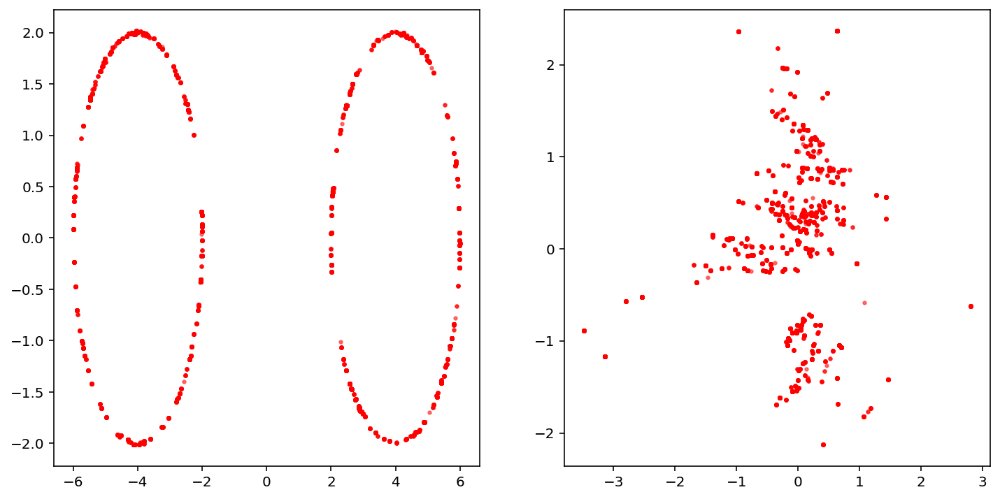

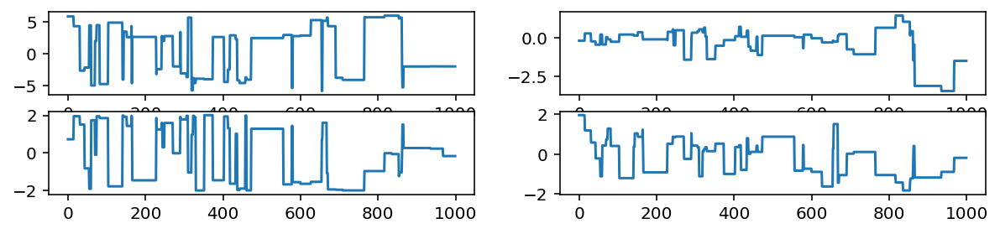

Removed no burn in
113.40920096690593
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           3.47E+01           34.68             144
param2           3.19E+01           31.93             156


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.3112  p_{1}
param2        0.1972  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.01916
  2      0.11107

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0035   0.0084   0.0076 upper
param1       0.0046   0.0683   0.1141 lower
param2       0.0036   0.0051   0.0044 upper
param2       0.0168   0.0303   0.0563 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1         

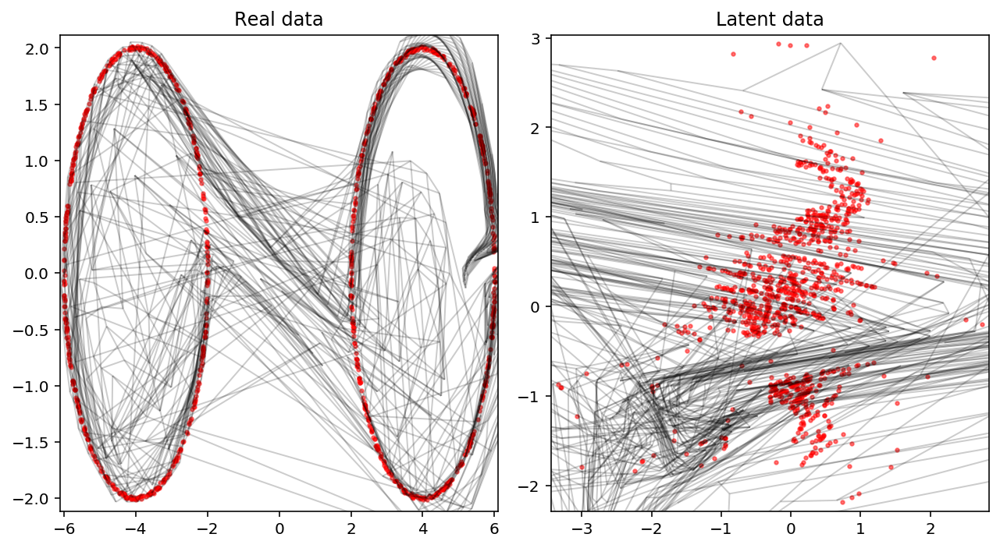

Creating directory for new run logs/test/run329
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


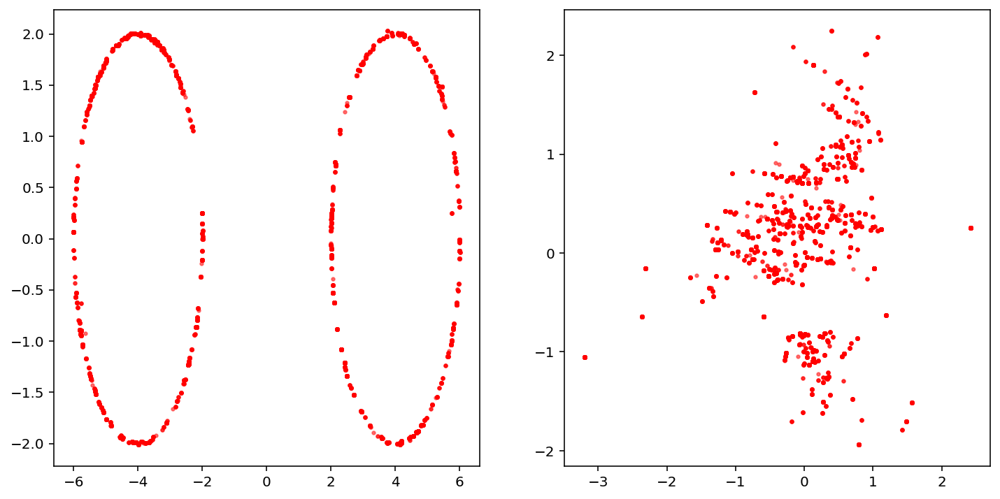

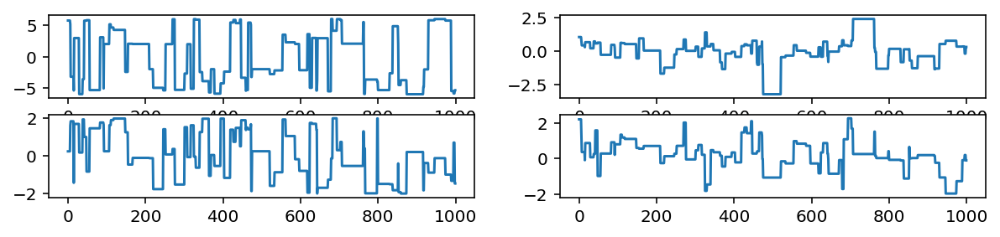

Removed no burn in
196.1994508669176
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           2.52E+01           25.20             198
param2           2.53E+01           25.29             197


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0870  p_{1}
param2        0.1742  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00444
  2      0.03502

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0285   0.0290   0.0313 upper
param1       0.0053   0.0339   0.0389 lower
param2       0.0010   0.0032   0.0040 upper
param2       0.0045   0.0037   0.0148 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

In [26]:
model = Trainer(like.x_dim, hidden_dim=64, num_blocks=5, flow='nvp', learning_rate=0.001)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedSpline(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): ActNorm()
      (1): Invertible1x1Conv()
      (2): NSF_CL(
        (f1): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
            (5): LeakyReLU(negative_slope=0.2)
            (6): Linear(in_features=16, out_features=23, bias=True)
          )
        )
        (f2): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
        

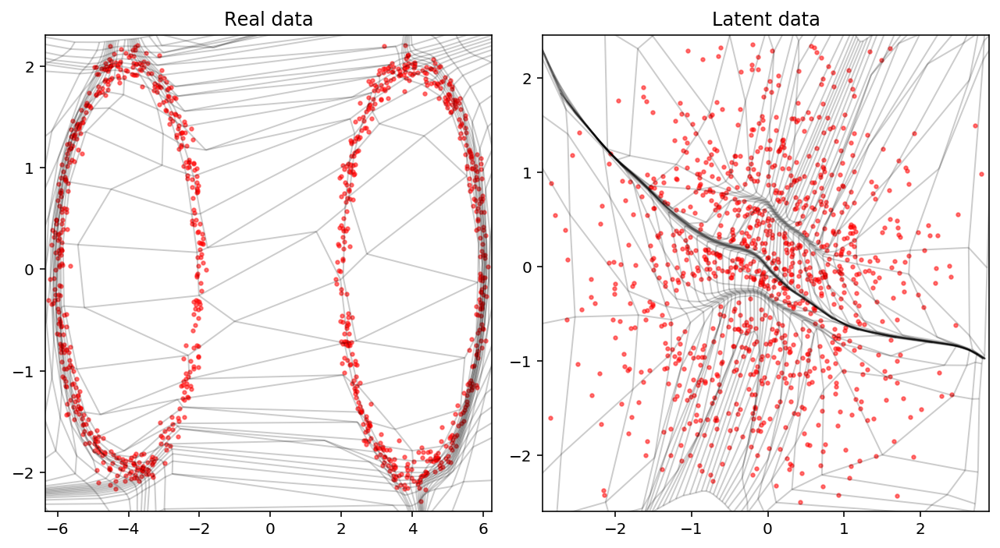

Creating directory for new run logs/test/run330
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


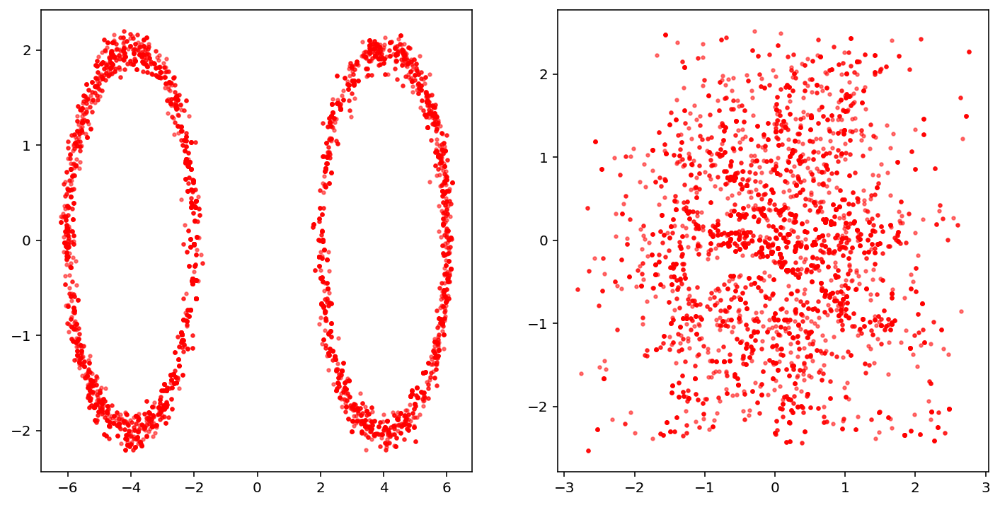

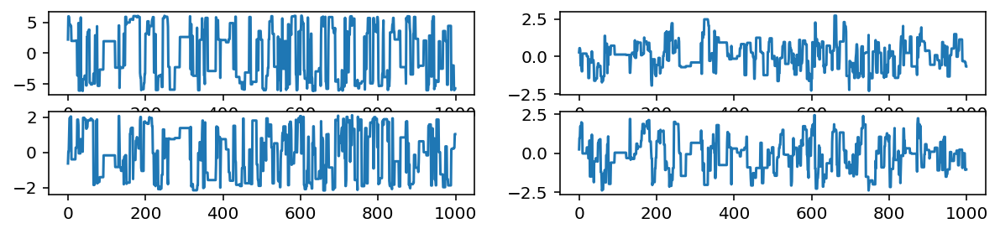

Removed no burn in
608.8262345009298
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.14E+00            8.14             614
param2           8.39E+00            8.39             596


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0735  p_{1}
param2        0.0838  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00378
  2      0.00857

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0054   0.0073   0.0077 upper
param1       0.0012   0.0118   0.0127 lower
param2       0.0066   0.0117   0.0213 upper
param2       0.0125   0.0145   0.0209 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

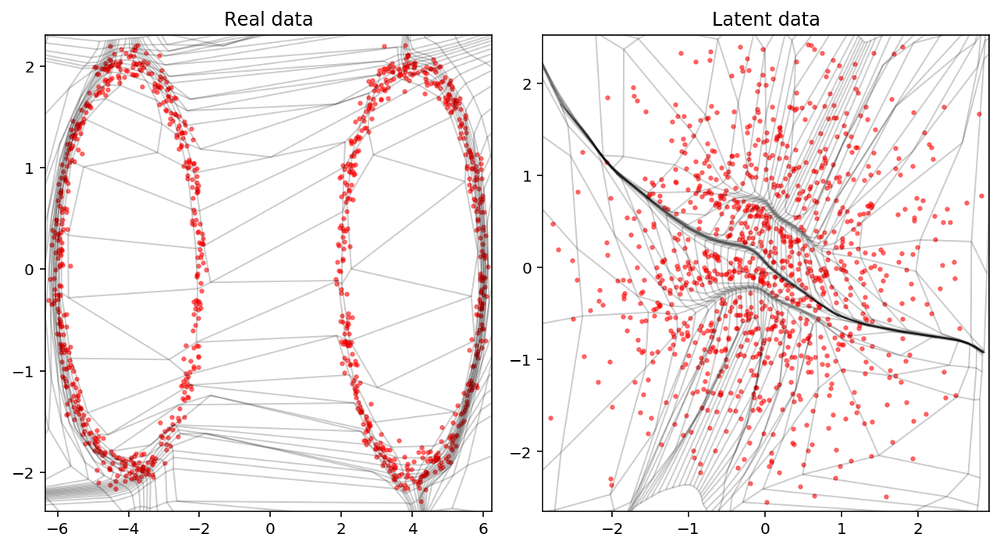

Creating directory for new run logs/test/run331
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


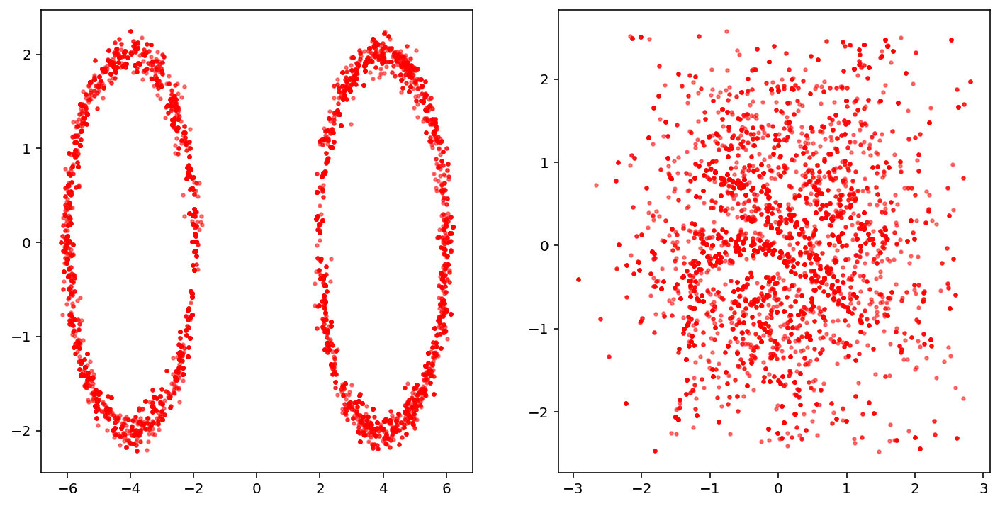

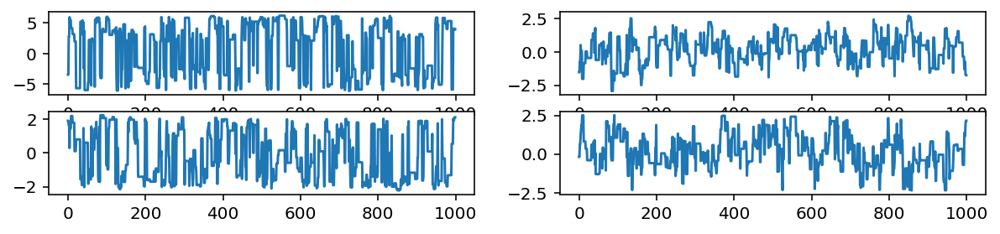

Removed no burn in
662.5187827262149
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.22E+00            7.22             692
param2           7.73E+00            7.73             647


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1193  p_{1}
param2        0.0700  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00101
  2      0.01784

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0139   0.0146   0.0212 upper
param1       0.0058   0.0063   0.0076 lower
param2       0.0026   0.0100   0.0138 upper
param2       0.0032   0.0108   0.0148 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

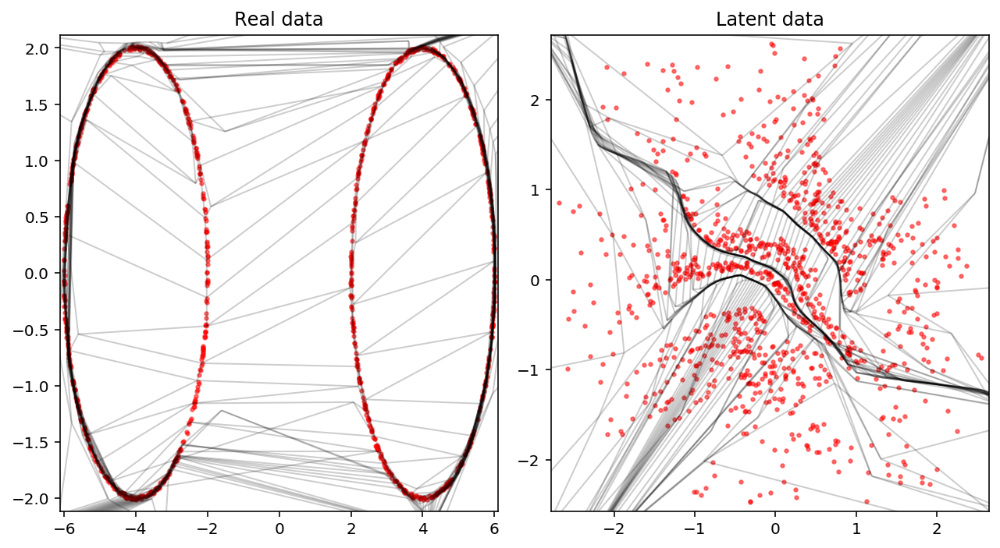

Creating directory for new run logs/test/run332
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


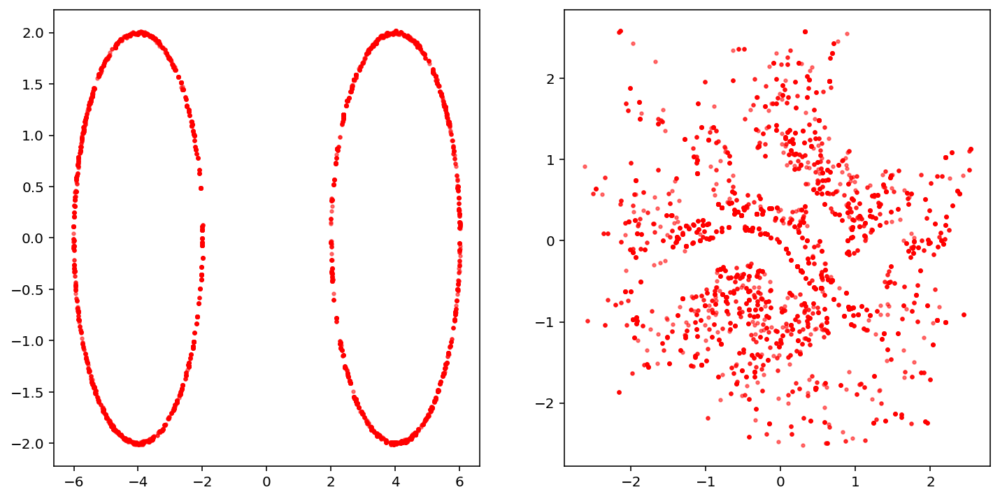

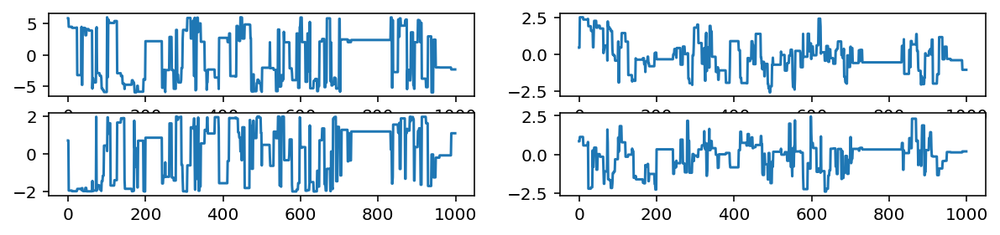

Removed no burn in
346.2563302335713
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.39E+01           13.90             360
param2           1.47E+01           14.73             339


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1280  p_{1}
param2        0.1191  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.01112
  2      0.01966

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0054   0.0097   0.0121 upper
param1       0.0001   0.0079   0.0113 lower
param2       0.0022   0.0072   0.0044 upper
param2       0.0028   0.0028   0.0021 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

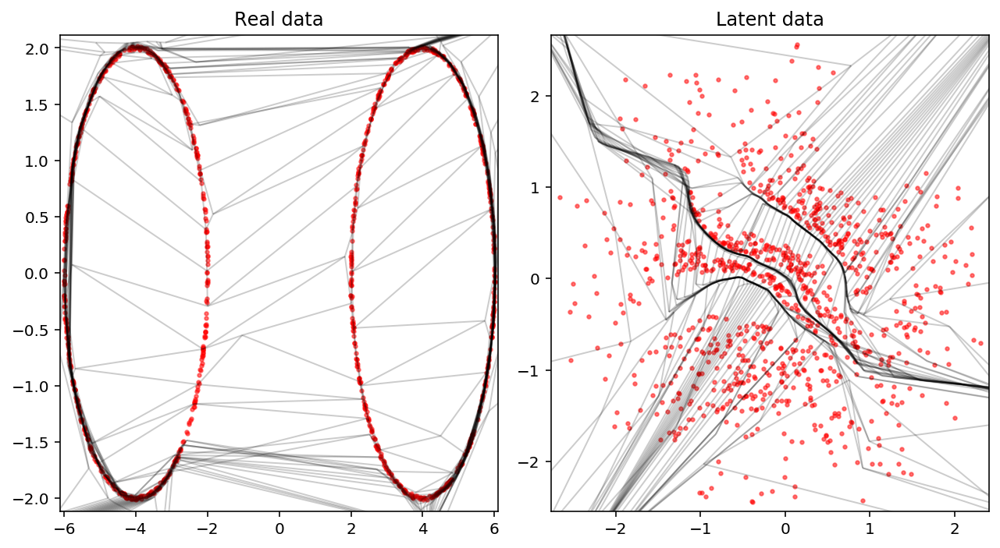

Creating directory for new run logs/test/run333
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


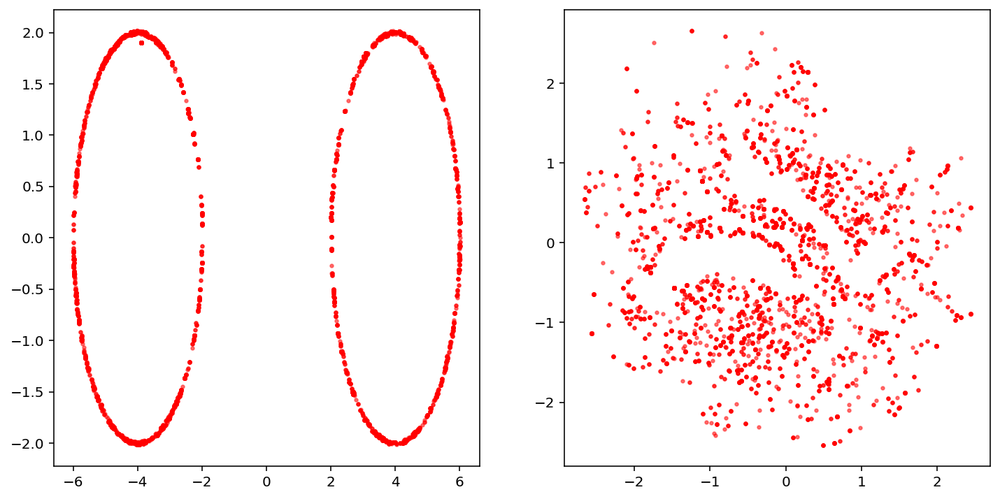

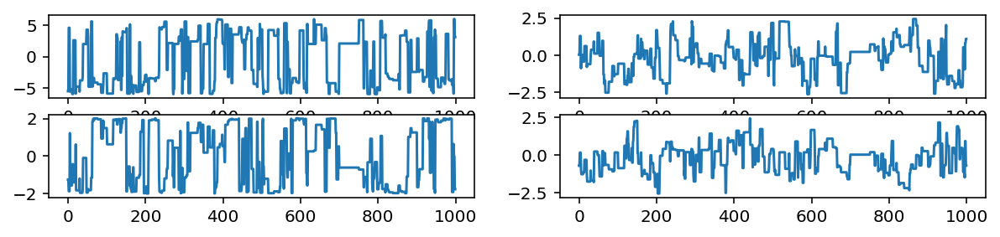

Removed no burn in
422.83169884289
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.08E+01           10.82             462
param2           1.48E+01           14.82             337


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1546  p_{1}
param2        0.2399  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00373
  2      0.07359

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0114   0.0139   0.0214 upper
param1       0.0012   0.0053   0.0036 lower
param2       0.0003   0.0052   0.0039 upper
param2       0.0004   0.0014   0.0009 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1           2

In [27]:
model = Trainer(like.x_dim, flow='spline', learning_rate=0.001)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)